In [1]:
import os, sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from utils.helpers import launch_env, wrap_env, view_results_ipython
from simulation.gym_duckietown.wrappers import SteeringToWheelVelWrapper
import numpy as np

INFO:aido-protocols:aido-protocols 5.0.5
23:18:28|zn|__init__.py:6|<module>(): zn 2.0.3
23:18:29|zj|__init__.py:5|<module>(): zj 2.0.4
23:18:29|gym-duckietown|__init__.py:10|<module>(): gym-duckietown 2019.0.0

23:18:29|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-small_loop_cw-v0
23:18:29|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-straight_road-v0
23:18:29|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-loop_dyn_duckiebots-v0
23:18:29|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-loop_obstacles-v0
23:18:29|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-zigzag_dists-v0
23:18:29|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-udem1-v0
23:18:29|gym-duckietown|__init__.py:24|reg_map_env(): Registering gym environment id: Duckietown-small_loop

# Control

In robotics, control is often considered a discipline in its own right. Simply, control theory allows us to map from sensory data (or, some sort of intermediate representation) to actuation commands - these commands can help drive our Duckiebot, fly our planes, and even land our rockets.

For those coming from a machine learning background (or those with familiarity with reinforcement learning and imitation learning), you may have noticed a difference between the control covered in class and the controllers, or *policies*, that you may normally train. In robotics, an important part of control is feedback; Feedback allows our controller to self-regulate and tune, and is an important part of the control process. 

In this exercise, we will cover two controllers: a simple, PD controller, and a slightly more complicated pure-pursuit controller in Part 2. 


## Part 1: PID

A PID controller, named for its components of **Proportional**, **Integral**, and **Derivative**, is a simple yet robust mechanism. This generality has lead to its widespread use across multiple disciplines, and is what our exercise will start with. More eloquently (from Wikipedia): *A PID controller continuously calculates an error value e(t) as the difference between a desired setpoint (SP) and a measured process variable (PV) and applies a correction based on proportional, integral, and derivative terms (denoted P, I, and D respectively), hence the name.*

*In practical terms it automatically applies accurate and responsive correction to a control function.*

In our exercise, we will only implement the **P**ropotional and (an approximation to the) **D**erivative control corrections.

Before we begin with the practical portion, the **first part of the exercise** consists of the following:

*Explain, qualitatively, the difference between the three terms. For the following types of controllers, explain the error terms involved in the correction, and what types of applications they are commonly used for. If these controllers do not exist (or cannot), explain why.*

1. P
2. PI
3. PD
4. ID
5. PID

Put your answers inside of the zip file, inside of a file named **03-control.txt**.

***

As we continue towards the practical portion of the first exercise, we will be tasked with setting up a controller that keeps the Duckiebot on the road. 

In the kinematics exercise, we saw how to translate linear and angular velocity commands into wheel rate. After understanding the conversion, we still need to answer a more important question: *what* commands should we use to control the Duckiebot?

Since we're using a simulation, we are able to access the ground-truth values of two variables that are crucial to help our Duckiebot stay in the lane: $d$, the distance to the center of the lane, and $\omega$, the angle with respect to the lane. 

In [2]:
try:
    os.mkdir("sw_assignment_3")
except FileExistsError:
    pass
with open("sw_assignment_3/03-control.txt", "w") as f:
    f.write(
"""Fabrice Normandin. SW assignment #3: Control.

Explain, qualitatively, the difference between the three terms.
- The P term is portional to the error. (K_p e(t))
- the I term uses an accumulation (an integration) of the error term over time (int_{0}^{T}{K_i e(t)})
- The D term is proportional to the change of the error over time (its derivative). (d\dt(K_d e(t)))
1. P:
    P controllers apply a correction that is proportional to the error.
    One example of this (found on Wikipedia) is the float valve inside a toilet reservoir.
    When the water level rises, the lever closes the valve and shuts off the input flow.
    Another example (from https://controlguru.com/the-p-only-control-algorithm/) is a very crude cruise-control system.
    As the speed of the car deviates from the reference value, a correction is applied to the gas intake of the engine, proportion to the error.
    The constant K_p regulates the the magnitude of the response compared to the error.
2. PI:
    Here an additional term is added which uses an integration of the error over time.
    The term has the form k_i \int_{0}^{T} e(t) dt (or also K_i / delta_t * \int_{0}^{T} e(t) dt), with delta_t being the integration timestep length.
    The addition of this term allows the elimination of steady-state error (or offset), which was one of the big limitations of the P controller (https://controlguru.com/pi-control-of-the-heat-exchanger/)
    According to (https://controlstation.com/pi-control/), some of the common uses of the PI controller (which is one of the most commonly used controllers) includes:
    liquid flow control, heat exchanger temperature control, and steam pressure control. 
3. PD:
    Proportional-Derivative controllers include a D term which depends on the change of the error over time.
    In order to avoid having "derivative kick" (https://controlguru.com/pid-control-and-derivative-on-measurement/), the derivative term is
    written as the opposite derivate of the present value, rather than the derivative of the error, which might change abruptly when the target value chanes.
    A common example of this type of controller is the suspension of a car, (as described in http://www.matthewpeterkelly.com/tutorials/pdControl/index.html)
    where the spring exerts a force proportial to the deflection (error), and the damper opposes motion, exerting a force proportional to the change in position of the spring (the derivative of the error) 
4. ID:
    This controller doesn't seem to exist. According to https://robotics.stackexchange.com/questions/2925/why-does-a-id-controller-not-exist?fbclid=IwAR3IkeSSbte1cJrAHUHf3vlw-dXdf6yD0y-VcYRiT62rUpp91X2lXwevKzQ,
    The reason for this is that without a term proportional to the error, there would be no way of knowing if the system is currently in its desired state.
5. PID:
    Here we add both a D and an I term to the P-only controller. The I term tends to augment auscillation in the system, while the D term resists change and provides a dampening effect.
    From my understanding, PID controllers are used pretty much everywhere, in a wide variety of applications. According to Wikipedia,
    the first uses of PID controllers were for automatic steering systems for ships in the 1920's.
""")

In your file `notebooks/code/exercise_03_control/controller.py`, complete function `angle_control_commands`. Update `omega` (angular speed) to achieve your goal while keeping `v` constant.

In [3]:
import numpy as np
from notebooks.code.exercise_03_control.controller import Controller

def try_one_setting(k_p_dist, k_d_dist, k_p_angle, k_d_angle) -> float:
    # Setting up the environment
    local_env = launch_env()
    local_env = SteeringToWheelVelWrapper(wrap_env(local_env))
    local_env.reset()
    local_env.robot_speed = 0.5
    total_reward = 0        
    controller = Controller(k_p_dist, k_d_dist, k_p_angle, k_d_angle)

    # Starting to drive
    for _ in range(1000):
        # Getting the pose
        lane_pose = local_env.get_lane_pos2(local_env.cur_pos, local_env.cur_angle)
        dist = lane_pose.dist        # Distance to lane center. Left is negative, right is positive.
        angle = lane_pose.angle_rad  # Angle from straight, in radians. Left is negative, right is positive.

        # Control
        v = 0.5  # For now, keep linear velocity constant                                                
        omega = controller.angle_control_commands(dist, angle)
        commands = np.array([v, omega])

        # Step
        _, r, d, _ = local_env.step(commands)
        total_reward += r

        if d: 
            print("Duckiebot crashed.")
            break


    local_env.close()
    return total_reward, local_env

import contextlib, io
import dataclasses
from dataclasses import dataclass
import logging
from typing import *
import itertools

logger = logging.getLogger("gym-duckietown")
logging.basicConfig(level="ERROR")

@contextlib.contextmanager
def temporarily_disable_logging(logger):
    start_value = logger.disabled
    logger.disabled = True
    try:
        yield
    except UserWarning:
        pass
    logger.disabled = start_value

@dataclass
class PDControllerParameters():
    k_p_dist: float
    k_d_dist: float
    k_p_angle: float
    k_d_angle: float
        
    def around(self, step_size: float) -> Iterable["PDControllerParameters"]:
        def variants(value):
            return [value, value + step_size, value - step_size]
        parameter_variants = map(variants, list(vars(self).values()))
        for values in itertools.product(*parameter_variants):
            yield PDControllerParameters(*values)

import queue
from queue import PriorityQueue
q = PriorityQueue()
            
# best_params = PDControllerParameters(k_p_dist=10, k_d_dist=0, k_p_angle=10, k_d_angle=0)
# best_reward = 276.39
# best_params = PDControllerParameters(k_p_dist=10, k_d_dist=0, k_p_angle=15.898240000000003, k_d_angle=-33.616)
# best_reward = -1321.7744797146122
# best_params = PDControllerParameters(k_p_dist=10, k_d_dist=10.0, k_p_angle=20.0, k_d_angle=-10.0)
best_params = PDControllerParameters(k_p_dist=10, k_d_dist=-5.0, k_p_angle=20.0, k_d_angle=-5.0)
best_reward = 251.9646409240351
q.put((best_reward, best_params))

print("Current best setting", best_reward, best_params)

step = 0
max_steps = 10
step_size = 10.0
while step < max_steps:
    
    # add or remove to skip the search.
    break
    
    best_reward, best_params = q.get()
    step += 1
    print("Best reward:", best_reward, "best_param:", best_paras)
    for params in best_params.around(step_size):
        with temporarily_disable_logging(logger):
            total_reward, env = try_one_setting(**dataclasses.asdict(params))
        print("\t", params, "\t", total_reward)
        q.put((abs(total_reward), params))
#         if total_reward < best_reward:
#             print("New best setting found")
#             best_reward = total_reward
#             best_params = params
#             local_env = env
#             break
    step_size *= 0.8

with temporarily_disable_logging(logger):
    total_reward, local_env = try_one_setting(**dataclasses.asdict(best_params))
    best_reward = total_reward
print("BEST PARAMETERS FOUND:", best_params, "REWARD:", total_reward)
view_results_ipython(local_env)

Current best setting 251.9646409240351 PDControllerParameters(k_p_dist=10, k_d_dist=-5.0, k_p_angle=20.0, k_d_angle=-5.0)


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Trying to monitor an environment which has no 'spec' set. This usually means you did not create it via 'gym.make', and is recommended only for advanced users.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


BEST PARAMETERS FOUND: PDControllerParameters(k_p_dist=10, k_d_dist=-5.0, k_p_angle=20.0, k_d_angle=-5.0) REWARD: 247.2487620756103


In [13]:
from notebooks.code.exercise_03_control.controller import Controller

# Setting up the environment
local_env = launch_env()
local_env = SteeringToWheelVelWrapper(wrap_env(local_env))
local_env.reset()
local_env.robot_speed = 0.5
total_reward = 0        
controller = Controller()
    
# Starting to drive
for _ in range(1000):
    # Getting the pose
    lane_pose = local_env.get_lane_pos2(local_env.cur_pos, local_env.cur_angle)
    dist = lane_pose.dist        # Distance to lane center. Left is negative, right is positive.
    angle = lane_pose.angle_rad  # Angle from straight, in radians. Left is negative, right is positive.
    
    # Control
    v = 0.5  # For now, keep linear velocity constant                                                
    omega = controller.angle_control_commands(dist, angle)
    commands = np.array([v, omega])
    
    # Step
    _, r, d, _ = local_env.step(commands)
    total_reward += r
    
    if d: 
        print("Duckiebot crashed.")
        break
        
        
local_env.close()

23:29:16|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
23:29:16|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
23:29:16|gym-duckietown|simulator.py:535|_load_map(): loading map file "/duckietown/simulation/gym_duckietown/maps/loop_empty.yaml"
23:29:16|gym-duckietown|simulator.py:1092|_drivable_pos(): [4.13719561 0.         1.88880899] corresponds to tile at (7, 3) which is not drivable: {'coords': (7, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7fc430073cf8>, 'color': array([1, 1, 1])}
23:29:16|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
23:29:16|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
23:29:16|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [4.0873995 0.        1.9726338]
23:29:16|gym-duckietown|simulator.py:12

23:29:16|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
23:29:16|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
23:29:16|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [3.57292165 0.         1.88314807]
23:29:16|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.48172154 0.         1.84866924]
23:29:16|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [3.66412176 0.         1.91762689]
23:29:16|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.61429624 0.         1.77370793]
23:29:16|gym-duckietown|simulator.py:1092|_drivable_pos(): [3.50690495 0.         2.23654429] corresponds to tile at (5, 3) which is not drivable: {'coords': (5, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7fc430073cf8>, 'color': array([1, 1, 1])}
23:29:16|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True

23:29:16|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.50609039 0.         2.05544313]
23:29:16|gym-duckietown|simulator.py:1092|_drivable_pos(): [4.12972415 0.         2.27350789] corresponds to tile at (7, 3) which is not drivable: {'coords': (7, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7fc430073cf8>, 'color': array([1, 1, 1])}
23:29:16|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
23:29:16|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
23:29:16|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [4.022444   0.         2.32019802]
23:29:16|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.98353555 0.         2.23079789]
23:29:16|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [4.06135244 0.         2.40959815]
23:29:16|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [4.12972415 0.         2.27

23:29:20|gym-duckietown|simulator.py:1092|_drivable_pos(): [2.28873639 0.         2.68406941] corresponds to tile at (3, 4) which is not drivable: {'coords': (3, 4), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7fc430073cf8>, 'color': array([1, 1, 1])}
23:29:20|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
23:29:20|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
23:29:20|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [2.38071712 0.         2.71640816]
23:29:20|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [2.28873639 0.         2.68406941]
23:29:20|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [2.47269785 0.         2.74874692]
23:29:20|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [2.41952363 0.         2.60603129]
23:29:20|gym-duckietown|simulator.py:516|reset(): Starting at [2.64153703 0.         2.8846

23:29:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32278319 0.         3.24351799] angle 3.0759621600422618
23:29:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32278319 0.         3.24351799] angle 3.0759621600422618
23:29:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.29957218 0.         3.24157169] angle 3.039909283626364
23:29:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.29957218 0.         3.24157169] angle 3.039909283626364
23:29:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27642176 0.         3.2389947 ] angle 3.021559263554429
23:29:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27642176 0.         3.2389947 ] angle 3.021559263554429
23:29:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.25330791 0.         3.23610597] angle 3.0129586045526193
23:29:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.25330791 0.         3.23610597] angle 3.0129586045526193
23:29:21|gym-duckietown|simu

23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67434428 0.         3.1742804 ] angle 3.063761287600776
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67434428 0.         3.1742804 ] angle 3.063761287600776
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.65111937 0.         3.17249116] angle 3.065648531879629
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.65111937 0.         3.17249116] angle 3.065648531879629
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62789116 0.         3.17074522] angle 3.0674901176337026
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62789116 0.         3.17074522] angle 3.0674901176337026
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60465982 0.         3.16904155] angle 3.0692871418017305
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60465982 0.         3.16904155] angle 3.0692871418017305
23:29:22|gym-duckietown|simu

23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02596712 0.         3.11968056] angle 2.734260913437297
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02596712 0.         3.11968056] angle 2.734260913437297
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00513497 0.         3.10928526] angle 2.6232259464159178
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00513497 0.         3.10928526] angle 2.6232259464159178
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98563118 0.         3.09657438] angle 2.5048014650532218
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98563118 0.         3.09657438] angle 2.5048014650532218
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96780465 0.         3.08160363] angle 2.3812965441772467
23:29:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96780465 0.         3.08160363] angle 2.3812965441772467
23:29:22|gym-duckietown|si

23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.92993443 0.         2.51790895] angle 1.5026895579972819
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.92993443 0.         2.51790895] angle 1.5026895579972819
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.93150049 0.         2.49466793] angle 1.5043393120448005
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.93150049 0.         2.49466793] angle 1.5043393120448005
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.93302867 0.         2.47142438] angle 1.5059500770787868
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.93302867 0.         2.47142438] angle 1.5059500770787868
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.93451984 0.         2.44817842] angle 1.5075223646530977
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.93451984 0.         2.44817842] angle 1.5075223646530977
23:29:23|gym-duckietown|

23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96204424 0.         1.86650626] angle 1.5365567996823164
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96204424 0.         1.86650626] angle 1.5365567996823164
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96283198 0.         1.84322585] angle 1.5373878114752313
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96283198 0.         1.84322585] angle 1.5373878114752313
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9636006 0.        1.8199448] angle 1.5381986628736206
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9636006 0.        1.8199448] angle 1.5381986628736206
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96435058 0.         1.79666315] angle 1.5389898423509596
23:29:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96435058 0.         1.79666315] angle 1.5389898423509596
23:29:23|gym-duckietown|simula

23:29:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97818897 0.         1.21448938] angle 1.5535886825527478
23:29:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97818897 0.         1.21448938] angle 1.5535886825527478
23:29:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97858491 0.         1.19119901] angle 1.5540063912920674
23:29:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97858491 0.         1.19119901] angle 1.5540063912920674
23:29:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97897125 0.         1.16790848] angle 1.554413961423341
23:29:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97897125 0.         1.16790848] angle 1.554413961423341
23:29:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97938022 0.         1.14461835] angle 1.5520630538435078
23:29:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97938022 0.         1.14461835] angle 1.5520630538435078
23:29:24|gym-duckietown|si

23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.42045546 0.         0.93134934] angle -0.06633906587286299
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.42045546 0.         0.93134934] angle -0.06633906587286299
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.4436991  0.         0.93287623] angle -0.06485366736706712
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.4436991  0.         0.93287623] angle -0.06485366736706712
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.46694499 0.         0.93436837] angle -0.06334893966754963
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.46694499 0.         0.93436837] angle -0.06334893966754963
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.4901931  0.         0.93582559] angle -0.0618500780184065
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.4901931  0.         0.93582559] angle -0.0618500780184065
23:29:25|g

23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.0486139 0.        0.9619603] angle -0.034328081815764536
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.07189424 0.         0.96275007] angle -0.03349492173291595
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.07189424 0.         0.96275007] angle -0.03349492173291595
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.09517522 0.         0.96352068] angle -0.03268197408736989
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.09517522 0.         0.96352068] angle -0.03268197408736989
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.11845682 0.         0.9642726 ] angle -0.031888749152332536
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.11845682 0.         0.9642726 ] angle -0.031888749152332536
23:29:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14173899 0.         0.96500627] angle -0.031114769021096677
23:29:2

23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.7006297  0.         0.97814677] angle -0.017252156659886102
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.7006297  0.         0.97814677] angle -0.017252156659886102
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.72392005 0.         0.97854374] angle -0.016833367522017258
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.72392005 0.         0.97854374] angle -0.016833367522017258
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.74721056 0.         0.97893108] angle -0.01642474320686068
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.74721056 0.         0.97893108] angle -0.01642474320686068
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.77050123 0.         0.97930901] angle -0.016026037073703574
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.77050123 0.         0.97930901] angle -0.016026037073703574
23

23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.32950869 0.         0.9860775 ] angle -0.008885497480784684
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.35280153 0.         0.98628197] angle -0.008669796603743533
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.35280153 0.         0.98628197] angle -0.008669796603743533
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.37609441 0.         0.98648146] angle -0.008459331844924723
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.37609441 0.         0.98648146] angle -0.008459331844924723
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.39938733 0.         0.98667612] angle -0.00825397610887706
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.39938733 0.         0.98667612] angle -0.00825397610887706
23:29:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.42268029 0.         0.98686605] angle -0.008053605384357294
23

23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.75128587 0.         1.29683472] angle -1.6335651285048338
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.74980837 0.         1.32008154] angle -1.634970702036656
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.74980837 0.         1.32008154] angle -1.634970702036656
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.74831381 0.         1.34332728] angle -1.6350331257014452
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.74831381 0.         1.34332728] angle -1.6350331257014452
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.74682623 0.         1.36657347] angle -1.6343701898581715
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.74682623 0.         1.36657347] angle -1.6343701898581715
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.74535852 0.         1.38982092] angle -1.6333230728327994
23:29:27|gym-ducki

23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71871008 0.         1.94821701] angle -1.6058316120634004
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71790404 0.         1.9714968 ] angle -1.6049812959301275
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71790404 0.         1.9714968 ] angle -1.6049812959301275
23:29:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71711756 0.         1.99477725] angle -1.6041516077978164
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71711756 0.         1.99477725] angle -1.6041516077978164
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71635016 0.         2.01805834] angle -1.6033420479448934
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71635016 0.         2.01805834] angle -1.6033420479448934
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71560138 0.         2.04134003] angle -1.6025521286931883
23:29:28|gym-duc

23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.60964563 0.         2.56630392] angle -2.6278792678814815
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5887422  0.         2.57655281] angle -2.743596366298402
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5887422  0.         2.57655281] angle -2.743596366298402
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.56683246 0.         2.5844304 ] angle -2.8492787754148097
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.56683246 0.         2.5844304 ] angle -2.8492787754148097
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.54423934 0.         2.59006361] angle -2.945204789708639
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.54423934 0.         2.59006361] angle -2.945204789708639
23:29:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.52122545 0.         2.59361617] angle -3.0316669977323594
23:29:28|gym-duckiet

23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.96325531 0.         2.56370642] angle -3.1924476013902603
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.93999096 0.         2.56253668] angle -3.1912137209542126
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.93999096 0.         2.56253668] angle -3.1912137209542126
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.91672521 0.         2.56139531] angle -3.1900097226112543
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.91672521 0.         2.56139531] angle -3.1900097226112543
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.89344675 0.         2.56057022] angle -3.1640338361112685
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.89344675 0.         2.56057022] angle -3.1640338361112685
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.8701565  0.         2.56070497] angle -3.1075805346809733
23:29:29|gym-duc

23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47221816 0.         2.88274177] angle -1.6280583614720157
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47173629 0.         2.90602532] angle -1.5549200327214814
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47173629 0.         2.90602532] angle -1.5549200327214814
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47290748 0.         2.92928499] angle -1.4860519063626927
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47290748 0.         2.92928499] angle -1.4860519063626927
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47457593 0.         2.95251823] angle -1.51216074593765
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47457593 0.         2.95251823] angle -1.51216074593765
23:29:29|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47526601 0.         2.97579847] angle -1.570165076580108
23:29:29|gym-duckieto

23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.0126235  0.         3.13047925] angle -3.1731732914003627
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.98934111 0.         3.12975243] angle -3.1724272474775663
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.98934111 0.         3.12975243] angle -3.1724272474775663
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.96605819 0.         3.12904287] angle -3.171690157679452
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.96605819 0.         3.12904287] angle -3.171690157679452
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.94277475 0.         3.12835033] angle -3.1709658941341434
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.94277475 0.         3.12835033] angle -3.1709658941341434
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.91949083 0.         3.12767447] angle -3.170256407097356
23:29:30|gym-duckie

23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.36057611 0.         3.11556725] angle -3.1574881488952977
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.33728524 0.         3.11520149] angle -3.1571022888498064
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.33728524 0.         3.11520149] angle -3.1571022888498064
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.31399424 0.         3.11484461] angle -3.156725794609298
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.31399424 0.         3.11484461] angle -3.156725794609298
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.29070311 0.         3.1144964 ] angle -3.156358438904053
23:29:30|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.29070311 0.         3.1144964 ] angle -3.156358438904053
23:29:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.26741186 0.         3.11415663] angle -3.1559999999747474
23:29:31|gym-duckiet

23:29:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.92380949 0.         2.81603308] angle -4.776659309154662
23:29:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.92534032 0.         2.79278971] angle -4.779650309817253
23:29:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.92534032 0.         2.79278971] angle -4.779650309817253
23:29:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.92691618 0.         2.76954934] angle -4.780534705422824
23:29:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.92691618 0.         2.76954934] angle -4.780534705422824
23:29:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.92849928 0.         2.74630946] angle -4.780272928671169
23:29:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.92849928 0.         2.74630946] angle -4.780272928671169
23:29:31|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.93006914 0.         2.72306869] angle -4.779395581677952
23:29:31|gym-duckietown|

23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95874483 0.         2.16477573] angle -4.750109148198194
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95961261 0.         2.14149816] angle -4.749193703474729
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95961261 0.         2.14149816] angle -4.749193703474729
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96045934 0.         2.11821982] angle -4.748300464254052
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96045934 0.         2.11821982] angle -4.748300464254052
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96128553 0.         2.09494075] angle -4.7474288927888715
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96128553 0.         2.09494075] angle -4.7474288927888715
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96209168 0.         2.07166097] angle -4.746578464271681
23:29:32|gym-duckietow

23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97653051 0.         1.51280322] angle -4.731346230668176
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97696671 0.         1.48951357] angle -4.730886056499738
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97696671 0.         1.48951357] angle -4.730886056499738
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97739233 0.         1.46622372] angle -4.730437051262973
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97739233 0.         1.46622372] angle -4.730437051262973
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97780761 0.         1.44293369] angle -4.729998943980749
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97780761 0.         1.44293369] angle -4.729998943980749
23:29:32|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97821281 0.         1.41964348] angle -4.7295714702428295
23:29:32|gym-duckietown

23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.12818679 0.         0.92911595] angle -6.037863415128719
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.15101182 0.         0.92450824] angle -6.130119386384383
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.15101182 0.         0.92450824] angle -6.130119386384383
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.17415322 0.         0.92190664] angle -6.212347189304628
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.17415322 0.         0.92190664] angle -6.212347189304628
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.19742631 0.         0.92103517] angle -6.279168285261885
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.19742631 0.         0.92103517] angle -6.279168285261885
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.22071648 0.         0.92136199] angle -6.315265116703086
23:29:33|gym-duckietown|

23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.77885916 0.         0.95288018] angle -6.3270921679507275
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.80213099 0.         0.95389021] angle -6.326026691856402
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.80213099 0.         0.95389021] angle -6.326026691856402
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.82540386 0.         0.95487575] angle -6.324987047409839
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.82540386 0.         0.95487575] angle -6.324987047409839
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.84867774 0.         0.95583738] angle -6.3239726121574105
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.84867774 0.         0.95583738] angle -6.3239726121574105
23:29:33|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.87195256 0.         0.95677568] angle -6.322982777428994
23:29:33|gym-duckieto

23:29:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.43074221 0.         0.97358241] angle -6.3052526817927586
23:29:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.45403041 0.         0.97409017] angle -6.3047170245618425
23:29:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.45403041 0.         0.97409017] angle -6.3047170245618425
23:29:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47731887 0.         0.9745856 ] angle -6.304194367391234
23:29:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47731887 0.         0.9745856 ] angle -6.304194367391234
23:29:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.50060759 0.         0.975069  ] angle -6.303684394943488
23:29:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.50060759 0.         0.975069  ] angle -6.303684394943488
23:29:34|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.52389655 0.         0.97554067] angle -6.303186799518392
23:29:34|gym-duckieto

23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.0828805  0.         0.98398809] angle -6.294275070445776
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.10617283 0.         0.98424327] angle -6.2940058619357355
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.10617283 0.         0.98424327] angle -6.2940058619357355
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.12946524 0.         0.98449226] angle -6.2937431882756325
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.12946524 0.         0.98449226] angle -6.2937431882756325
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.1527577 0.        0.9847352] angle -6.293486890857561
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.1527577 0.        0.9847352] angle -6.293486890857561
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.17605023 0.         0.98497225] angle -6.29323681492169
23:29:35|gym-duckietown|sim

23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71407739 0.         1.05868839] angle -7.197839933672297
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72700392 0.         1.07804512] angle -7.3325425277757414
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72700392 0.         1.07804512] angle -7.3325425277757414
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73740055 0.         1.09887513] angle -7.449537142974187
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73740055 0.         1.09887513] angle -7.449537142974187
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.74532512 0.         1.12076599] angle -7.563769580280326
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.74532512 0.         1.12076599] angle -7.563769580280326
23:29:35|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.75089505 0.         1.14337452] angle -7.661086810929708
23:29:35|gym-duckietow

23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72902013 0.         1.70133927] angle -7.899892949773955
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72796402 0.         1.72460905] angle -7.898778955253176
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72796402 0.         1.72460905] angle -7.898778955253176
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72693352 0.         1.74787997] angle -7.897691928029445
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72693352 0.         1.74787997] angle -7.897691928029445
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72592801 0.         1.77115199] angle -7.896631235435487
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72592801 0.         1.77115199] angle -7.896631235435487
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72494688 0.         1.79442505] angle -7.895596251183457
23:29:36|gym-duckietown|

23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70737292 0.         2.35319041] angle -7.877056846598735
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70663175 0.         2.37647206] angle -7.894554698777775
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70663175 0.         2.37647206] angle -7.894554698777775
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70515885 0.         2.39971717] angle -7.9399673294897966
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70515885 0.         2.39971717] angle -7.9399673294897966
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70239687 0.         2.42284235] angle -8.005742137297323
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70239687 0.         2.42284235] angle -8.005742137297323
23:29:36|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69780075 0.         2.44566943] angle -8.099598040218856
23:29:36|gym-duckietow

23:29:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.20952333 0.         2.57793232] angle -9.490563302919853
23:29:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.1862788  0.         2.57641919] angle -9.48900121542704
23:29:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.1862788  0.         2.57641919] angle -9.48900121542704
23:29:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.16303194 0.         2.57494212] angle -9.48746193761118
23:29:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.16303194 0.         2.57494212] angle -9.48746193761118
23:29:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.13978287 0.         2.57350048] angle -9.485951636264648
23:29:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.13978287 0.         2.57350048] angle -9.485951636264648
23:29:37|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.11653166 0.         2.57209359] angle -9.484473326429542
23:29:37|gym-duckietown|simu

23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.58318819 0.         2.67049726] angle -8.72928467485511
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.58318819 0.         2.67049726] angle -8.72928467485511
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.56581975 0.         2.68601277] angle -8.66205012890576
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.56581975 0.         2.68601277] angle -8.66205012890576
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.54953744 0.         2.7026644 ] angle -8.594282871125763
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.54953744 0.         2.7026644 ] angle -8.594282871125763
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53447922 0.         2.72042948] angle -8.519914093649449
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53447922 0.         2.72042948] angle -8.519914093649449
23:29:38|gym-duckietown|simu

23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2592014  0.         3.13891702] angle -9.43960822814551
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2592014  0.         3.13891702] angle -9.43960822814551
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2359126  0.         3.13844362] angle -9.450596699803592
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2359126  0.         3.13844362] angle -9.450596699803592
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21262845 0.         3.13777651] angle -9.456245376328514
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21262845 0.         3.13777651] angle -9.456245376328514
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.18934727 0.         3.13701213] angle -9.458951686846966
23:29:38|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.18934727 0.         3.13701213] angle -9.458951686846966
23:29:38|gym-duckietown|si

23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60724853 0.         3.12035319] angle -9.445722440400752
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60724853 0.         3.12035319] angle -9.445722440400752
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58395978 0.         3.11987127] angle -9.445214036023021
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58395978 0.         3.11987127] angle -9.445214036023021
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.5606708  0.         3.11940105] angle -9.444717970312773
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.5606708  0.         3.11940105] angle -9.444717970312773
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53738158 0.         3.11894224] angle -9.444233944093659
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53738158 0.         3.11894224] angle -9.444233944093659
23:29:39|gym-duckietown|

23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97162054 0.         3.05078157] angle -10.260486345793865
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97162054 0.         3.05078157] angle -10.260486345793865
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95722238 0.         3.03249356] angle -10.396763501298643
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95722238 0.         3.03249356] angle -10.396763501298643
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9453445  0.         3.01247384] angle -10.523414833884864
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9453445  0.         3.01247384] angle -10.523414833884864
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.93598486 0.         2.99115769] angle -10.64025114520665
23:29:39|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.93598486 0.         2.99115769] angle -10.64025114520665
23:29:39|gym-ducki

23:29:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9482698  0.         2.41139117] angle -11.044344349156374
23:29:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9482698  0.         2.41139117] angle -11.044344349156374
23:29:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94939162 0.         2.38812447] angle -11.043161093116046
23:29:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94939162 0.         2.38812447] angle -11.043161093116046
23:29:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95048624 0.         2.36485647] angle -11.042006457898456
23:29:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95048624 0.         2.36485647] angle -11.042006457898456
23:29:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95155432 0.         2.34158724] angle -11.04087978077168
23:29:40|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95155432 0.         2.34158724] angle -11.04087978077168
23:29:40|gym-ducki

23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97126459 0.         1.75958798] angle -11.02008685892424
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97126459 0.         1.75958798] angle -11.02008685892424
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9718286  0.         1.73630107] angle -11.01949186062591
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9718286  0.         1.73630107] angle -11.01949186062591
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97237891 0.         1.71301384] angle -11.018911301637658
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97237891 0.         1.71301384] angle -11.018911301637658
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97291587 0.         1.6897263 ] angle -11.018344831776096
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97291587 0.         1.6897263 ] angle -11.018344831776096
23:29:41|gym-duckiet

23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98416112 0.         1.10751591] angle -11.078717523582592
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98416112 0.         1.10751591] angle -11.078717523582592
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98694555 0.         1.08439446] angle -11.152129263870638
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98694555 0.         1.08439446] angle -11.152129263870638
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99165032 0.         1.06158951] angle -11.245919697599716
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99165032 0.         1.06158951] angle -11.245919697599716
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99866601 0.         1.03939005] angle -11.357423829980736
23:29:41|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99866601 0.         1.03939005] angle -11.357423829980736
23:29:41|gym-duc

You can see how well you are doing:

In [14]:
print("Your score: {}".format(total_reward))
print(controller.k_p_dist, controller.k_d_dist, controller.k_p_angle, controller.k_d_angle)
view_results_ipython(local_env)

Your score: 276.39341399563864
10.0 0.0 10.0 0


Within **03-control.txt**, answer the following question:

*Describe the method you used. What kind of controller is it?*

Then, from the list of popular variants of PID controllers, implement a second one. Answer the above question again, and then discuss the differences (both in terms of algorithm and performance) between the two. Do you see any qualitative differences in the driving? Why or why not? Put your answers in **03-control.txt**.

Lastly, for both implementation, plot the **cross-track** error and the **angle error**, and submit the plot(s) (depending on if you decide to separate the metrics on two plots) in the zip file. 

In [6]:
with open("sw_assignment_3/03-control.txt", "a") as f:
    f.write(
"""
- Describe the method you used. What kind of controller is it?
    I first implemented a simple PD controller, with the following parameters:
        k_p_dist:  constant of the P term w.r.t the dist input
        k_p_angle: constant of the P term w.r.t the angle input
        k_d_dist:  const of the D term w.r.t. the dist input
        k_d_angle: constant of the D term w.r.t. the angle input
    
    Then, I set the derivative parameters `k_d_dist` and `k_d_dist` to zero, effectively converting this model to a P controller.
    
    The values of `k_p_dist` and `k_p_angle` were both set to 10.
    This controller performed pretty well, being able to stay in lane without any significant oscillation. The total_reward was equal to 276.39 with these parameters.

- (Again) Describe the method you used. What kind of controller is it?
    This time, by allowing non-zero values for `k_d_dist` and `k_d_angle`, the above system became a PD controller, rather than a P controller.
    In order to automate this search process, I implemented a simple A* search, which varies the values of each of the four parameters and return the best combination found after a given number of explorations.
    Interestingly, while searching, the reward signal became very negative! For instance:
    
    When using the following parameters: (k_p_dist=10, k_d_dist=0, k_p_angle=15.898240000000003, k_d_angle=-33.616)
    the total reward would be equal to -1321.7744797146122!!!
    After closer inspection, the robot seemed to be jerking constantly on the line, which seems to have provided a negative error value.
    
    Thereafter, I decieded to use the absolute value of the total_reward as the priority index of the A* search algorithm.
    This would therefore search for parameter combinations which give results close to zero.
    
- Discuss the differences (both in terms of algorithm and performance) between the two.
    The PD controller uses an additional term based on the derivative of the error signal (therefore equivalent to the negative derivative of the current value of the input).
    The performance of the PD controller, assuming it is well tuned, performs better than the P controller, 
    because it is able to correct the offset that arises in the P-only controller.
     
- Do you see any qualitative differences in the driving? Why or why not?
    There seems to be a slight difference in terms of driving of the PD and P controllers,
    in that the PD controller is able to respond to sudden turns more smoothly.
    This is consistent with the theory of PD controllers, where the D term is able
    to prevent the overshoot and potential oscillations that can typically occur in P-only controllers.
""")

## Part 2: Pure Pursuit

Within **03-control.txt**, answer the following question:

*While robust, general, and simple, PID controllers also have limitations. What are some failure cases of PID controllers?*
 
In this section, we'll be looking into a type of controller known as a *Pure Pursuit* (PP) controller. A PP controller is not explicitly a reactive controller, but actually requires a reference trajectory that the controller follows. When we input the pose, velocity, and current waypoint, the controller outputs control commands that are used to steer the robot.

Besides robot-specific parameters (which need to be set only once), a PP controller has a single, tunable parameter: *look-ahead* distance. The look-ahead distance is how far along the current path (more on how we do this next section) the robot should _look ahead_ from to compute the angular velocity commands. For simplicity, in our example, the velocity will be fixed.

Before we move on to the code, write the answer to the following in **03-control.txt**:

*Recall the lecture notes about PP controllers. How does the look-ahead distance affect performance? What does a small look-ahead distance prioritize? What about a larger one?*

In [7]:
with open("sw_assignment_3/03-control.txt", "a") as f:
    f.write(
"""
- While robust, general, and simple, PID controllers also have limitations. What are some failure cases of PID controllers?
    PID controllers can be very difficult to tune properly, given the larger number of parameters compared to P or PD controllers.
    Furthermore, the PID controller has only access to the current value of the error, making it unable to take preventive measures
    to guarantee its stability.

- Recall the lecture notes about PP controllers. How does the look-ahead distance affect performance?
    The look-ahead distance affects the curvature of the robot's instantaneous trajectory.
    
- What does a small look-ahead distance prioritize? What about a larger one?
    A small look-ahead distance prioritizes following the local (fine-grain) structure of the trajectory.
    A large look-ahead distance prioritizes following the global, large-scale trajectory, while perhaps cutting corners.

""")

*** 

As we start the last practical portion of the exercise, we recall a requirement of the PP controller: a reference trajectory. How can we get this from the simulator?

The answer lies inside of the `simulator.py` code, available [here](https://github.com/duckietown/gym-duckietown/blob/master/gym_duckietown/simulator.py). In `gym-duckietown`, we load every tile with a *Bezier* curve, which allows us to calculate a *reward* (useful in reinforcement learning, which we will see later). Each Bezier curve was designed to perfectly fit the right lane of each tile.

`gym-duckietown` provides a few helper functions that we will make use of. Inside of `controller.py:Controller:pure_pursuit`, you will notice a call to `closest_curve_point`, which returns the closest point on the reference trajectory. 

While we have a boilerplate function written, it still needs work. In particular, the main things that need your attention are:

- `follow_point` needs to be a function of a few more items, not just the closest point.
- Once you have the correct waypoint, you need to calculate the $\omega$ that gets you there. You can also change $v$ to go as fast as possible.


In [8]:
%reload_ext autoreload


In [9]:
%autoreload 2

In [38]:

# Reset environment
local_env = launch_env()
local_env = SteeringToWheelVelWrapper(wrap_env(local_env))
local_env.reset()
local_env.robot_speed = 0.5
controller = Controller()
total_reward = 0             
    
# Starting to drive
for _ in range(1000):
   
    # Getting the global pose
    pos = local_env.cur_pos
    angle = local_env.cur_angle
    
    # Control
    v, omega = controller.pure_pursuit(local_env, pos, angle)
    commands = np.array([v, omega])
    
    # Step
    _, r, d, _ = local_env.step(commands)
    total_reward += r
    
    if d: 
        print("Duckiebot crashed.")
        break
        
local_env.close()

00:23:57|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
00:23:57|gym-duckietown|graphics.py:125|create_frame_buffers(): Falling back to non-multisampled frame buffer
00:23:57|gym-duckietown|simulator.py:535|_load_map(): loading map file "/duckietown/simulation/gym_duckietown/maps/loop_empty.yaml"
00:23:57|gym-duckietown|simulator.py:1092|_drivable_pos(): [4.13719561 0.         1.88880899] corresponds to tile at (7, 3) which is not drivable: {'coords': (7, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7fc430073cf8>, 'color': array([1, 1, 1])}
00:23:57|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:23:57|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:23:57|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [4.0873995 0.        1.9726338]
00:23:57|gym-duckietown|simulator.py:12

00:23:57|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:23:57|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:23:57|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [3.57292165 0.         1.88314807]
00:23:57|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.48172154 0.         1.84866924]
00:23:57|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [3.66412176 0.         1.91762689]
00:23:57|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.61429624 0.         1.77370793]
00:23:57|gym-duckietown|simulator.py:1092|_drivable_pos(): [3.50690495 0.         2.23654429] corresponds to tile at (5, 3) which is not drivable: {'coords': (5, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7fc430073cf8>, 'color': array([1, 1, 1])}
00:23:57|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True

00:23:57|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [3.50609039 0.         2.05544313]
00:23:57|gym-duckietown|simulator.py:1092|_drivable_pos(): [4.12972415 0.         2.27350789] corresponds to tile at (7, 3) which is not drivable: {'coords': (7, 3), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7fc430073cf8>, 'color': array([1, 1, 1])}
00:23:57|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:23:57|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:23:57|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [4.022444   0.         2.32019802]
00:23:57|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [3.98353555 0.         2.23079789]
00:23:57|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [4.06135244 0.         2.40959815]
00:23:57|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [4.12972415 0.         2.27

00:24:01|gym-duckietown|simulator.py:1092|_drivable_pos(): [2.28873639 0.         2.68406941] corresponds to tile at (3, 4) which is not drivable: {'coords': (3, 4), 'kind': 'floor', 'angle': 0, 'drivable': False, 'texture': <simulation.gym_duckietown.graphics.Texture object at 0x7fc430073cf8>, 'color': array([1, 1, 1])}
00:24:01|gym-duckietown|simulator.py:1202|_valid_pose(): Invalid pose. Collision free: True On drivable area: False
00:24:01|gym-duckietown|simulator.py:1203|_valid_pose(): safety_factor: 1.3
00:24:01|gym-duckietown|simulator.py:1204|_valid_pose(): pos: [2.38071712 0.         2.71640816]
00:24:01|gym-duckietown|simulator.py:1205|_valid_pose(): l_pos: [2.28873639 0.         2.68406941]
00:24:01|gym-duckietown|simulator.py:1206|_valid_pose(): r_pos: [2.47269785 0.         2.74874692]
00:24:01|gym-duckietown|simulator.py:1207|_valid_pose(): f_pos: [2.41952363 0.         2.60603129]
00:24:01|gym-duckietown|simulator.py:516|reset(): Starting at [2.64153703 0.         2.8846

curve point: [2.46633277 0.         3.06161597] pos: [2.64153703 0.         2.88468928]
v 0.5
omega -3.1436421353175774
alpha: -0.9041672971683301
curve point: [2.4670558  0.         3.06096791] pos: [2.64271026 0.         2.90793261]
v 0.5
omega -2.9552651590479617
alpha: -0.831312173652484
curve point: [2.44822469 0.         3.07504305] pos: [2.64058046 0.         2.9311103 ]
v 0.5
omega -2.7786067433981656
alpha: -0.7679355782185144
curve point: [2.43856276 0.         3.08046315] pos: [2.63538265 0.         2.95380003]
v 0.5
omega -2.60445065548932
alpha: -0.7090495133798509
curve point: [2.42921683 0.         3.08482816] pos: [2.62738733 0.         2.97566341]
v 0.5
omega -2.439921545489041
alpha: -0.656035839024498
curve point: [2.41831771 0.         3.08901106] pos: [2.61688326 0.         2.99644029]
v 0.5
omega -2.290255104560467
alpha: -0.6096295426196185
curve point: [2.40677052 0.         3.09254592] pos: [2.60415743 0.         3.01593738]
v 0.5
omega -2.155013320807405
alpha

00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.5731161  0.         3.05057742] angle 3.8854025011866975
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.55528696 0.         3.06555581] angle 3.7952276082074645
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.55528696 0.         3.06555581] angle 3.7952276082074645
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53620835 0.         3.07890759] angle 3.709181610847639
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53620835 0.         3.07890759] angle 3.709181610847639
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.51607235 0.         3.09060506] angle 3.626552780120122
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.51607235 0.         3.09060506] angle 3.626552780120122
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.49505719 0.         3.10063895] angle 3.5475387852240043
00:24:02|gym-duckietown|simu

curve point: [2.37690103 0.         3.09832486] pos: [2.5731161  0.         3.05057742]
v 0.5
omega -1.935604077799231
alpha: -0.5051069294119781
curve point: [2.35931783 0.         3.09993697] pos: [2.55528696 0.         3.06555581]
v 0.5
omega -1.8469773333286452
alpha: -0.4799607192192674
curve point: [2.33741419 0.         3.1005    ] pos: [2.53620835 0.         3.07890759]
v 0.5
omega -1.773627851566153
alpha: -0.4593961702307494
curve point: [2.30611255 0.         3.1005    ] pos: [2.51607235 0.         3.09060506]
v 0.5
omega -1.696035400445171
alpha: -0.4378672073909211
curve point: [2.27361902 0.         3.1005    ] pos: [2.49505719 0.         3.10063895]
v 0.5
omega -1.5818583801705326
alpha: -0.4065736256667547
curve point: [2.24087422 0.         3.1005    ] pos: [2.47333714 0.         3.10904085]
v 0.5
omega -1.4426403757316415
alpha: -0.3689755224534128
curve point: [2.20863838 0.         3.1005    ] pos: [2.45107868 0.         3.11589321]
v 0.5
omega -1.2903053139671274
a

00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.42842853 0.         3.12131587] angle 3.3465229888173287
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.40550726 0.         3.12544944] angle 3.293502570810059
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.40550726 0.         3.12544944] angle 3.293502570810059
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.38240835 0.         3.12843965] angle 3.247156229440025
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.38240835 0.         3.12843965] angle 3.247156229440025
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.35920143 0.         3.13043088] angle 3.2072162971200315
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.35920143 0.         3.13043088] angle 3.2072162971200315
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.3359363  0.         3.13156175] angle 3.173108336962381
00:24:02|gym-duckietown|simul

curve point: [2.17994423 0.         3.1005    ] pos: [2.42842853 0.         3.12131587]
v 0.5
omega -1.1380832725260455
alpha: -0.28850655073375187
curve point: [2.15542067 0.         3.1005    ] pos: [2.40550726 0.         3.12544944]
v 0.5
omega -0.994824217507778
alpha: -0.25134410393265405
curve point: [2.13045254 0.         3.1005    ] pos: [2.38240835 0.         3.12843965]
v 0.5
omega -0.8573106472486627
alpha: -0.2160034439843681
curve point: [2.10768756 0.         3.1005    ] pos: [2.35920143 0.         3.13043088]
v 0.5
omega -0.7321273647839623
alpha: -0.1840695095110778
curve point: [2.08472346 0.         3.1005    ] pos: [2.3359363  0.         3.13156175]
v 0.5
omega -0.6156961288031567
alpha: -0.1545384156497942


00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.3126468  0.         3.13196176] angle 3.1444246132818243
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.28935456 0.         3.13175171] angle 3.1207252196796893
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.28935456 0.         3.13175171] angle 3.1207252196796893
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.26607207 0.         3.13103969] angle 3.101315577594994
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.26607207 0.         3.13103969] angle 3.101315577594994
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.24280518 0.         3.12992641] angle 3.086245864886733
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.24280518 0.         3.12992641] angle 3.086245864886733
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21955502 0.         3.12850438] angle 3.0747679537741877


curve point: [2.0616365 0.        3.1005   ] pos: [2.3126468  0.         3.13196176]
v 0.5
omega -0.5087074836698299
alpha: -0.12752221591698465
curve point: [2.04107327 0.         3.1005    ] pos: [2.28935456 0.         3.13175171]
v 0.5
omega -0.4166279673479787
alpha: -0.1043462448433683
curve point: [2.01539904 0.         3.1005    ] pos: [2.26607207 0.         3.13103969]
v 0.5
omega -0.3234713832828249
alpha: -0.08095624689253
curve point: [1.99240105 0.         3.1005    ] pos: [2.24280518 0.         3.12992641]
v 0.5
omega -0.24637336203078503
alpha: -0.06163235199331041


00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.21955502 0.         3.12850438] angle 3.0747679537741877
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.19632003 0.         3.12685211] angle 3.066433222455037
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.19632003 0.         3.12685211] angle 3.066433222455037
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.17309804 0.         3.12502584] angle 3.0597874727343477
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.17309804 0.         3.12502584] angle 3.0597874727343477
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14988502 0.         3.12308846] angle 3.0568620455390647
00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14988502 0.         3.12308846] angle 3.0568620455390647


curve point: [1.96958523 0.         3.1005    ] pos: [2.21955502 0.         3.12850438]
v 0.5
omega -0.17890500776557225
alpha: -0.04474117739392369
curve point: [1.95952329 0.         3.1005    ] pos: [2.19632003 0.         3.12685211]
v 0.5
omega -0.14265101775459793
alpha: -0.03567031827412315
curve point: [1.92235993 0.         3.1005    ] pos: [2.17309804 0.         3.12502584]
v 0.5
omega -0.0627942947467517
alpha: -0.015699218564604323


00:24:02|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.12667499 0.         3.12111545] angle 3.0567171619215787
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.12667499 0.         3.12111545] angle 3.0567171619215787
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.10346465 0.         3.11914614] angle 3.0571815370087725
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.10346465 0.         3.11914614] angle 3.0571815370087725
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.08025196 0.         3.11720479] angle 3.0591253492999293


curve point: [1.88636162 0.         3.1005    ] pos: [2.14988502 0.         3.12308846]
v 0.5
omega -0.0031099268493407425
alpha: -0.0007774817906636144
curve point: [1.87700388 0.         3.1005    ] pos: [2.12667499 0.         3.12111545]
v 0.5
omega 0.009967811246610357
alpha: 0.002491955390759859
curve point: [1.8518814 0.        3.1005   ] pos: [2.10346465 0.         3.11914614]
v 0.5
omega 0.041723930829681476
alpha: 0.010431171874557332


00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.08025196 0.         3.11720479] angle 3.0591253492999293
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.05703459 0.         3.11532025] angle 3.062076557272498
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.05703459 0.         3.11532025] angle 3.062076557272498
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.03381101 0.         3.11351401] angle 3.0658689417927416
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.03381101 0.         3.11351401] angle 3.0658689417927416
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.01058019 0.         3.11180345] angle 3.0703148470939463


curve point: [1.82991232 0.         3.1005    ] pos: [2.08025196 0.         3.11720479]
v 0.5
omega 0.06334767913119142
alpha: 0.01583758186196249
curve point: [1.80683171 0.         3.1005    ] pos: [2.05703459 0.         3.11532025]
v 0.5
omega 0.08140353372703071
alpha: 0.020352288442038624
curve point: [1.78310844 0.         3.1005    ] pos: [2.03381101 0.         3.11351401]
v 0.5
omega 0.09543135729035739
alpha: 0.023860103202265837


00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.01058019 0.         3.11180345] angle 3.0703148470939463
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.98734167 0.         3.11020082] angle 3.075160225398472
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.98734167 0.         3.11020082] angle 3.075160225398472
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.96409546 0.         3.10871411] angle 3.0802890803202105
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.96409546 0.         3.10871411] angle 3.0802890803202105
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.94084182 0.         3.10734834] angle 3.0855638029585637


curve point: [1.7610798 0.        3.1005   ] pos: [2.01058019 0.         3.11180345]
v 0.5
omega 0.10400604530663883
alpha: 0.02600444206257224
curve point: [1.738129 0.       3.1005  ] pos: [1.98734167 0.         3.11020082]
v 0.5
omega 0.11009087089512273
alpha: 0.02752619365183895
curve point: [1.71523046 0.         3.1005    ] pos: [1.96409546 0.         3.10871411]
v 0.5
omega 0.11322192143225257
alpha: 0.028309261447629908


00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.94084182 0.         3.10734834] angle 3.0855638029585637
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.91758132 0.         3.10610498] angle 3.090816115725646
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.91758132 0.         3.10610498] angle 3.090816115725646
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.89431459 0.         3.1049843 ] angle 3.096109841722551
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.89431459 0.         3.1049843 ] angle 3.096109841722551
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.87104227 0.         3.10398627] angle 3.1013587023231377
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.87104227 0.         3.10398627] angle 3.1013587023231377
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.8477652  0.         3.10310602] angle 3.106229976943879
00:24:03|gym-duckietown|simul

curve point: [1.6949152 0.        3.1005   ] pos: [1.94084182 0.         3.10734834]
v 0.5
omega 0.11274089354542628
alpha: 0.028188956476628224
curve point: [1.66701188 0.         3.1005    ] pos: [1.91758132 0.         3.10610498]
v 0.5
omega 0.11362982852356111
alpha: 0.028411279244460186
curve point: [1.6353179 0.        3.1005   ] pos: [1.89431459 0.         3.1049843 ]
v 0.5
omega 0.11266679279159482
alpha: 0.028170423930356403
curve point: [1.62363838 0.         3.1005    ] pos: [1.87104227 0.         3.10398627]
v 0.5
omega 0.1045619097342127
alpha: 0.026143455421072215
curve point: [1.59736811 0.         3.1005    ] pos: [1.8477652  0.         3.10310602]
v 0.5
omega 0.09981163838124525
alpha: 0.02495549979974676


00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.80119996 0.         3.10167208] angle 3.115242537897903
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.80119996 0.         3.10167208] angle 3.115242537897903
00:24:03|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.77791314 0.         3.10110538] angle 3.119281422570657
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.77791314 0.         3.10110538] angle 3.119281422570657
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.75462429 0.         3.10062887] angle 3.1229878874317354
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.75462429 0.         3.10062887] angle 3.1229878874317354
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.7313339  0.         3.10023477] angle 3.126358555085142
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.7313339  0.         3.10023477] angle 3.126358555085142
00:24:04|gym-duckietown|simula

curve point: [1.57289476 0.         3.1005    ] pos: [1.8244842  0.         3.10233659]
v 0.5
omega 0.09364298249688525
alpha: 0.02341288457907842
curve point: [1.55047671 0.         3.1005    ] pos: [1.80119996 0.         3.10167208]
v 0.5
omega 0.08669465950066649
alpha: 0.02167536209317511
curve point: [1.52776633 0.         3.1005    ] pos: [1.77791314 0.         3.10110538]
v 0.5
omega 0.07955926824304657
alpha: 0.019891128712203443
curve point: [1.5048399 0.        3.1005   ] pos: [1.75462429 0.         3.10062887]
v 0.5
omega 0.07235138118037687
alpha: 0.018088831740834088
curve point: [1.48177365 0.         3.1005    ] pos: [1.7313339  0.         3.10023477]
v 0.5
omega 0.06518459073231876
alpha: 0.016296869048815665
curve point: [1.45607327 0.         3.1005    ] pos: [1.70804237 0.         3.09991529]
v 0.5
omega 0.05806937125399941
alpha: 0.014517852791378516
curve point: [1.43552677 0.         3.1005    ] pos: [1.68475001 0.         3.09966269]
v 0.5
omega 0.051405329121303

00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.63816378 0.         3.09932845] angle 3.136581541363712
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.61487025 0.         3.09923273] angle 3.138384927038047
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.61487025 0.         3.09923273] angle 3.138384927038047
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59157659 0.         3.09917642] angle 3.1399652185190234
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59157659 0.         3.09917642] angle 3.1399652185190234
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56828286 0.         3.09915356] angle 3.1412577555451295
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56828286 0.         3.09915356] angle 3.1412577555451295
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.54498913 0.         3.09915816] angle 3.1423226217148867
00:24:04|gym-duckietown|sim

curve point: [1.38710896 0.         3.1005    ] pos: [1.63816378 0.         3.09932845]
v 0.5
omega 0.03870967349960083
alpha: 0.009677569433551803
curve point: [1.37452329 0.         3.1005    ] pos: [1.61487025 0.         3.09923273]
v 0.5
omega 0.03392095663916075
alpha: 0.008480340805044229
curve point: [1.34225544 0.         3.1005    ] pos: [1.59157659 0.         3.09917642]
v 0.5
omega 0.027744307265364074
alpha: 0.006936132432351805
curve point: [1.31799339 0.         3.1005    ] pos: [1.56828286 0.         3.09915356]
v 0.5
omega 0.022857352333839176
alpha: 0.0057143691829253385
curve point: [1.29433283 0.         3.1005    ] pos: [1.54498913 0.         3.09915816]
v 0.5
omega 0.018493029628828407
alpha: 0.004623273877341738
curve point: [1.27363905 0.         3.1005    ] pos: [1.52169541 0.         3.0991852 ]
v 0.5
omega 0.014835333560915072
alpha: 0.003708841893057091
curve point: [1.24706883 0.         3.1005    ] pos: [1.49840172 0.         3.09923032]
v 0.5
omega 0.01107

00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.42852083 0.         3.09943598] angle 3.1450203949424838
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.40522724 0.         3.0995176 ] angle 3.145172616659992
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.40522724 0.         3.0995176 ] angle 3.145172616659992
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.38193365 0.         3.09959866] angle 3.1449725882179176
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.38193365 0.         3.09959866] angle 3.1449725882179176
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35863998 0.         3.09965357] angle 3.142927024283841
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35863998 0.         3.09965357] angle 3.142927024283841
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.33534627 0.         3.09963624] angle 3.1387709035694122
00:24:04|gym-duckietown|simu

curve point: [1.17784638 0.         3.1005    ] pos: [1.42852083 0.         3.09943598]
v 0.5
omega 0.0032674391663145806
alpha: 0.0008168598824216389
curve point: [1.15458658 0.         3.10014585] pos: [1.40522724 0.         3.0995176 ]
v 0.5
omega -0.00429361050913191
alpha: -0.0010734028334109524
curve point: [1.128268   0.         3.09767145] pos: [1.38193365 0.         3.09959866]
v 0.5
omega -0.04390802984495243
alpha: -0.010977227918382404
curve point: [1.1109151  0.         3.09445795] pos: [1.35863998 0.         3.09965357]
v 0.5
omega -0.08921113113521013
alpha: -0.02230463215096634
curve point: [1.08965243 0.         3.08829874] pos: [1.33534627 0.         3.09963624]
v 0.5
omega -0.17310745664128024
alpha: -0.04329038433739196
curve point: [1.06521376 0.         3.07708898] pos: [1.31205315 0.         3.09947659]
v 0.5
omega -0.31791721806820866
alpha: -0.07956322121007631
curve point: [1.05842256 0.         3.07291142] pos: [1.28876352 0.         3.09905053]
v 0.5
omega -

00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.21899596 0.         3.09527516] angle 3.0534395740053015
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.21899596 0.         3.09527516] angle 3.0534395740053015
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.19582494 0.         3.09289495] angle 3.0250167811017636
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.19582494 0.         3.09289495] angle 3.0250167811017636
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.17273683 0.         3.0898143 ] angle 2.992874910198422
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.17273683 0.         3.0898143 ] angle 2.992874910198422
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.14976742 0.         3.08594833] angle 2.956817386945055
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.14976742 0.         3.08594833] angle 2.956817386945055
00:24:04|gym-duckietown|simu

curve point: [1.0380329  0.         3.05628156] pos: [1.24222233 0.         3.09703753]
v 0.5
omega -0.5331962060631268
alpha: -0.13369699882142694
curve point: [1.031472   0.         3.04913152] pos: [1.21899596 0.         3.09527516]
v 0.5
omega -0.6100952496744373
alpha: -0.15312146365650037
curve point: [1.02602511 0.         3.04223856] pos: [1.19582494 0.         3.09289495]
v 0.5
omega -0.6899252589402326
alpha: -0.17334818499591975
curve point: [1.02154764 0.         3.03574729] pos: [1.17273683 0.         3.0898143 ]
v 0.5
omega -0.7739747366335181
alpha: -0.19472188577339544
curve point: [1.01453685 0.         3.02356276] pos: [1.14976742 0.         3.08594833]
v 0.5
omega -0.9797627932678054
alpha: -0.24745852717726535
curve point: [1.00780992 0.         3.00835219] pos: [1.12697581 0.         3.08114769]
v 0.5
omega -1.2505093406830678
alpha: -0.3179577555103963
curve point: [0.99956729 0.         2.97957529] pos: [1.10446546 0.         3.07517032]
v 0.5
omega -1.7411303894

00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04095308 0.         3.04661025] angle 2.5634674979927765
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.04095308 0.         3.04661025] angle 2.5634674979927765
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02229162 0.         3.03269481] angle 2.4382591096764386
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02229162 0.         3.03269481] angle 2.4382591096764386
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00551395 0.         3.0165579 ] angle 2.3130594379130613
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00551395 0.         3.0165579 ] angle 2.3130594379130613
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99082601 0.         2.99849628] angle 2.194025168561363
00:24:04|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99082601 0.         2.99849628] angle 2.194025168561363
00:24:04|gym-duckietown|si

curve point: [0.9945     0.         2.92067376] pos: [1.06114112 0.         3.05820587]
v 0.5
omega -2.436550992390665
alpha: -0.6549728957012153
curve point: [0.9945     0.         2.86906236] pos: [1.04095308 0.         3.04661025]
v 0.5
omega -2.6875980552101955
alpha: -0.7367704980239589
curve point: [0.9945     0.         2.82136095] pos: [1.02229162 0.         3.03269481]
v 0.5
omega -2.6874109544008915
alpha: -0.7367073449184165
curve point: [0.9945     0.         2.79363838] pos: [1.00551395 0.         3.0165579 ]
v 0.5
omega -2.5550705916342014
alpha: -0.6928954926009769
curve point: [0.9945     0.         2.75519485] pos: [0.99082601 0.         2.99849628]
v 0.5
omega -2.383414844750597
alpha: -0.6383282590763164
curve point: [0.9945     0.         2.72798564] pos: [0.97830734 0.         2.97886662]
v 0.5
omega -2.180859387289693
alpha: -0.5766453832045322
curve point: [0.9945     0.         2.70789104] pos: [0.96794156 0.         2.95801759]
v 0.5
omega -1.974922479507794
al

00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94862932 0.         2.89104259] angle 1.7346016266118593
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94862932 0.         2.89104259] angle 1.7346016266118593
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9455584  0.         2.86795607] angle 1.6714747651359576
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9455584  0.         2.86795607] angle 1.6714747651359576
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94384057 0.         2.84472857] angle 1.6177621750812154
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94384057 0.         2.84472857] angle 1.6177621750812154
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.943278   0.         2.82144365] angle 1.572141828772515
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.943278   0.         2.82144365] angle 1.572141828772515
00:24:05|gym-duckietown|si

curve point: [0.9945     0.         2.66460096] pos: [0.9532589 0.        2.9138664]
v 0.5
omega -1.559178942754126
alpha: -0.4004086872793078
curve point: [0.9945     0.         2.64149706] pos: [0.94862932 0.         2.89104259]
v 0.5
omega -1.3550180815802308
alpha: -0.3455928351532336
curve point: [0.9945     0.         2.61579458] pos: [0.9455584  0.         2.86795607]
v 0.5
omega -1.152940745525043
alpha: -0.29238329261756135
curve point: [0.9945     0.         2.59527654] pos: [0.94384057 0.         2.84472857]
v 0.5
omega -0.9792407335162535
alpha: -0.24732391387625174
curve point: [0.9945     0.         2.57231244] pos: [0.943278   0.         2.82144365]
v 0.5
omega -0.810830774696621
alpha: -0.20412223249339156
curve point: [0.9945     0.         2.54954746] pos: [0.94368657 0.         2.79815489]
v 0.5
omega -0.6577441589677488
alpha: -0.1651862410610354
curve point: [0.9945     0.         2.52457933] pos: [0.94489144 0.         2.77489325]
v 0.5
omega -0.512897756591444
al

00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95174038 0.         2.70535732] angle 1.4492931566943958
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95174038 0.         2.70535732] angle 1.4492931566943958
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95466637 0.         2.68224816] angle 1.4404078229658355
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95466637 0.         2.68224816] angle 1.4404078229658355
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95775465 0.         2.65916008] angle 1.435242258287882
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95775465 0.         2.65916008] angle 1.435242258287882
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96092406 0.         2.63608298] angle 1.4333781987242211
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96092406 0.         2.63608298] angle 1.4333781987242211
00:24:05|gym-duckietown|si

curve point: [0.9945     0.         2.47136162] pos: [0.94905845 0.         2.728496  ]
v 0.5
omega -0.26235670086754437
alpha: -0.06563629327027165
curve point: [0.9945     0.         2.45506045] pos: [0.95174038 0.         2.70535732]
v 0.5
omega -0.19072368848354543
alpha: -0.047699007489775624
curve point: [0.9945     0.         2.43241771] pos: [0.95466637 0.         2.68224816]
v 0.5
omega -0.11087884581227028
alpha: -0.027723262570831686
curve point: [0.9945     0.         2.40849941] pos: [0.95775465 0.         2.65916008]
v 0.5
omega -0.04001203853397953
alpha: -0.010003176458200258
curve point: [0.9945    0.        2.3857519] pos: [0.96092406 0.         2.63608298]
v 0.5
omega 0.016350792639101056
alpha: 0.004087709543607154
curve point: [0.9945     0.         2.36243535] pos: [0.96410618 0.         2.61300762]
v 0.5
omega 0.06379120607503225
alpha: 0.015948477603173306
curve point: [0.9945     0.         2.34085861] pos: [0.96724523 0.         2.58992637]
v 0.5
omega 0.09875

00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97600347 0.         2.52059711] angle 1.4548080757159023
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97600347 0.         2.52059711] angle 1.4548080757159023
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9786076  0.         2.49744946] angle 1.4627247032067547
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9786076  0.         2.49744946] angle 1.4627247032067547
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98102397 0.         2.47428147] angle 1.4710245529984016
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98102397 0.         2.47428147] angle 1.4710245529984016
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9832432  0.         2.45109376] angle 1.4797348434796889
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9832432  0.         2.45109376] angle 1.4797348434796889
00:24:05|gym-duckietown|

curve point: [0.9945    0.        2.2942481] pos: [0.97322585 0.         2.5437246 ]
v 0.5
omega 0.15195599296159873
alpha: 0.03799814157190462
curve point: [0.9945     0.         2.26937249] pos: [0.97600347 0.         2.52059711]
v 0.5
omega 0.16993040909114715
alpha: 0.04249539122696677
curve point: [0.9945     0.         2.24758229] pos: [0.9786076  0.         2.49744946]
v 0.5
omega 0.17815627577769988
alpha: 0.04455380767643691
curve point: [0.9945    0.        2.2203179] pos: [0.98102397 0.         2.47428147]
v 0.5
omega 0.18696638518083084
alpha: 0.046758633042918385
curve point: [0.9945     0.         2.20863838] pos: [0.9832432  0.         2.45109376]
v 0.5
omega 0.1786064267750702
alpha: 0.04466645749742404
curve point: [0.9945     0.         2.17751487] pos: [0.9852649 0.        2.427888 ]
v 0.5
omega 0.18342370998350122
alpha: 0.04587201343663283
curve point: [0.9945     0.         2.15045927] pos: [0.98709083 0.         2.40466601]
v 0.5
omega 0.18016872205831375
alpha: 

00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99141911 0.         2.33492064] angle 1.5204745195541485
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99250842 0.         2.31165244] angle 1.527555712043507
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99250842 0.         2.31165244] angle 1.527555712043507
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99343887 0.         2.28837733] angle 1.5341278381664076
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99343887 0.         2.28837733] angle 1.5341278381664076
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99422251 0.         2.26509682] angle 1.5401685858613827
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99422251 0.         2.26509682] angle 1.5401685858613827
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9948718  0.         2.24181217] angle 1.5456681691082181
00:24:05|gym-duckietown|si

curve point: [0.9945     0.         2.08472346] pos: [0.99141911 0.         2.33492064]
v 0.5
omega 0.15199779678408346
alpha: 0.038008600078998755
curve point: [0.9945    0.        2.0616365] pos: [0.99250842 0.         2.31165244]
v 0.5
omega 0.1410706872280611
alpha: 0.03527498694149278
curve point: [0.9945     0.         2.03850294] pos: [0.99343887 0.         2.28837733]
v 0.5
omega 0.1296646492726396
alpha: 0.0324218421958864
curve point: [0.9945     0.         2.01539904] pos: [0.99422251 0.         2.26509682]
v 0.5
omega 0.11804855439332114
alpha: 0.02951642429140322
curve point: [0.9945     0.         1.98985557] pos: [0.9948718  0.         2.24181217]
v 0.5
omega 0.10640272875682645
alpha: 0.026603820279219148
curve point: [0.9945    0.        1.9670647] pos: [0.99539935 0.         2.21852443]
v 0.5
omega 0.09498161065937592
alpha: 0.023747634682274477
curve point: [0.9945     0.         1.95952329] pos: [0.99581765 0.         2.19523447]
v 0.5
omega 0.08533844992489217
alph

00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99653348 0.         2.12535725] angle 1.5653292034160275
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99653348 0.         2.12535725] angle 1.5653292034160275
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99663136 0.         2.10206372] angle 1.5678595655497525
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99663136 0.         2.10206372] angle 1.5678595655497525
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99667491 0.         2.07877003] angle 1.569994304135483
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99667491 0.         2.07877003] angle 1.569994304135483
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99667288 0.         2.0554763 ] angle 1.5717723087841942
00:24:05|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99667288 0.         2.0554763 ] angle 1.5717723087841942
00:24:05|gym-duckietown|si

curve point: [0.9945     0.         1.88636162] pos: [0.99637251 0.         2.14865042]
v 0.5
omega 0.06197012206040609
alpha: 0.015493150331042926
curve point: [0.9945    0.        1.8746821] pos: [0.99653348 0.         2.12535725]
v 0.5
omega 0.054314223200405125
alpha: 0.013578973097357672
curve point: [0.9945    0.        1.8518814] pos: [0.99663136 0.         2.10206372]
v 0.5
omega 0.045822163742705674
alpha: 0.011455791501135293
curve point: [0.9945     0.         1.82991232] pos: [0.99667491 0.         2.07877003]
v 0.5
omega 0.038164869784585796
alpha: 0.00954136221592905
curve point: [0.9945     0.         1.80683171] pos: [0.99667288 0.         2.0554763 ]
v 0.5
omega 0.03105048705829803
alpha: 0.007762699727082767
curve point: [0.9945     0.         1.78310844] pos: [0.9966333  0.         2.03218261]
v 0.5
omega 0.024568487269617776
alpha: 0.006142160437327071
curve point: [0.9945     0.         1.75758581] pos: [0.99656354 0.         2.00888898]
v 0.5
omega 0.0185760784121

00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99623657 0.         1.93900855] angle 1.57630065250032
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99623657 0.         1.93900855] angle 1.57630065250032
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99610486 0.         1.91571519] angle 1.5766006633951608
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99610486 0.         1.91571519] angle 1.5766006633951608
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99596838 0.         1.89242186] angle 1.5767109172299172
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99596838 0.         1.89242186] angle 1.5767109172299172
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99583104 0.         1.86912853] angle 1.5766730059935035
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99583104 0.         1.86912853] angle 1.5766730059935035
00:24:06|gym-duckietown|simu

curve point: [0.9945     0.         1.71125318] pos: [0.99635971 0.         1.96230196]
v 0.5
omega 0.009356878566177482
alpha: 0.0023392217748978705
curve point: [0.9945    0.        1.6949152] pos: [0.99623657 0.         1.93900855]
v 0.5
omega 0.006439733857758185
alpha: 0.001609934159900961
curve point: [0.9945    0.        1.6648014] pos: [0.99610486 0.         1.91571519]
v 0.5
omega 0.002366598563044614
alpha: 0.0005916496752789158
curve point: [0.9945    0.        1.6353179] pos: [0.99596838 0.         1.89242186]
v 0.5
omega -0.0008137646896208071
alpha: -0.00020344117380854954
curve point: [0.9945     0.         1.62363838] pos: [0.99583104 0.         1.86912853]
v 0.5
omega -0.0018189793991104245
alpha: -0.000454744865450607
curve point: [0.9945     0.         1.59494423] pos: [0.99569514 0.         1.84583519]
v 0.5
omega -0.0041135210405533265
alpha: -0.001028380441401744
curve point: [0.9945     0.         1.57289476] pos: [0.99556246 0.         1.82254183]
v 0.5
omega -0

00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99520021 0.         1.75266157] angle 1.5755070192497185
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99520021 0.         1.75266157] angle 1.5755070192497185
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99509464 0.         1.72936808] angle 1.5751503274058862
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99509464 0.         1.72936808] angle 1.5751503274058862
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99499751 0.         1.70607455] angle 1.5747819121305435
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99499751 0.         1.70607455] angle 1.5747819121305435
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.994909   0.         1.68278098] angle 1.5744100371792222
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.994909   0.         1.68278098] angle 1.5744100371792222
00:24:06|gym-duckietown|


alpha: -0.001800225046068249
curve point: [0.9945     0.         1.50228249] pos: [0.99520021 0.         1.75266157]
v 0.5
omega -0.007656390427860177
alpha: -0.0019140987757690908
curve point: [0.9945     0.         1.47920542] pos: [0.99509464 0.         1.72936808]
v 0.5
omega -0.007908033885229359
alpha: -0.0019770097591864655
curve point: [0.9945     0.         1.45607327] pos: [0.99499751 0.         1.70607455]
v 0.5
omega -0.007982295830110692
alpha: -0.0019955752820308703
curve point: [0.9945     0.         1.43296231] pos: [0.994909   0.         1.68278098]
v 0.5
omega -0.007906125455550328
alpha: -0.0019765326508345282
curve point: [0.9945     0.         1.40994878] pos: [0.99482911 0.         1.65948738]
v 0.5
omega -0.0077060197588777355
alpha: -0.0019265061313999965
curve point: [0.9945     0.         1.38458523] pos: [0.9947577  0.         1.63619376]
v 0.5
omega -0.007448749938643442
alpha: -0.0018621885609269029
curve point: [0.9945     0.         1.37452329] pos: [0.9

00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99459103 0.         1.56631276] angle 1.5727049299906986
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99459103 0.         1.56631276] angle 1.5727049299906986
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99454997 0.         1.54301906] angle 1.5724132851873105
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99454997 0.         1.54301906] angle 1.5724132851873105
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99451537 0.         1.51972535] angle 1.5721494065644752
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99451537 0.         1.51972535] angle 1.5721494065644752
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448666 0.         1.49643164] angle 1.5719086929123047
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448666 0.         1.49643164] angle 1.5719086929123047
00:24:06|gym-duckietown|

curve point: [0.9945     0.         1.30136162] pos: [0.99459103 0.         1.56631276]
v 0.5
omega -0.006260155704723679
alpha: -0.0015650395650688154
curve point: [0.9945     0.         1.29433283] pos: [0.99454997 0.         1.54301906]
v 0.5
omega -0.005664154639158465
alpha: -0.001416039133022018
curve point: [0.9945     0.         1.26912578] pos: [0.99451537 0.         1.51972535]
v 0.5
omega -0.005166918543839336
alpha: -0.0012917299951826777
curve point: [0.9945     0.         1.24706883] pos: [0.99448666 0.         1.49643164]
v 0.5
omega -0.004663456599324748
alpha: -0.0011658644139460606
curve point: [0.9945     0.         1.22387947] pos: [0.99446328 0.         1.47313791]
v 0.5
omega -0.00416971728415854
alpha: -0.0010424295098339087
curve point: [0.9945     0.         1.20002315] pos: [0.99444469 0.         1.44984419]
v 0.5
omega -0.0036889838105707345
alpha: -0.0009222460833768764
curve point: [0.9945    0.        1.1760798] pos: [0.99443037 0.         1.42655046]
v 0.

00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99444421 0.         1.35666928] angle 1.5685483589898417
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99454959 0.         1.3333758 ] angle 1.5639960820570775
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99454959 0.         1.3333758 ] angle 1.5639960820570775
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9948069  0.         1.31008356] angle 1.5555035776185697
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9948069  0.         1.31008356] angle 1.5555035776185697
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99533389 0.         1.286796  ] angle 1.5408378489937027
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99533389 0.         1.286796  ] angle 1.5408378489937027
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99622775 0.         1.2635197 ] angle 1.523988039164234
00:24:06|gym-duckietown|s

curve point: [1.00106157 0.         1.10869243] pos: [0.99444421 0.         1.35666928]
v 0.5
omega -0.0977146243617842
alpha: -0.02443108641417968
curve point: [1.00743501 0.         1.087644  ] pos: [0.99454959 0.         1.3333758 ]
v 0.5
omega -0.18229160777257183
alpha: -0.04558869168412549
curve point: [1.01791102 0.         1.06521376] pos: [0.9948069  0.         1.31008356]
v 0.5
omega -0.3147998649327732
alpha: -0.07878143396412174
curve point: [1.02318652 0.         1.05677832] pos: [0.99533389 0.         1.286796  ]
v 0.5
omega -0.36168116798954636
alpha: -0.09054395766507195
curve point: [1.03210399 0.         1.04512938] pos: [0.99622775 0.         1.2635197 ]
v 0.5
omega -0.46301261996707643
alpha: -0.11601321819514698
curve point: [1.03940935 0.         1.03735271] pos: [0.99756855 0.         1.24026504]
v 0.5
omega -0.5382516352586909
alpha: -0.13497234624643895
curve point: [1.04661294 0.         1.03084537] pos: [0.9994513  0.         1.21704813]
v 0.5
omega -0.615978

00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00916815 0.         1.14787349] angle 1.3804443994629896
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01410271 0.         1.12511055] angle 1.3341940085066566
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01410271 0.         1.12511055] angle 1.3341940085066566
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02023633 0.         1.10264246] angle 1.2744010645327943
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02023633 0.         1.10264246] angle 1.2744010645327943
00:24:06|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02793339 0.         1.0806639 ] angle 1.1934720778952521
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.02793339 0.         1.0806639 ] angle 1.1934720778952521
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.03754437 0.         1.05945522] angle 1.0971588404369164
00:24:07|gym-duckietown|

curve point: [1.07234773 0.         1.01407625] pos: [1.00916815 0.         1.14787349]
v 0.5
omega -0.9927646418776853
alpha: -0.2508125429658614
curve point: [1.08864554 0.         1.00706546] pos: [1.01410271 0.         1.12511055]
v 0.5
omega -1.2834555423989527
alpha: -0.32664145984283266
curve point: [1.11542471 0.         0.99956729] pos: [1.02023633 0.         1.10264246]
v 0.5
omega -1.7371406981748416
alpha: -0.44924455804826735
curve point: [1.13925818 0.         0.99597888] pos: [1.02793339 0.         1.0806639 ]
v 0.5
omega -2.0673636420431745
alpha: -0.5431566485765078
curve point: [1.17784638 0.         0.9945    ] pos: [1.03754437 0.         1.05945522]
v 0.5
omega -2.4637452033800495
alpha: -0.6635739218827812
curve point: [1.2300848 0.        0.9945   ] pos: [1.04933429 0.         1.03938036]
v 0.5
omega -2.6941997905592436
alpha: -0.7390011386054889
curve point: [1.27590775 0.         0.9945    ] pos: [1.06344386 0.         1.02086533]
v 0.5
omega -2.677600951394727


00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.11770156 0.         0.9774057 ] angle 0.5034689237191516
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.13863658 0.         0.96721438] angle 0.4026063521069637
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.13863658 0.         0.96721438] angle 0.4026063521069637
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.16045369 0.         0.9590758 ] angle 0.3114900136149389
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.16045369 0.         0.9590758 ] angle 0.3114900136149389
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.18289264 0.         0.95284752] angle 0.23000983115045798
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.18289264 0.         0.95284752] angle 0.23000983115045798
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.20574383 0.         0.94835435] angle 0.1582908751708157
00:24:07|gym-duckietow

curve point: [1.36701436 0.         0.9945    ] pos: [1.11770156 0.         0.9774057 ]
v 0.5
omega -2.1650150996556126
alpha: -0.5719274589592445
curve point: [1.38963577 0.         0.9945    ] pos: [1.13863658 0.         0.96721438]
v 0.5
omega -1.9558122057313125
alpha: -0.510889146385062
curve point: [1.40994878 0.         0.9945    ] pos: [1.16045369 0.         0.9590758 ]
v 0.5
omega -1.7489721166000836
alpha: -0.45253084326491955
curve point: [1.43296231 0.         0.9945    ] pos: [1.18289264 0.         0.95284752]
v 0.5
omega -1.5394473901030226
alpha: -0.3950581360428629
curve point: [1.45607327 0.         0.9945    ] pos: [1.20574383 0.         0.94835435]
v 0.5
omega -1.3361507450585333
alpha: -0.3405840873147117
curve point: [1.47920542 0.         0.9945    ] pos: [1.22884575 0.         0.94540062]
v 0.5
omega -1.1426611609953916
alpha: -0.289700575136405
curve point: [1.50228249 0.         0.9945    ] pos: [1.25208062 0.         0.94378491]
v 0.5
omega -0.9616720768372548

00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.32191393 0.         0.94504513] angle -0.06902154159872383
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.34513136 0.         0.94692256] angle -0.09235309852941838
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.34513136 0.         0.94692256] angle -0.09235309852941838
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.36830544 0.         0.94927745] angle -0.11018653590036571
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.36830544 0.         0.94927745] angle -0.11018653590036571
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.39144182 0.         0.95197921] angle -0.12231077964563006
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.39144182 0.         0.95197921] angle -0.12231077964563006
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.41454917 0.         0.95491942] angle -0.13081183208867986
00:24:07

curve point: [1.57289476 0.         0.9945    ] pos: [1.32191393 0.         0.94504513]
v 0.5
omega -0.5008118695173589
alpha: -0.1255324056953615
curve point: [1.59494423 0.         0.9945    ] pos: [1.34513136 0.         0.94692256]
v 0.5
omega -0.38279473316738416
alpha: -0.09584536047264614
curve point: [1.62363838 0.         0.9945    ] pos: [1.36830544 0.         0.94927745]
v 0.5
omega -0.26024689199209844
alpha: -0.0651077120017467
curve point: [1.6422392 0.        0.9945   ] pos: [1.39144182 0.         0.95197921]
v 0.5
omega -0.18247509069006324
alpha: -0.04563461017015236
curve point: [1.6648014 0.        0.9945   ] pos: [1.41454917 0.         0.95491942]
v 0.5
omega -0.10419434778419065
alpha: -0.02605153363230084
curve point: [1.68861902 0.         0.9945    ] pos: [1.43763643 0.         0.95801387]
v 0.5
omega -0.03478306706328572
alpha: -0.008695876359921861
curve point: [1.71125318 0.         0.9945    ] pos: [1.46071356 0.         0.96118305]
v 0.5
omega 0.020325283517

00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.52996676 0.         0.9705288 ] angle -0.12840547718240009
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.55307782 0.         0.97343998] angle -0.12220463908007134
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.55307782 0.         0.97343998] angle -0.12220463908007134
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.57620771 0.         0.97619752] angle -0.11511403398177442
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.57620771 0.         0.97619752] angle -0.11511403398177442
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59935748 0.         0.97878277] angle -0.10731476039102406
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.59935748 0.         0.97878277] angle -0.10731476039102406
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.62252731 0.         0.9811815 ] angle -0.09900621797148469
00:24:07

curve point: [1.7812055 0.        0.9945   ] pos: [1.52996676 0.         0.9705288 ]
v 0.5
omega 0.13310098986648558
alpha: 0.033281391154041495
curve point: [1.80276782 0.         0.9945    ] pos: [1.55307782 0.         0.97343998]
v 0.5
omega 0.15219983843494442
alpha: 0.038059147047316305
curve point: [1.82562751 0.         0.9945    ] pos: [1.57620771 0.         0.97619752]
v 0.5
omega 0.16741140762545614
alpha: 0.041865080217308656
curve point: [1.84964535 0.         0.9945    ] pos: [1.59935748 0.         0.97878277]
v 0.5
omega 0.17834286303541202
alpha: 0.04460050087574513
curve point: [1.8746821 0.        0.9945   ] pos: [1.62252731 0.         0.9811815 ]
v 0.5
omega 0.18488009126309884
alpha: 0.046236495222135486
curve point: [1.88636162 0.         0.9945    ] pos: [1.6457166 0.        0.9833841]
v 0.5
omega 0.176877676111334
alpha: 0.044233842514717625
curve point: [1.91991989 0.         0.9945    ] pos: [1.66892363 0.         0.98539123]
v 0.5
omega 0.1834487449405773
alpha

00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.71538422 0.         0.98881976] angle -0.0652783762143221
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.71538422 0.         0.98881976] angle -0.0652783762143221
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.73863411 0.         0.99024726] angle -0.05736367002965674
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.73863411 0.         0.99024726] angle -0.05736367002965674
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.76189432 0.         0.99149551] angle -0.0498625124620672
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.76189432 0.         0.99149551] angle -0.0498625124620672
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.78516299 0.         0.99257465] angle -0.04282633671150199
00:24:07|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.78516299 0.         0.99257465] angle -0.04282633671150199
00:24:07|gym

curve point: [1.94454073 0.         0.9945    ] pos: [1.69214669 0.         0.98720349]
v 0.5
omega 0.17876161100248272
alpha: 0.04470529232104835
curve point: [1.96454746 0.         0.9945    ] pos: [1.71538422 0.         0.98881976]
v 0.5
omega 0.16988916825384145
alpha: 0.04248507170350592
curve point: [1.98731244 0.         0.9945    ] pos: [1.73863411 0.         0.99024726]
v 0.5
omega 0.16101234718831067
alpha: 0.04026396515065263
curve point: [2.01027654 0.         0.9945    ] pos: [1.76189432 0.         0.99149551]
v 0.5
omega 0.15103151248588254
alpha: 0.037766855514881625
curve point: [2.0333635 0.        0.9945   ] pos: [1.78516299 0.         0.99257465]
v 0.5
omega 0.14024832656099256
alpha: 0.03506926954318411
curve point: [2.05906701 0.         0.9945    ] pos: [1.80843846 0.         0.9934959 ]
v 0.5
omega 0.12912240278054737
alpha: 0.032286209589999254
curve point: [2.08216292 0.         0.9945    ] pos: [1.83171926 0.         0.99427108]
v 0.5
omega 0.11743505055106873

00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.87829203 0.         0.99543291] angle -0.01987667109160641
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.87829203 0.         0.99543291] angle -0.01987667109160641
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.9015821  0.         0.99584473] angle -0.015483630810011036
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.9015821  0.         0.99584473] angle -0.015483630810011036
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.92487369 0.         0.99616006] angle -0.011591668637344746
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.92487369 0.         0.99616006] angle -0.011591668637344746
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.94816627 0.         0.99639051] angle -0.0081953809023591
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.94816627 0.         0.99639051] angle -0.0081953809023591
00:24:

curve point: [2.10514443 0.         0.9945    ] pos: [1.85500413 0.         0.99491254]
v 0.5
omega 0.10580879263845105
alpha: 0.026455283981358612
curve point: [2.13045254 0.         0.9945    ] pos: [1.87829203 0.         0.99543291]
v 0.5
omega 0.09429660964444407
alpha: 0.023576336476530856
curve point: [2.15045927 0.         0.9945    ] pos: [1.9015821  0.         0.99584473]
v 0.5
omega 0.08354096803628157
alpha: 0.02088676064106678
curve point: [2.17508011 0.         0.9945    ] pos: [1.92487369 0.         0.99616006]
v 0.5
omega 0.07290131623146634
alpha: 0.018226338170882005
curve point: [2.20863838 0.         0.9945    ] pos: [1.94816627 0.         0.99639051]
v 0.5
omega 0.06181067590346144
alpha: 0.01545328401949422
curve point: [2.22263241 0.         0.9945    ] pos: [1.97145946 0.         0.99654788]
v 0.5
omega 0.053873762933827785
alpha: 0.013468847960079041
curve point: [2.24535465 0.         0.9945    ] pos: [1.994753   0.         0.99664247]
v 0.5
omega 0.04541912599

00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.04134042 0.         0.99667874] angle 0.0010711814879088121
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.06463412 0.         0.99663712] angle 0.0025029523098393834
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.06463412 0.         0.99663712] angle 0.0025029523098393834
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.08792774 0.         0.99656563] angle 0.003634855551511838
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.08792774 0.         0.99656563] angle 0.003634855551511838
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.11122128 0.         0.99647088] angle 0.00450035210707717
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.11122128 0.         0.99647088] angle 0.00450035210707717
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.13451475 0.         0.99635866] angle 0.005134621366327371
00:24:0

curve point: [2.29020555 0.         0.9945    ] pos: [2.04134042 0.         0.99667874]
v 0.5
omega 0.03073296069274007
alpha: 0.007683315768262095
curve point: [2.3137945 0.        0.9945   ] pos: [2.06463412 0.         0.99663712]
v 0.5
omega 0.02429630308249863
alpha: 0.006074113121138047
curve point: [2.33741419 0.         0.9945    ] pos: [2.08792774 0.         0.99656563]
v 0.5
omega 0.01857788356521048
alpha: 0.004644487589196679
curve point: [2.36056834 0.         0.9945    ] pos: [2.11122128 0.         0.99647088]
v 0.5
omega 0.01361458964980568
alpha: 0.003403653984257015
curve point: [2.3857519 0.        0.9945   ] pos: [2.13451475 0.         0.99635866]
v 0.5
omega 0.009053164639880405
alpha: 0.002263293092254432
curve point: [2.40849941 0.         0.9945    ] pos: [2.15780815 0.         0.99623415]
v 0.5
omega 0.005443887700822726
alpha: 0.0013609723453481774
curve point: [2.4301986 0.        0.9945   ] pos: [2.1811015  0.         0.99610177]
v 0.5
omega 0.0024807979171050

00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2509815  0.         0.99569121] angle 0.0058082115161417
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.2509815  0.         0.99569121] angle 0.0058082115161417
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27427485 0.         0.99555824] angle 0.005608461273854849
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.27427485 0.         0.99555824] angle 0.005608461273854849
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.29756824 0.         0.99543077] angle 0.005335858762394155
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.29756824 0.         0.99543077] angle 0.005335858762394155
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32086166 0.         0.99530996] angle 0.005036802735975674
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32086166 0.         0.99530996] angle 0.005036802735975674
00:24:08|gym

curve point: [2.47136162 0.         0.9945    ] pos: [2.22768816 0.         0.99582746]
v 0.5
omega -0.0017725410830070044
alpha: -0.00044313528525474766
curve point: [2.50248513 0.         0.9945    ] pos: [2.2509815  0.         0.99569121]
v 0.5
omega -0.004287638950687678
alpha: -0.0010719099429410406
curve point: [2.52954073 0.         0.9945    ] pos: [2.27427485 0.         0.99555824]
v 0.5
omega -0.005851412908504158
alpha: -0.0014628537488627913
curve point: [2.54703363 0.         0.9945    ] pos: [2.29756824 0.         0.99543077]
v 0.5
omega -0.00641923760707226
alpha: -0.001604810090610087
curve point: [2.57231244 0.         0.9945    ] pos: [2.32086166 0.         0.99530996]
v 0.5
omega -0.007262609208170937
alpha: -0.0018156532996220776
curve point: [2.59527654 0.         0.9945    ] pos: [2.34415512 0.         0.99519658]
v 0.5
omega -0.007698362735146502
alpha: -0.0019245918719184019
curve point: [2.6183635 0.        0.9945   ] pos: [2.36744861 0.         0.99509131]
v 0

00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.43732931 0.         0.99482674] angle 0.003232725700287221
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.46062294 0.         0.99475562] angle 0.0028735948836070445
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.46062294 0.         0.99475562] angle 0.0028735948836070445
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.48391659 0.         0.9946927 ] angle 0.0025287969214317523
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.48391659 0.         0.9946927 ] angle 0.0025287969214317523
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.50721025 0.         0.99463751] angle 0.002209352543849594
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.50721025 0.         0.99463751] angle 0.002209352543849594
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53050394 0.         0.99458965] angle 0.001899965633647888
00:2

curve point: [2.68759895 0.         0.9945    ] pos: [2.43732931 0.         0.99482674]
v 0.5
omega -0.007708742980039396
alpha: -0.0019271869379542395
curve point: [2.71041477 0.         0.9945    ] pos: [2.46062294 0.         0.99475562]
v 0.5
omega -0.0074010882580941946
alpha: -0.0018502731202616474
curve point: [2.72047671 0.         0.9945    ] pos: [2.48391659 0.         0.9946927 ]
v 0.5
omega -0.006856873564800392
alpha: -0.001714219230752434
curve point: [2.75764007 0.         0.9945    ] pos: [2.50721025 0.         0.99463751]
v 0.5
omega -0.0066409900274790185
alpha: -0.0016602482695944332
curve point: [2.79363838 0.         0.9945    ] pos: [2.53050394 0.         0.99458965]
v 0.5
omega -0.0062370365987735625
alpha: -0.0015592597815290432
curve point: [2.8053179 0.        0.9945   ] pos: [2.55379764 0.         0.99454878]
v 0.5
omega -0.005661852910176082
alpha: -0.0014154637001997372
curve point: [2.8281186 0.        0.9945   ] pos: [2.57709135 0.         0.99451436]
v 0.

00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.64697251 0.         0.99444413] angle 0.0006953294245746628
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.64697251 0.         0.99444413] angle 0.0006953294245746628
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.67026624 0.         0.99442993] angle 0.0005240978076960369
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.67026624 0.         0.99442993] angle 0.0005240978076960369
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.69355997 0.         0.99441947] angle 0.00037391938435530573
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.69355997 0.         0.99441947] angle 0.00037391938435530573
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.71685371 0.         0.99441228] angle 0.0002438049352526041
00:24:08|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.71685371 0.         0.99441228] angle 0.000243804935252604

curve point: [2.87316829 0.         0.9945    ] pos: [2.62367878 0.         0.99446258]
v 0.5
omega -0.004155589242123934
alpha: -0.0010388974974127052
curve point: [2.89689156 0.         0.9945    ] pos: [2.64697251 0.         0.99444413]
v 0.5
omega -0.0036754866562991313
alpha: -0.000918871793379239
curve point: [2.9189202 0.        0.9945   ] pos: [2.67026624 0.         0.99442993]
v 0.5
omega -0.003223579857009205
alpha: -0.0008058950514859831
curve point: [2.941871 0.       0.9945  ] pos: [2.69355997 0.         0.99441947]
v 0.5
omega -0.0027929066499899954
alpha: -0.00069822671923081
curve point: [2.96874682 0.         0.9945    ] pos: [2.71685371 0.         0.99441228]
v 0.5
omega -0.002368249168672352
alpha: -0.0005920623267581249
curve point: [2.9850848 0.        0.9945   ] pos: [2.74014744 0.         0.99440788]
v 0.5
omega -0.0020382447291184633
alpha: -0.0005095612043310993
curve point: [3.01298812 0.         0.9945    ] pos: [2.76344117 0.         0.99440588]
v 0.5
omega 

00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.83332237 0.         0.99441042] angle -0.00015108186937897833
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.83332237 0.         0.99441042] angle -0.00015108186937897833
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.85661611 0.         0.99441439] angle -0.00018988619431590511
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.85661611 0.         0.99441439] angle -0.00018988619431590511
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.87990984 0.         0.99441914] angle -0.00021818965736085903
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.87990984 0.         0.99441914] angle -0.00021818965736085903
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.90320358 0.         0.99442445] angle -0.0002372929500771913
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.90320358 0.         0.99442445] angle -0.000237

curve point: [3.05636162 0.         0.9945    ] pos: [2.81002864 0.         0.9944075 ]
v 0.5
omega -0.001103332910136906
alpha: -0.00027583323103197444
curve point: [3.08263189 0.         0.9945    ] pos: [2.83332237 0.         0.99441042]
v 0.5
omega -0.0008329348347709803
alpha: -0.00020823371019762504
curve point: [3.10710524 0.         0.9945    ] pos: [2.85661611 0.         0.99441439]
v 0.5
omega -0.0006075338342609054
alpha: -0.00015188345914918244
curve point: [3.13203363 0.         0.9945    ] pos: [2.87990984 0.         0.99441914]
v 0.5
omega -0.0004100521781568188
alpha: -0.000102513044718755
curve point: [3.15223367 0.         0.9945    ] pos: [2.90320358 0.         0.99442445]
v 0.5
omega -0.0002643656251877748
alpha: -6.609140634505906e-05
curve point: [3.1751601 0.        0.9945   ] pos: [2.92649731 0.         0.99443012]
v 0.5
omega -0.00012567156592943924
alpha: -3.141789148752849e-05
curve point: [3.19822635 0.         0.9945    ] pos: [2.94979104 0.         0.99443

00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.99637851 0.         0.99444786] angle -0.00025130302358802203
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.01967224 0.         0.99445363] angle -0.00024363346975104946
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.01967224 0.         0.99445363] angle -0.00024363346975104946
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.04296597 0.         0.99445918] angle -0.0002327455439364784
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.04296597 0.         0.99445918] angle -0.0002327455439364784
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.06625971 0.         0.99446445] angle -0.00021981230685213894
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.06625971 0.         0.99446445] angle -0.00021981230685213894
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.08955344 0.         0.99446941] angle -0.0002065

curve point: [3.24447323 0.         0.9945    ] pos: [2.99637851 0.         0.99444786]
v 0.5
omega 0.00016462697311057543
alpha: 4.115674328926294e-05
curve point: [3.27005122 0.         0.9945    ] pos: [3.01967224 0.         0.99445363]
v 0.5
omega 0.00023370932760909764
alpha: 5.842733193551716e-05
curve point: [3.29289104 0.         0.9945    ] pos: [3.04296597 0.         0.99445918]
v 0.5
omega 0.00027761193401506666
alpha: 6.940298355948308e-05
curve point: [3.30547671 0.         0.9945    ] pos: [3.06625971 0.         0.99446445]
v 0.5
omega 0.0002847677437105728
alpha: 7.119193598778011e-05
curve point: [3.34019485 0.         0.9945    ] pos: [3.08955344 0.         0.99446941]
v 0.5
omega 0.0003380466278478996
alpha: 8.451165706257504e-05
curve point: [3.36200661 0.         0.9945    ] pos: [3.11284718 0.         0.99447404]
v 0.5
omega 0.00034644284266034523
alpha: 8.661071077337012e-05
curve point: [3.38566717 0.         0.9945    ] pos: [3.13614091 0.         0.9944783 ]
v 

00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.18272838 0.         0.99448567] angle -0.00014202539400364226
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.18272838 0.         0.99448567] angle -0.00014202539400364226
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.20602211 0.         0.9944888 ] angle -0.00012622923648125713
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.20602211 0.         0.9944888 ] angle -0.00012622923648125713
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.22931584 0.         0.99449156] angle -0.00011105318949706299
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.22931584 0.         0.99449156] angle -0.00011105318949706299
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.25260958 0.         0.99449398] angle -9.663191201397988e-05
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.25260958 0.         0.99449398] angle -9.663191

curve point: [3.41087422 0.         0.9945    ] pos: [3.15943464 0.         0.99448218]
v 0.5
omega 0.0003497113494186733
alpha: 8.742783746604595e-05
curve point: [3.43293117 0.         0.9945    ] pos: [3.18272838 0.         0.99448567]
v 0.5
omega 0.00033906452121803133
alpha: 8.476613040601947e-05
curve point: [3.45612053 0.         0.9945    ] pos: [3.20602211 0.         0.9944888 ]
v 0.5
omega 0.0003257538485158535
alpha: 8.143846221898306e-05
curve point: [3.47997685 0.         0.9945    ] pos: [3.22931584 0.         0.99449156]
v 0.5
omega 0.000309552721173801
alpha: 7.738818037069566e-05
curve point: [3.50215362 0.         0.9945    ] pos: [3.25260958 0.         0.99449398]
v 0.5
omega 0.0002900376754080464
alpha: 7.250941891554938e-05
curve point: [3.52541342 0.         0.99485415] pos: [3.27590331 0.         0.99449607]
v 0.5
omega -0.005408054806800758
alpha: -0.0013520141136007524
curve point: [3.551732   0.         0.99732855] pos: [3.29919704 0.         0.99450094]
v 0.5

00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.36907655 0.         0.99488982] angle -0.014720460659282678
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.39236441 0.         0.9954033 ] angle -0.02937097056395857
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.39236441 0.         0.9954033 ] angle -0.02937097056395857
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.41564125 0.         0.99628318] angle -0.0461942565705153
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.41564125 0.         0.99628318] angle -0.0461942565705153
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.43889706 0.         0.99760427] angle -0.06729753172567117
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.43889706 0.         0.99760427] angle -0.06729753172567117
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.46211597 0.         0.99946213] angle -0.09239169966104568
00:24:09|

curve point: [3.61478624 0.         1.01791102] pos: [3.36907655 0.         0.99488982]
v 0.5
omega -0.31447319510386756
alpha: -0.07869951267953113
curve point: [3.62322168 0.         1.02318652] pos: [3.39236441 0.         0.9954033 ]
v 0.5
omega -0.3611118341307389
alpha: -0.09040103968778013
curve point: [3.63413152 0.         1.031472  ] pos: [3.41564125 0.         0.99628318]
v 0.5
omega -0.45298180120542175
alpha: -0.11348891127512051
curve point: [3.64264729 0.         1.03940935] pos: [3.43889706 0.         0.99760427]
v 0.5
omega -0.5386463147328152
alpha: -0.13507192242232335
curve point: [3.64915463 0.         1.04661294] pos: [3.46211597 0.         0.99946213]
v 0.5
omega -0.6157587786179084
alpha: -0.154554267028697
curve point: [3.65455332 0.         1.05355411] pos: [3.48527635 0.         1.00194358]
v 0.5
omega -0.6958687310430072
alpha: -0.17485686071805873
curve point: [3.65845236 0.         1.05925271] pos: [3.5083499  0.         1.00513135]
v 0.5
omega -0.765475583

00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.5540725  0.         1.01399958] angle -0.23450173033638216
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.57655624 0.         1.02007598] angle -0.2934014372016607
00:24:09|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.57655624 0.         1.02007598] angle -0.2934014372016607
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.59855776 0.         1.02770716] angle -0.37432601773650526
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.59855776 0.         1.02770716] angle -0.37432601773650526
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6197992  0.         1.03724587] angle -0.4698208440496642
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6197992  0.         1.03724587] angle -0.4698208440496642
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.63992301 0.         1.04895236] angle -0.5839233720338799
00:24:10|gym-

curve point: [3.67256499 0.         1.087644  ] pos: [3.5540725  0.         1.01399958]
v 0.5
omega -1.264282207863203
alpha: -0.32158484081222927
curve point: [3.68043271 0.         1.11542471] pos: [3.57655624 0.         1.02007598]
v 0.5
omega -1.7370461211804398
alpha: -0.4492183094428617
curve point: [3.68389258 0.         1.13801562] pos: [3.59855776 0.         1.02770716]
v 0.5
omega -2.049796446811956
alpha: -0.538034428358177
curve point: [3.6855    0.        1.1760798] pos: [3.6197992  0.         1.03724587]
v 0.5
omega -2.44921076318119
alpha: -0.6589698177441159
curve point: [3.6855     0.         1.22800612] pos: [3.63992301 0.         1.04895236]
v 0.5
omega -2.690121397079246
alpha: -0.7376225684982094
curve point: [3.6855     0.         1.27363905] pos: [3.65850263 0.         1.06297684]
v 0.5
omega -2.6796382391671423
alpha: -0.7340869663650222
curve point: [3.6855     0.         1.30136162] pos: [3.67518754 0.         1.07920976]
v 0.5
omega -2.5471418379311546
alpha:

00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70219903 0.         1.11704195] angle -1.0633936114486124
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71246902 0.         1.13793842] angle -1.1645974785983972
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71246902 0.         1.13793842] angle -1.1645974785983972
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72068228 0.         1.15972746] angle -1.2560470377676027
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72068228 0.         1.15972746] angle -1.2560470377676027
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72698007 0.         1.18214695] angle -1.3378467302142274
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72698007 0.         1.18214695] angle -1.3378467302142274
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.7315336  0.         1.20498611] angle -1.41015873602761
00:24:10|gym-ducki

curve point: [3.6855     0.         1.36701436] pos: [3.70219903 0.         1.11704195]
v 0.5
omega -2.172341008370133
alpha: -0.5741070915537021
curve point: [3.6855     0.         1.38963577] pos: [3.71246902 0.         1.13793842]
v 0.5
omega -1.962964787566997
alpha: -0.512940223406912
curve point: [3.6855     0.         1.40994878] pos: [3.72068228 0.         1.15972746]
v 0.5
omega -1.7558303983668002
alpha: -0.45443819794805407
curve point: [3.6855     0.         1.43039904] pos: [3.72698007 0.         1.18214695]
v 0.5
omega -1.5521772047842575
alpha: -0.39850866708806354
curve point: [3.6855     0.         1.45607327] pos: [3.7315336  0.         1.20498611]
v 0.5
omega -1.3413409201982407
alpha: -0.3419610407708191
curve point: [3.6855     0.         1.47920542] pos: [3.73453875 0.         1.22808136]
v 0.5
omega -1.1476336879458193
alpha: -0.2909980125865399
curve point: [3.6855     0.         1.50228249] pos: [3.73620066 0.         1.25131295]
v 0.5
omega -0.9664176385814043

00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73503677 0.         1.32114721] angle -1.6388711566686407
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73503677 0.         1.32114721] angle -1.6388711566686407
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73317583 0.         1.34436594] angle -1.6626762470288552
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73317583 0.         1.34436594] angle -1.6626762470288552
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73083128 0.         1.36754107] angle -1.680563601111638
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73083128 0.         1.36754107] angle -1.680563601111638
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72813854 0.         1.39067849] angle -1.6927470434928398
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.72813854 0.         1.39067849] angle -1.6927470434928398
00:24:10|gym-ducki

curve point: [3.6855     0.         1.57042067] pos: [3.73503677 0.         1.32114721]
v 0.5
omega -0.510976264582006
alpha: -0.12809407543870943
curve point: [3.6855     0.         1.59494423] pos: [3.73317583 0.         1.34436594]
v 0.5
omega -0.38395205538693195
alpha: -0.09613602914219399
curve point: [3.6855     0.         1.62363838] pos: [3.73083128 0.         1.36754107]
v 0.5
omega -0.26151759071249575
alpha: -0.06542606449620347
curve point: [3.6855     0.         1.63993955] pos: [3.72813854 0.         1.39067849]
v 0.5
omega -0.18980572745292057
alpha: -0.047469257174654444
curve point: [3.6855    0.        1.6648014] pos: [3.7252027 0.        1.4137864]
v 0.5
omega -0.10429144337004581
alpha: -0.026075815775912226
curve point: [3.6855     0.         1.68861902] pos: [3.72210862 0.         1.4368737 ]
v 0.5
omega -0.03501987568999163
alpha: -0.008755080770326273
curve point: [3.6855     0.         1.71125318] pos: [3.71893964 0.         1.45995087]
v 0.5
omega 0.019980709

00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70958367 0.         1.52920271] angle -1.699666989198393
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70958367 0.         1.52920271] angle -1.699666989198393
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.7066624 0.        1.5523125] angle -1.693408490793898
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.7066624 0.        1.5523125] angle -1.693408490793898
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.703896   0.         1.57544133] angle -1.6862699277330786
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.703896   0.         1.57544133] angle -1.6862699277330786
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70130287 0.         1.59859021] angle -1.6784312980186384
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70130287 0.         1.59859021] angle -1.6784312980186384
00:24:10|gym-duckietown|si

curve point: [3.6855     0.         1.75414139] pos: [3.71262993 0.         1.50610904]
v 0.5
omega 0.09793254325254788
alpha: 0.024485582436100772
curve point: [3.6855    0.        1.7812055] pos: [3.70958367 0.         1.52920271]
v 0.5
omega 0.13433866825248827
alpha: 0.03359098379463399
curve point: [3.6855     0.         1.80276782] pos: [3.7066624 0.        1.5523125]
v 0.5
omega 0.1532292561004883
alpha: 0.038316689230677214
curve point: [3.6855     0.         1.82562751] pos: [3.703896   0.         1.57544133]
v 0.5
omega 0.16825618682045604
alpha: 0.04207646116771402
curve point: [3.6855     0.         1.84964535] pos: [3.70130287 0.         1.59859021]
v 0.5
omega 0.17902850137374482
alpha: 0.04477208174391678
curve point: [3.6855    0.        1.8746821] pos: [3.6988971  0.         1.62175931]
v 0.5
omega 0.18543280558306424
alpha: 0.046374822076930666
curve point: [3.6855     0.         1.88636162] pos: [3.69668811 0.         1.644948  ]
v 0.5
omega 0.1773204507587906
alpha:

00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69123609 0.         1.71461433] angle -1.636286442679325
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69123609 0.         1.71461433] angle -1.636286442679325
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6898038  0.         1.73786392] angle -1.6283608322330902
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6898038  0.         1.73786392] angle -1.6283608322330902
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68855099 0.         1.76112389] angle -1.620850551273119
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68855099 0.         1.76112389] angle -1.620850551273119
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68746747 0.         1.78439236] angle -1.613806454755472
00:24:10|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68746747 0.         1.78439236] angle -1.613806454755472
00:24:10|gym-duckietow

curve point: [3.6855     0.         1.94454073] pos: [3.69285744 0.         1.69137716]
v 0.5
omega 0.17905161398587058
alpha: 0.04477786569380604
curve point: [3.6855     0.         1.96454746] pos: [3.69123609 0.         1.71461433]
v 0.5
omega 0.1701232282284328
alpha: 0.042543639619078144
curve point: [3.6855     0.         1.98731244] pos: [3.6898038  0.         1.73786392]
v 0.5
omega 0.16120818080577948
alpha: 0.040312963315585426
curve point: [3.6855     0.         2.01027654] pos: [3.68855099 0.         1.76112389]
v 0.5
omega 0.15120153175129494
alpha: 0.03780939069651579
curve point: [3.6855    0.        2.0333635] pos: [3.68746747 0.         1.78439236]
v 0.5
omega 0.14040270712711397
alpha: 0.03510788845624235
curve point: [3.6855     0.         2.05649706] pos: [3.68654203 0.         1.80766766]
v 0.5
omega 0.12910321820890874
alpha: 0.032281410946627176
curve point: [3.6855     0.         2.07960096] pos: [3.68576273 0.         1.83094832]
v 0.5
omega 0.11757476691200948

00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68417755 0.         1.9008109 ] angle -1.5864263523337931
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68385963 0.         1.92410245] angle -1.582463841350686
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68385963 0.         1.92410245] angle -1.582463841350686
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68362736 0.         1.94739502] angle -1.5790718376347266
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68362736 0.         1.94739502] angle -1.5790718376347266
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68346811 0.         1.9706882 ] angle -1.5761940442660016
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68346811 0.         1.9706882 ] angle -1.5761940442660016
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68337176 0.         1.99398173] angle -1.573671474668706
00:24:11|gym-duckie

curve point: [3.6855     0.         2.13547671] pos: [3.68417755 0.         1.9008109 ]
v 0.5
omega 0.08505529825239551
alpha: 0.02126542729643699
curve point: [3.6855     0.         2.17508011] pos: [3.68385963 0.         1.92410245]
v 0.5
omega 0.07280935976306598
alpha: 0.018203345239584223
curve point: [3.6855     0.         2.20863838] pos: [3.68362736 0.         1.94739502]
v 0.5
omega 0.06177183465968127
alpha: 0.015443572549731943
curve point: [3.6855    0.        2.2203179] pos: [3.68346811 0.         1.9706882 ]
v 0.5
omega 0.054146956405950145
alpha: 0.01353715255505139
curve point: [3.6855     0.         2.24535465] pos: [3.68337176 0.         1.99398173]
v 0.5
omega 0.0453647046784532
alpha: 0.011341419305003209
curve point: [3.6855     0.         2.26723482] pos: [3.6833294  0.         2.01727542]
v 0.5
omega 0.03778069688030321
alpha: 0.009445314661784332
curve point: [3.6855     0.         2.29020555] pos: [3.68333216 0.         2.04056915]
v 0.5
omega 0.030741304590822

00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68337209 0.         2.06386285] angle -1.5683657813936265
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68344191 0.         2.08715647] angle -1.5672321834716934
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68344191 0.         2.08715647] angle -1.5672321834716934
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68353505 0.         2.11045002] angle -1.566363880577377
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68353505 0.         2.11045002] angle -1.566363880577377
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68364014 0.         2.13374352] angle -1.5662053920448922
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68364014 0.         2.13374352] angle -1.5662053920448922
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68372714 0.         2.15703709] angle -1.5679174872827075
00:24:11|gym-ducki

curve point: [3.6855    0.        2.3137945] pos: [3.68337209 0.         2.06386285]
v 0.5
omega 0.024332679394293132
alpha: 0.006083207367102883
curve point: [3.6855     0.         2.33741419] pos: [3.68344191 0.         2.08715647]
v 0.5
omega 0.0186381216265028
alpha: 0.004659547267474862
curve point: [3.68485663 0.         2.36060858] pos: [3.68353505 0.         2.11045002]
v 0.5
omega 0.00340195634978668
alpha: 0.0008504891899776545
curve point: [3.68249471 0.         2.38292635] pos: [3.68364014 0.         2.13374352]
v 0.5
omega -0.03675012427970808
alpha: -0.009187660329200042
curve point: [3.67783513 0.         2.40568865] pos: [3.68372714 0.         2.15703709]
v 0.5
omega -0.10626849910750975
alpha: -0.02657025100302235
curve point: [3.67180982 0.         2.42434302] pos: [3.68373654 0.         2.18033079]
v 0.5
omega -0.1869988057178282
alpha: -0.0467667470471973
curve point: [3.66208898 0.         2.44478624] pos: [3.68358681 0.         2.20362397]
v 0.5
omega -0.312177695

00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68110275 0.         2.27345234] angle -1.6360915325339291
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68110275 0.         2.27345234] angle -1.6360915325339291
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.67927927 0.         2.29667393] angle -1.662229320171297
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.67927927 0.         2.29667393] angle -1.662229320171297
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.67680619 0.         2.31983513] angle -1.692111494611466
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.67680619 0.         2.31983513] angle -1.692111494611466
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.67360454 0.         2.34290671] angle -1.7252605622746573
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.67360454 0.         2.34290671] angle -1.7252605622746573
00:24:11|gym-duckiet

curve point: [3.64725867 0.         2.46560437] pos: [3.68236701 0.         2.25019341]
v 0.5
omega -0.47190756196597605
alpha: -0.11825229677738314
curve point: [3.63919278 0.         2.47399161] pos: [3.68110275 0.         2.27345234]
v 0.5
omega -0.5610476116361013
alpha: -0.14072592757362656
curve point: [3.63188207 0.         2.48039183] pos: [3.67927927 0.         2.29667393]
v 0.5
omega -0.6414208743582254
alpha: -0.16105051804621429
curve point: [3.62564787 0.         2.48512639] pos: [3.67680619 0.         2.31983513]
v 0.5
omega -0.7115447373904015
alpha: -0.1788379572200185
curve point: [3.61907091 0.         2.48951818] pos: [3.67360454 0.         2.34290671]
v 0.5
omega -0.8011004997191737
alpha: -0.20163872704746577
curve point: [3.60581522 0.         2.49682889] pos: [3.66959216 0.         2.3658509 ]
v 0.5
omega -1.033541769266218
alpha: -0.26135051614197913
curve point: [3.58831771 0.         2.50401106] pos: [3.6646034  0.         2.38860185]
v 0.5
omega -1.3495297782

00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64071    0.         2.45408418] angle -2.055639733571843
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64071    0.         2.45408418] angle -2.055639733571843
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.62865579 0.         2.4740004 ] angle -2.1744884721316526
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.62865579 0.         2.4740004 ] angle -2.1744884721316526
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.61425286 0.         2.49228772] angle -2.3013611313375724
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.61425286 0.         2.49228772] angle -2.3013611313375724
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.59766847 0.         2.50862334] angle -2.4261415975286913
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.59766847 0.         2.50862334] angle -2.4261415975286913
00:24:11|gym-ducki

curve point: [3.493129 0.       2.5155  ] pos: [3.64071    0.         2.45408418]
v 0.5
omega -2.551088173186317
alpha: -0.6916021847416456
curve point: [3.44150059 0.         2.5155    ] pos: [3.62865579 0.         2.4740004 ]
v 0.5
omega -2.72332162985507
alpha: -0.7488957913601997
curve point: [3.3972392 0.        2.5155   ] pos: [3.61425286 0.         2.49228772]
v 0.5
omega -2.6784127067923698
alpha: -0.7336743741515157
curve point: [3.36200661 0.         2.5155    ] pos: [3.59766847 0.         2.50862334]
v 0.5
omega -2.534652293251926
alpha: -0.6862791261380643
curve point: [3.33282918 0.         2.5155    ] pos: [3.57922616 0.         2.5228307 ]
v 0.5
omega -2.3472310765724607
alpha: -0.6271108246555741
curve point: [3.30798343 0.         2.5155    ] pos: [3.55928917 0.         2.5348546 ]
v 0.5
omega -2.141260806471182
alpha: -0.5648808762104149
curve point: [3.28530177 0.         2.5155    ] pos: [3.53820444 0.         2.54473297]
v 0.5
omega -1.9294147408073583
alpha: -0.50

00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.4708623  0.         2.56275731] angle -2.9937979422270478
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.4708623  0.         2.56275731] angle -2.9937979422270478
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.44773188 0.         2.56547981] angle -3.0550606475606665
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.44773188 0.         2.56547981] angle -3.0550606475606665
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.42448306 0.         2.56688167] angle -3.1076747708775474
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.42448306 0.         2.56688167] angle -3.1076747708775474
00:24:11|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.40119287 0.         2.5671618 ] angle -3.1514558921182325
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.40119287 0.         2.5671618 ] angle -3.1514558921182325
00:24:12|gym-duc

curve point: [3.24190766 0.         2.5155    ] pos: [3.49376238 0.         2.55851937]
v 0.5
omega -1.5110040064178891
alpha: -0.3873661220342628
curve point: [3.22135614 0.         2.5155    ] pos: [3.4708623  0.         2.56275731]
v 0.5
omega -1.3150039699861267
alpha: -0.33498075273396566
curve point: [3.20079458 0.         2.5155    ] pos: [3.44773188 0.         2.56547981]
v 0.5
omega -1.129362156996852
alpha: -0.28623304081694023
curve point: [3.1751601 0.        2.5155   ] pos: [3.42448306 0.         2.56688167]
v 0.5
omega -0.9397617674313034
alpha: -0.23715729444758615
curve point: [3.15223367 0.         2.5155    ] pos: [3.40119287 0.         2.5671618 ]
v 0.5
omega -0.7740615121673129
alpha: -0.1947439975837355
curve point: [3.12952329 0.         2.5155    ] pos: [3.37790946 0.         2.56651216]
v 0.5
omega -0.6239735757750092
alpha: -0.15663307935318116
curve point: [3.1046357 0.        2.5155   ] pos: [3.3546591  0.         2.56510474]
v 0.5
omega -0.4822752697505149
a

00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.28516327 0.         2.55784887] angle -3.2675168106090786
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.26206567 0.         2.55483283] angle -3.2753560726749966
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.26206567 0.         2.55483283] angle -3.2753560726749966
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23898671 0.         2.55167711] angle -3.279615143658834
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23898671 0.         2.55167711] angle -3.279615143658834
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.21591555 0.         2.5484647 ] angle -3.280269126351506
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.21591555 0.         2.5484647 ] angle -3.280269126351506
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.1928433 0.        2.5452601] angle -3.2789388660415204
00:24:12|gym-duckietown

curve point: [3.03546872 0.         2.5155    ] pos: [3.28516327 0.         2.55784887]
v 0.5
omega -0.16826976024493112
alpha: -0.04207985753014043
curve point: [3.01298812 0.         2.5155    ] pos: [3.26206567 0.         2.55483283]
v 0.5
omega -0.09142095866806768
alpha: -0.02285722991959549
curve point: [2.9850848 0.        2.5155   ] pos: [3.23898671 0.         2.55167711]
v 0.5
omega -0.014037738498202971
alpha: -0.003509441828366988
curve point: [2.96675266 0.         2.5155    ] pos: [3.21591555 0.         2.5484647 ]
v 0.5
omega 0.028554037553837914
alpha: 0.007138570017586332
curve point: [2.94371352 0.         2.5155    ] pos: [3.1928433 0.        2.5452601]
v 0.5
omega 0.07380935902582786
alpha: 0.018453387052899117
curve point: [2.9200716  0.         2.51556576] pos: [3.16976349 0.         2.54211052]
v 0.5
omega 0.11196680001131622
alpha: 0.027995356706328245
curve point: [2.89793097 0.         2.51715891] pos: [3.14667028 0.         2.53906085]
v 0.5
omega 0.1634189220

00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.10042035 0.         2.53346837] angle -3.2520830161483376
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.07725121 0.         2.53106428] angle -3.237886997184092
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.07725121 0.         2.53106428] angle -3.237886997184092
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.05404722 0.         2.52902479] angle -3.2206360850359514
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.05404722 0.         2.52902479] angle -3.2206360850359514
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.03080941 0.         2.52741723] angle -3.2006859391851994
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.03080941 0.         2.52741723] angle -3.2006859391851994
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.0075443  0.         2.52627038] angle -3.1810095143724415
00:24:12|gym-ducki

curve point: [2.85239284 0.         2.52497331] pos: [3.10042035 0.         2.53346837]
v 0.5
omega 0.30471754706753446
alpha: 0.07625326181293701
curve point: [2.83121767 0.         2.53018129] pos: [3.07725121 0.         2.53106428]
v 0.5
omega 0.37029082925983553
alpha: 0.09270543997040814
curve point: [2.8113351  0.         2.53587585] pos: [3.05404722 0.         2.52902479]
v 0.5
omega 0.4282298806863898
alpha: 0.10726303516370006
curve point: [2.80456428 0.         2.53798887] pos: [3.03080941 0.         2.52741723]
v 0.5
omega 0.42235445860585136
alpha: 0.10578580603920607
curve point: [2.77225719 0.         2.54929157] pos: [3.0075443  0.         2.52627038]
v 0.5
omega 0.5460867897878673
alpha: 0.13694938015449587
curve point: [2.75343975 0.         2.55683188] pos: [2.98425949 0.         2.52564861]
v 0.5
omega 0.5908735839515898
alpha: 0.14826096108469855
curve point: [2.73451051 0.         2.56517222] pos: [2.9609665  0.         2.52564366]
v 0.5
omega 0.6343528347155984
al

00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.89123338 0.         2.52977885] angle -3.0340825992921485
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86812541 0.         2.53270433] angle -2.997240974663576
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86812541 0.         2.53270433] angle -2.997240974663576
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.8451425  0.         2.53648848] angle -2.9595719674699947
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.8451425  0.         2.53648848] angle -2.9595719674699947
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.82231116 0.         2.54110084] angle -2.9249415649695427
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.82231116 0.         2.54110084] angle -2.9249415649695427
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.79967706 0.         2.54659729] angle -2.881787333144119
00:24:12|gym-duckie

curve point: [2.67135747 0.         2.59936901] pos: [2.89123338 0.         2.52977885]
v 0.5
omega 0.7908054726523028
alpha: 0.19901244881283198
curve point: [2.65555251 0.         2.60979293] pos: [2.86812541 0.         2.53270433]
v 0.5
omega 0.8085652394102276
alpha: 0.20354387544085562
curve point: [2.65555251 0.         2.60979293] pos: [2.8451425  0.         2.53648848]
v 0.5
omega 0.7433415896721982
alpha: 0.18692200136000148
curve point: [2.61483662 0.         2.64141176] pos: [2.82231116 0.         2.54110084]
v 0.5
omega 0.9263055861327233
alpha: 0.23369781671118828
curve point: [2.60282602 0.         2.6524231 ] pos: [2.79967706 0.         2.54659729]
v 0.5
omega 0.9253908680266569
alpha: 0.2334627537996763
curve point: [2.58212078 0.         2.67391367] pos: [2.777301   0.         2.55306461]
v 0.5
omega 0.9953371859682142
alpha: 0.2514765085111095
curve point: [2.5682764  0.         2.69061564] pos: [2.75523687 0.         2.56052616]
v 0.5
omega 1.0229984820261186
alpha: 

00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.67132819 0.         2.60068698] angle -2.595794935350523
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.67132819 0.         2.60068698] angle -2.595794935350523
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.65175157 0.         2.6133054 ] angle -2.542299325472812
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.65175157 0.         2.6133054 ] angle -2.542299325472812
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.63288512 0.         2.62696264] angle -2.4877252935873746
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.63288512 0.         2.62696264] angle -2.4877252935873746
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.61476414 0.         2.64159518] angle -2.436875495034501
00:24:12|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.61476414 0.         2.64159518] angle -2.436875495034501
00:24:12|gym-duckietow

curve point: [2.53897568 0.         2.7363979 ] pos: [2.69153213 0.         2.58909882]
v 0.5
omega 1.0752614405959235
alpha: 0.2721629092572151
curve point: [2.5286357  0.         2.75891061] pos: [2.67132819 0.         2.60068698]
v 0.5
omega 1.1482832660250617
alpha: 0.2911675384330552
curve point: [2.52284435 0.         2.77458894] pos: [2.65175157 0.         2.6133054 ]
v 0.5
omega 1.171431594420919
alpha: 0.29721442131464526
curve point: [2.52284435 0.         2.77458894] pos: [2.63288512 0.         2.62696264]
v 0.5
omega 1.0914909259374321
alpha: 0.276377824170972
curve point: [2.51212924 0.         2.81905569] pos: [2.61476414 0.         2.64159518]
v 0.5
omega 1.340463924515455
alpha: 0.3417283265099953
curve point: [2.5097832  0.         2.83974185] pos: [2.59750165 0.         2.65722938]
v 0.5
omega 1.3926478584263948
alpha: 0.35560967967600954
curve point: [2.50897538 0.         2.86118816] pos: [2.58126901 0.         2.67392996]
v 0.5
omega 1.4476376711939258
alpha: 0.370

00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53986804 0.         2.73006743] angle -2.099554141526055
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.52888237 0.         2.75060176] angle -2.024531716640059
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.52888237 0.         2.75060176] angle -2.024531716640059
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.51935266 0.         2.77185253] angle -1.9601735206311335
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.51935266 0.         2.77185253] angle -1.9601735206311335
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.5110416  0.         2.79361065] angle -1.9111628070628737
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.5110416  0.         2.79361065] angle -1.9111628070628737
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.50367182 0.         2.81570642] angle -1.8742994337007264
00:24:13|gym-duckie

curve point: [2.51267145 0.         2.966732  ] pos: [2.53986804 0.         2.73006743]
v 0.5
omega 1.6103563501779021
alpha: 0.41434351951752
curve point: [2.50293454 0.         3.00635446] pos: [2.52888237 0.         2.75060176]
v 0.5
omega 1.381448677331584
alpha: 0.35262467258125896
curve point: [2.48625647 0.         3.03903577] pos: [2.51935266 0.         2.77185253]
v 0.5
omega 1.052014966742696
alpha: 0.2661342355698648
curve point: [2.47399161 0.         3.05419278] pos: [2.5110416  0.         2.79361065]
v 0.5
omega 0.7912723092184931
alpha: 0.19913150933728985
curve point: [2.46919278 0.         3.05899161] pos: [2.50367182 0.         2.81570642]
v 0.5
omega 0.6480034977809481
alpha: 0.16271797553863432
curve point: [2.46633277 0.         3.06161597] pos: [2.4970467  0.         2.83803722]
v 0.5
omega 0.5454736059090111
alpha: 0.1367946369708024
curve point: [2.46560437 0.         3.06225867] pos: [2.49104481 0.         2.8605438 ]
v 0.5
omega 0.4885517005053056
alpha: 0.122

00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47189645 0.         2.95170877] angle -1.7548914417219021
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47189645 0.         2.95170877] angle -1.7548914417219021
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.46741222 0.         2.97456644] angle -1.7741420282036187
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.46741222 0.         2.97456644] angle -1.7741420282036187
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.46219136 0.         2.9972655 ] angle -1.819593505234844
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.46219136 0.         2.9972655 ] angle -1.819593505234844
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.45559095 0.         3.01959852] angle -1.8967282254690991
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.45559095 0.         3.01959852] angle -1.8967282254690991
00:24:13|gym-ducki

curve point: [2.44822469 0.         3.07504305] pos: [2.47614851 0.         2.92880642]
v 0.5
omega -0.02253127906279096
alpha: -0.0056328495530921785
curve point: [2.43301947 0.         3.08314643] pos: [2.47189645 0.         2.95170877]
v 0.5
omega -0.4132138388300443
alpha: -0.10348808330839532
curve point: [2.41104448 0.         3.0913355 ] pos: [2.46741222 0.         2.97456644]
v 0.5
omega -0.9756159544752515
alpha: -0.2463893892594795
curve point: [2.381732   0.         3.09767145] pos: [2.46219136 0.         2.9972655 ]
v 0.5
omega -1.6556967698282885
alpha: -0.4267606832537094
curve point: [2.34068488 0.         3.10049933] pos: [2.45559095 0.         3.01959852]
v 0.5
omega -2.361161702661132
alpha: -0.6314185914384423
curve point: [2.2799152 0.        3.1005   ] pos: [2.44693503 0.         3.04121162]
v 0.5
omega -2.8519820659940005
alpha: -0.7937611598759897
curve point: [2.2272392 0.        3.1005   ] pos: [2.43572734 0.         3.06161231]
v 0.5
omega -2.9180089959017415


00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.38748748 0.         3.11155785] angle -2.5294041255048443
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.38748748 0.         3.11155785] angle -2.5294041255048443
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.36770473 0.         3.12383206] angle -2.6431393029475556
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.36770473 0.         3.12383206] angle -2.6431393029475556
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.34670471 0.         3.13388743] angle -2.746914815766778
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.34670471 0.         3.13388743] angle -2.746914815766778
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32481412 0.         3.14182493] angle -2.8405619244077
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32481412 0.         3.14182493] angle -2.8405619244077
00:24:13|gym-duckietown|

curve point: [2.16282918 0.         3.1005    ] pos: [2.40568061 0.         3.09703463]
v 0.5
omega -2.6403219441967534
alpha: -0.7209258998598935
curve point: [2.13798343 0.         3.1005    ] pos: [2.38748748 0.         3.11155785]
v 0.5
omega -2.441325583807796
alpha: -0.6564788755460942
curve point: [2.11530177 0.         3.1005    ] pos: [2.36770473 0.         3.12383206]
v 0.5
omega -2.227541382664609
alpha: -0.5906311324123275
curve point: [2.09494943 0.         3.1005    ] pos: [2.34670471 0.         3.13388743]
v 0.5
omega -2.0101351869773905
alpha: -0.5265270315439166
curve point: [2.07447323 0.         3.1005    ] pos: [2.32481412 0.         3.14182493]
v 0.5
omega -1.7923681573682997
alpha: -0.46462998049492654
curve point: [2.05135614 0.         3.1005    ] pos: [2.30230552 0.         3.14779534]
v 0.5
omega -1.571697134472088
alpha: -0.4038094930533287
curve point: [2.03079458 0.         3.1005    ] pos: [2.27939709 0.         3.15198571]
v 0.5
omega -1.3660325274856162


00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.18642924 0.         3.155086  ] angle -3.19709425876043
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.18642924 0.         3.155086  ] angle -3.19709425876043
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.16319398 0.         3.15344872] angle -3.2267893671166252
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.16319398 0.         3.15344872] angle -3.2267893671166252
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14000942 0.         3.15120131] angle -3.2496635891237537
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14000942 0.         3.15120131] angle -3.2496635891237537
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.11687351 0.         3.1484967 ] angle -3.2662672134839275
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.11687351 0.         3.1484967 ] angle -3.2662672134839275
00:24:13|gym-duckiet

curve point: [1.95952329 0.         3.1005    ] pos: [2.20970568 0.         3.15594838]
v 0.5
omega -0.7928865308885977
alpha: -0.19954321739727732
curve point: [1.93710524 0.         3.1005    ] pos: [2.18642924 0.         3.155086  ]
v 0.5
omega -0.6374055008657327
alpha: -0.16003359782764548
curve point: [1.91263189 0.         3.1005    ] pos: [2.16319398 0.         3.15344872]
v 0.5
omega -0.4909951753830177
alpha: -0.12305915091940456
curve point: [1.88636162 0.         3.1005    ] pos: [2.14000942 0.         3.15120131]
v 0.5
omega -0.35639679689113013
alpha: -0.08921751051724858
curve point: [1.8677608 0.        3.1005   ] pos: [2.11687351 0.         3.1484967 ]
v 0.5
omega -0.2624659699359822
alpha: -0.06566366951090075
curve point: [1.8451986 0.        3.1005   ] pos: [2.09377886 0.         3.14545884]
v 0.5
omega -0.168054692087957
alpha: -0.042026042913656525
curve point: [1.82138098 0.         3.1005    ] pos: [2.07071575 0.         3.14218953]
v 0.5
omega -0.08375019592744

00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.00159884 0.         3.13188286] angle -3.2890196099743787
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.97855079 0.         3.12850871] angle -3.2848933479934126
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.97855079 0.         3.12850871] angle -3.2848933479934126
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.95548615 0.         3.12525005] angle -3.2790013630785064
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.95548615 0.         3.12525005] angle -3.2790013630785064
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.93240064 0.         3.12214287] angle -3.271765361603362
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.93240064 0.         3.12214287] angle -3.271765361603362
00:24:13|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.90929188 0.         3.11921363] angle -3.263592161360007
00:24:13|gym-duckie

curve point: [1.75241419 0.         3.1005    ] pos: [2.00159884 0.         3.13188286]
v 0.5
omega 0.0885702134214362
alpha: 0.02214436314328161
curve point: [1.7287945 0.        3.1005   ] pos: [1.97855079 0.         3.12850871]
v 0.5
omega 0.12647145619845765
alpha: 0.031623134427764654
curve point: [1.70520555 0.         3.1005    ] pos: [1.95548615 0.         3.12525005]
v 0.5
omega 0.15532077166397276
alpha: 0.03883995746588731
curve point: [1.68223482 0.         3.1005    ] pos: [1.93240064 0.         3.12214287]
v 0.5
omega 0.17543774322361108
alpha: 0.04387350969367887
curve point: [1.66035465 0.         3.1005    ] pos: [1.90929188 0.         3.11921363]
v 0.5
omega 0.18779707062511156
alpha: 0.04696653264692152
curve point: [1.6353179 0.        3.1005   ] pos: [1.88615918 0.         3.11648003]
v 0.5
omega 0.1984415036319302
alpha: 0.04963074856803029
curve point: [1.62363838 0.         3.1005    ] pos: [1.86300282 0.         3.11395466]
v 0.5
omega 0.19134609809846184
alpha

00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.79340875 0.         3.10765117] angle -3.2180133050064317
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.79340875 0.         3.10765117] angle -3.2180133050064317
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.77017542 0.         3.10597574] angle -3.209148595855834
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.77017542 0.         3.10597574] angle -3.209148595855834
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.74692842 0.         3.10450217] angle -3.200642968647516
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.74692842 0.         3.10450217] angle -3.200642968647516
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72367002 0.         3.10322067] angle -3.1926271817631826
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72367002 0.         3.10322067] angle -3.1926271817631826
00:24:14|gym-duckiet

curve point: [1.56545927 0.         3.1005    ] pos: [1.81662593 0.         3.10953708]
v 0.5
omega 0.19878467823390197
alpha: 0.04971664817438182
curve point: [1.54545254 0.         3.1005    ] pos: [1.79340875 0.         3.10765117]
v 0.5
omega 0.19028098191758208
alpha: 0.047588205116127824
curve point: [1.52014443 0.         3.1005    ] pos: [1.77017542 0.         3.10597574]
v 0.5
omega 0.18257328802654196
alpha: 0.04565918510247435
curve point: [1.49716292 0.         3.1005    ] pos: [1.74692842 0.         3.10450217]
v 0.5
omega 0.17205886547221738
alpha: 0.04302799220135256
curve point: [1.47406701 0.         3.1005    ] pos: [1.72367002 0.         3.10322067]
v 0.5
omega 0.16049673627441563
alpha: 0.04013495819872048
curve point: [1.45093299 0.         3.1005    ] pos: [1.70040239 0.         3.10211939]
v 0.5
omega 0.14823068439280956
alpha: 0.037066158048041586
curve point: [1.42783708 0.         3.1005    ] pos: [1.67712743 0.         3.10118545]
v 0.5
omega 0.13558235636513

00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60727384 0.         3.09925202] angle -3.161073921347824
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60727384 0.         3.09925202] angle -3.161073921347824
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58398357 0.         3.09885135] angle -3.1565146085616433
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58398357 0.         3.09885135] angle -3.1565146085616433
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.5606918  0.         3.09855052] angle -3.1525007070817015
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.5606918  0.         3.09855052] angle -3.1525007070817015
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53739906 0.         3.09833642] angle -3.1490673503218423
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53739906 0.         3.09833642] angle -3.1490673503218423
00:24:14|gym-ducki

curve point: [1.37954746 0.         3.1005    ] pos: [1.63056189 0.         3.09976553]
v 0.5
omega 0.11013971706980878
alpha: 0.027538409825316634
curve point: [1.35705786 0.         3.1005    ] pos: [1.60727384 0.         3.09925202]
v 0.5
omega 0.09786564895536763
alpha: 0.02446885385072184
curve point: [1.33491989 0.         3.1005    ] pos: [1.58398357 0.         3.09885135]
v 0.5
omega 0.08615839526694868
alpha: 0.021541264729545873
curve point: [1.30136162 0.         3.1005    ] pos: [1.5606918  0.         3.09855052]
v 0.5
omega 0.07369700285038049
alpha: 0.018425293233092166
curve point: [1.28736759 0.         3.1005    ] pos: [1.53739906 0.         3.09833642]
v 0.5
omega 0.06450808445372358
alpha: 0.016127720250044053
curve point: [1.26464535 0.         3.1005    ] pos: [1.51410575 0.         3.09819731]
v 0.5
omega 0.05479773166870489
alpha: 0.013699861458986717
curve point: [1.24276518 0.         3.1005    ] pos: [1.49081214 0.         3.09812293]
v 0.5
omega 0.04599654609

00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.42093105 0.         3.09819049] angle -3.138244517327709
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.3976375  0.         3.09828125] angle -3.1371474862036437
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.3976375  0.         3.09828125] angle -3.1371474862036437
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.374344   0.         3.09838725] angle -3.1369366859145678
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.374344   0.         3.09838725] angle -3.1369366859145678
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35105044 0.         3.09847463] angle -3.1387464018265856
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35105044 0.         3.09847463] angle -3.1387464018265856
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.32775673 0.         3.09848516] angle -3.1435347684509245
00:24:14|gym-duck

curve point: [1.17085861 0.         3.1005    ] pos: [1.42093105 0.         3.09819049]
v 0.5
omega 0.023547773078062367
alpha: 0.005886977273129368
curve point: [1.14682597 0.         3.09967989] pos: [1.3976375  0.         3.09828125]
v 0.5
omega 0.004524828205017965
alpha: 0.001131207292508929
curve point: [1.12470102 0.         3.09712515] pos: [1.374344   0.         3.09838725]
v 0.5
omega -0.038845552051459044
alpha: -0.009711540667888485
curve point: [1.10431135 0.         3.09283513] pos: [1.35105044 0.         3.09847463]
v 0.5
omega -0.1027822895914353
alpha: -0.025698400875223015
curve point: [1.08369139 0.         3.08603322] pos: [1.32775673 0.         3.09848516]
v 0.5
omega -0.1960517021453439
alpha: -0.049032570468186876
curve point: [1.06521376 0.         3.07708898] pos: [1.30446357 0.         3.09833355]
v 0.5
omega -0.3096445138096899
alpha: -0.07748865182851983
curve point: [1.05355411 0.         3.06955332] pos: [1.28117393 0.         3.09790757]
v 0.5
omega -0.39

00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.21141899 0.         3.09394457] angle -3.2357250389911543
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.18826484 0.         3.09140641] angle -3.2658287382759705
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.18826484 0.         3.09140641] angle -3.2658287382759705
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.16520321 0.         3.08813397] angle -3.2992737727998622
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.16520321 0.         3.08813397] angle -3.2992737727998622
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.14227286 0.         3.08404339] angle -3.3369812069647153
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.14227286 0.         3.08404339] angle -3.3369812069647153
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.11954358 0.         3.07895741] angle -3.3864776427306933
00:24:14|gym-duc

curve point: [1.0289976  0.         3.04612154] pos: [1.21141899 0.         3.09394457]
v 0.5
omega -0.6461759051485809
alpha: -0.16225497882584694
curve point: [1.02430589 0.         3.0398445 ] pos: [1.18826484 0.         3.09140641]
v 0.5
omega -0.7178976660553362
alpha: -0.18045216674981468
curve point: [1.01995695 0.         3.03322469] pos: [1.16520321 0.         3.08813397]
v 0.5
omega -0.809390074348568
alpha: -0.20375443538039129
curve point: [1.0122874  0.         3.01895674] pos: [1.14227286 0.         3.08404339]
v 0.5
omega -1.0624409937167199
alpha: -0.26883685211448594
curve point: [1.00564081 0.         3.00229474] pos: [1.11954358 0.         3.07895741]
v 0.5
omega -1.3622921147799163
alpha: -0.34752629391373446
curve point: [0.99933699 0.         2.9784345 ] pos: [1.09713913 0.         3.07259688]
v 0.5
omega -1.7689401427114027
alpha: -0.4580891055016316
curve point: [0.99532011 0.         2.94817403] pos: [1.07526028 0.         3.06462148]
v 0.5
omega -2.18685027133

00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01624231 0.         3.02787801] angle -3.881472805118908
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0000593  0.         3.01114457] angle -4.005949488109192
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0000593  0.         3.01114457] angle -4.005949488109192
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98601417 0.         2.99257828] angle -4.123550652445158
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98601417 0.         2.99257828] angle -4.123550652445158
00:24:14|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9741547 0.        2.9725429] angle -4.232303800283752
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9741547 0.        2.9725429] angle -4.232303800283752
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96443806 0.         2.95138303] angle -4.331515979740133
00:24:15|gym-duckietown|simula

curve point: [0.9945     0.         2.80993955] pos: [1.01624231 0.         3.02787801]
v 0.5
omega -2.6718920003864493
alpha: -0.7314816632071084
curve point: [0.9945     0.         2.77460575] pos: [1.0000593  0.         3.01114457]
v 0.5
omega -2.524308992471497
alpha: -0.6829411358672139
curve point: [0.9945    0.        2.7453643] pos: [0.98601417 0.         2.99257828]
v 0.5
omega -2.334386318355415
alpha: -0.6231507250975934
curve point: [0.9945     0.         2.72298343] pos: [0.9741547 0.        2.9725429]
v 0.5
omega -2.1295894320312176
alpha: -0.5614301521596605
curve point: [0.9945     0.         2.70030177] pos: [0.96443806 0.         2.95138303]
v 0.5
omega -1.9178273498029994
alpha: -0.50003566519303
curve point: [0.9945     0.         2.67739558] pos: [0.95675597 0.         2.9294007 ]
v 0.5
omega -1.7044672141642323
alpha: -0.4401960169472616
curve point: [0.9945     0.         2.65690766] pos: [0.9509534  0.         2.90684758]
v 0.5
omega -1.5008137109795143
alpha: -

00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94295187 0.         2.8375237 ] angle -4.682877506294976
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94295187 0.         2.8375237 ] angle -4.682877506294976
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94276542 0.         2.81423251] angle -4.72589037355632
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94276542 0.         2.81423251] angle -4.72589037355632
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94349164 0.         2.79095131] angle -4.761253819164013
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94349164 0.         2.79095131] angle -4.761253819164013
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94496444 0.         2.76770499] angle -4.7900673856217955
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94496444 0.         2.76770499] angle -4.7900673856217955
00:24:15|gym-duckietown|

curve point: [0.9945     0.         2.58760442] pos: [0.94295187 0.         2.8375237 ]
v 0.5
omega -0.9232711957647526
alpha: -0.2329180940182507
curve point: [0.9945     0.         2.56469823] pos: [0.94276542 0.         2.81423251]
v 0.5
omega -0.7590763599691308
alpha: -0.19092695759562162
curve point: [0.9945     0.         2.54452329] pos: [0.94349164 0.         2.79095131]
v 0.5
omega -0.6184832040163014
alpha: -0.15524362701179406
curve point: [0.9945     0.         2.51717082] pos: [0.94496444 0.         2.76770499]
v 0.5
omega -0.46901332588104655
alpha: -0.11752368060102292
curve point: [0.9945     0.         2.49521361] pos: [0.9470256  0.         2.74450309]
v 0.5
omega -0.35416321958591285
alpha: -0.08865690048062724
curve point: [0.9945     0.         2.47136162] pos: [0.94953128 0.         2.72134478]
v 0.5
omega -0.24766297977581297
alpha: -0.06195537295953013
curve point: [0.9945     0.         2.44818434] pos: [0.95236136 0.         2.69822374]
v 0.5
omega -0.1575314

00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96181437 0.         2.6289853 ] angle -4.8516608609565335
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96502683 0.         2.60591415] angle -4.849820754100353
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96502683 0.         2.60591415] angle -4.849820754100353
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96817401 0.         2.58283401] angle -4.846003543927967
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96817401 0.         2.58283401] angle -4.846003543927967
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9712148  0.         2.55973964] angle -4.84060388622972
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9712148  0.         2.55973964] angle -4.84060388622972
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97411887 0.         2.53662768] angle -4.83416857211887
00:24:15|gym-duckietown|si

curve point: [0.9945     0.         2.37779757] pos: [0.96181437 0.         2.6289853 ]
v 0.5
omega 0.03949789366790539
alpha: 0.00987463389281018
curve point: [0.9945     0.         2.35504086] pos: [0.96502683 0.         2.60591415]
v 0.5
omega 0.08193641635025808
alpha: 0.020485536874746302
curve point: [0.9945     0.         2.33215362] pos: [0.96817401 0.         2.58283401]
v 0.5
omega 0.11590365249288351
alpha: 0.028979969369157033
curve point: [0.9945     0.         2.31189156] pos: [0.9712148  0.         2.55973964]
v 0.5
omega 0.13813401738939943
alpha: 0.03454037192964421
curve point: [0.9945     0.         2.28612053] pos: [0.97411887 0.         2.53662768]
v 0.5
omega 0.16235108486456903
alpha: 0.04059892331232362
curve point: [0.9945     0.         2.26508768] pos: [0.9768611  0.         2.51349598]
v 0.5
omega 0.17325520011252304
alpha: 0.04332735487182848
curve point: [0.9945     0.         2.24087422] pos: [0.97942241 0.         2.49034355]
v 0.5
omega 0.18305339175555

00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98592577 0.         2.42076761] angle -4.792539790154722
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98769139 0.         2.39754096] angle -4.7839808417863665
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98769139 0.         2.39754096] angle -4.7839808417863665
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98926168 0.         2.37430028] angle -4.775725050335966
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98926168 0.         2.37430028] angle -4.775725050335966
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99064398 0.         2.35104765] angle -4.767806955159423
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99064398 0.         2.35104765] angle -4.767806955159423
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99184776 0.         2.3277851 ] angle -4.760373784087615
00:24:15|gym-duckietow

curve point: [0.9945     0.         2.17019485] pos: [0.98592577 0.         2.42076761]
v 0.5
omega 0.1837178267267464
alpha: 0.04594562017633663
curve point: [0.9945     0.         2.14797215] pos: [0.98769139 0.         2.39754096]
v 0.5
omega 0.17721056348284617
alpha: 0.04431714599499603
curve point: [0.9945     0.         2.12289104] pos: [0.98926168 0.         2.37430028]
v 0.5
omega 0.1699619129645007
alpha: 0.0425032743134226
curve point: [0.9945     0.         2.10259895] pos: [0.99064398 0.         2.35104765]
v 0.5
omega 0.1595530170563578
alpha: 0.03989883936417904
curve point: [0.9945     0.         2.07960096] pos: [0.99184776 0.         2.3277851 ]
v 0.5
omega 0.14915993404412417
alpha: 0.037298631143448446
curve point: [0.9945     0.         2.05392673] pos: [0.99288423 0.         2.30451448]
v 0.5
omega 0.13832432939897787
alpha: 0.03458797836649374
curve point: [0.9945     0.         2.03079458] pos: [0.99376484 0.         2.28123744]
v 0.5
omega 0.12660366877061605
a

00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99559565 0.         2.21138098] angle -4.730931632051564
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99597778 0.         2.1880904 ] angle -4.726657757620908
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99597778 0.         2.1880904 ] angle -4.726657757620908
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9962664  0.         2.16479846] angle -4.722901825807157
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9962664  0.         2.16479846] angle -4.722901825807157
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99647312 0.         2.14150566] angle -4.719624917295711
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99647312 0.         2.14150566] angle -4.719624917295711
00:24:15|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99660918 0.         2.11821233] angle -4.7168355260985715
00:24:15|gym-duckietown

curve point: [0.9945     0.         1.96203363] pos: [0.99559565 0.         2.21138098]
v 0.5
omega 0.09173871465403897
alpha: 0.02293668974443097
curve point: [0.9945     0.         1.93710524] pos: [0.99597778 0.         2.1880904 ]
v 0.5
omega 0.08062107638215876
alpha: 0.0201566339739232
curve point: [0.9945     0.         1.91505577] pos: [0.9962664  0.         2.16479846]
v 0.5
omega 0.07033884119819954
alpha: 0.017585616689000716
curve point: [0.9945     0.         1.88636162] pos: [0.99647312 0.         2.14150566]
v 0.5
omega 0.05987428204660153
alpha: 0.014969129539602832
curve point: [0.9945    0.        1.8677608] pos: [0.99660918 0.         2.11821233]
v 0.5
omega 0.05147001819714101
alpha: 0.012867859660265601
curve point: [0.9945    0.        1.8451986] pos: [0.99668483 0.         2.09491872]
v 0.5
omega 0.04318947529849755
alpha: 0.01079757863421893
curve point: [0.9945     0.         1.82138098] pos: [0.99670912 0.         2.071625  ]
v 0.5
omega 0.035456418958184
alph

00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99655665 0.         2.00174402] angle -4.708392141131121
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99655665 0.         2.00174402] angle -4.708392141131121
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99645433 0.         1.97845051] angle -4.707599838811197
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99645433 0.         1.97845051] angle -4.707599838811197
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99633617 0.         1.95515707] angle -4.707033564665658
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99633617 0.         1.95515707] angle -4.707033564665658
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99620711 0.         1.9318637 ] angle -4.706662621883556
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99620711 0.         1.9318637 ] angle -4.706662621883556
00:24:16|gym-duckietown|

curve point: [0.9945     0.         1.77556834] pos: [0.99663756 0.         2.02503761]
v 0.5
omega 0.02247334184640812
alpha: 0.005618365019797622
curve point: [0.9945     0.         1.75241419] pos: [0.99655665 0.         2.00174402]
v 0.5
omega 0.017006769297177204
alpha: 0.004251705133959227
curve point: [0.9945    0.        1.7287945] pos: [0.99645433 0.         1.97845051]
v 0.5
omega 0.01215507453397197
alpha: 0.0030387733102354986
curve point: [0.9945     0.         1.70520555] pos: [0.99633617 0.         1.95515707]
v 0.5
omega 0.007962286817826198
alpha: 0.0019905730190243887
curve point: [0.9945     0.         1.68223482] pos: [0.99620711 0.         1.9318637 ]
v 0.5
omega 0.0044484549225068575
alpha: 0.001112113959869987
curve point: [0.9945    0.        1.6581186] pos: [0.99607131 0.         1.90857036]
v 0.5
omega 0.0013608085546772564
alpha: 0.0003402021452316717
curve point: [0.9945    0.        1.6353179] pos: [0.99593235 0.         1.88527704]
v 0.5
omega -0.001066856

00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99552227 0.         1.81539704] angle -4.70677107563883
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99539473 0.         1.79210366] angle -4.707055785233867
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99539473 0.         1.79210366] angle -4.707055785233867
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9952742  0.         1.76881024] angle -4.707373644708093
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9952742  0.         1.76881024] angle -4.707373644708093
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99516157 0.         1.74551677] angle -4.707733948715159
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99516157 0.         1.74551677] angle -4.707733948715159
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99505752 0.         1.72222327] angle -4.708110080328234
00:24:16|gym-duckietown|s

curve point: [0.9945     0.         1.56545927] pos: [0.99552227 0.         1.81539704]
v 0.5
omega -0.006111291457469996
alpha: -0.0015278234587530193
curve point: [0.9945     0.         1.54545254] pos: [0.99539473 0.         1.79210366]
v 0.5
omega -0.006822853614252193
alpha: -0.0017057142306811102
curve point: [0.9945     0.         1.51759895] pos: [0.9952742  0.         1.76881024]
v 0.5
omega -0.007733925511686457
alpha: -0.0019334825825954027
curve point: [0.9945     0.         1.49460096] pos: [0.99516157 0.         1.74551677]
v 0.5
omega -0.00807366507466694
alpha: -0.0020184176391753184
curve point: [0.9945     0.         1.47406701] pos: [0.99505752 0.         1.72222327]
v 0.5
omega -0.00812905055150981
alpha: -0.0020322640367851363
curve point: [0.9945    0.        1.4483635] pos: [0.99496226 0.         1.69892973]
v 0.5
omega -0.00822135343269338
alpha: -0.0020553398052767236
curve point: [0.9945     0.         1.42527654] pos: [0.99487587 0.         1.67563616]
v 0.5


00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99466868 0.         1.60575527] angle -4.709956993815475
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99466868 0.         1.60575527] angle -4.709956993815475
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99461585 0.         1.58246159] angle -4.710285047464701
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99461585 0.         1.58246159] angle -4.710285047464701
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945704 0.        1.5591679] angle -4.710590750448297
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9945704 0.        1.5591679] angle -4.710590750448297
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99453183 0.         1.5358742 ] angle -4.710874959809115
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99453183 0.         1.5358742 ] angle -4.710874959809115
00:24:16|gym-duckietown|simula

curve point: [0.9945     0.         1.37954746] pos: [0.99472937 0.         1.62904892]
v 0.5
omega -0.007436540986073549
alpha: -0.001859136317500898
curve point: [0.9945     0.         1.35457933] pos: [0.99466868 0.         1.60575527]
v 0.5
omega -0.0070416715806373795
alpha: -0.001760418804437336
curve point: [0.9945     0.         1.33248513] pos: [0.99461585 0.         1.58246159]
v 0.5
omega -0.006561914542890807
alpha: -0.0016404793715247834
curve point: [0.9945     0.         1.30136162] pos: [0.9945704 0.        1.5591679]
v 0.5
omega -0.006100553929970878
alpha: -0.0015251390737507364
curve point: [0.9945     0.         1.28506045] pos: [0.99453183 0.         1.5358742 ]
v 0.5
omega -0.005548497194526783
alpha: -0.0013871247434629197
curve point: [0.9945     0.         1.26241771] pos: [0.99449957 0.         1.51258049]
v 0.5
omega -0.005028984507284231
alpha: -0.0012572464580360432
curve point: [0.9945     0.         1.23849941] pos: [0.99447305 0.         1.48928677]
v 0.

00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99441337 0.         1.39611186] angle -4.712073547726851
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99441337 0.         1.39611186] angle -4.712073547726851
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9944146  0.         1.37281812] angle -4.712810146289216
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.9944146  0.         1.37281812] angle -4.712810146289216
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99445686 0.         1.34952444] angle -4.715596663582004
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99445686 0.         1.34952444] angle -4.715596663582004
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99459733 0.         1.32623116] angle -4.721242081948563
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99459733 0.         1.32623116] angle -4.721242081948563
00:24:16|gym-duckietown|

curve point: [0.9945     0.         1.17085861] pos: [0.99442239 0.         1.41940559]
v 0.5
omega -0.0030857806626311776
alpha: -0.0007714452421758722
curve point: [0.99532011 0.         1.14682597] pos: [0.99441337 0.         1.39611186]
v 0.5
omega -0.015811088141153708
alpha: -0.003952782328647153
curve point: [0.99826582 0.         1.12234981] pos: [0.9944146  0.         1.37281812]
v 0.5
omega -0.05981259368970721
alpha: -0.014953705724146893
curve point: [1.00274866 0.         1.10215295] pos: [0.99445686 0.         1.34952444]
v 0.5
omega -0.12117890523818506
alpha: -0.03029936215845197
curve point: [1.0097648  0.         1.08174722] pos: [0.99459733 0.         1.32623116]
v 0.5
omega -0.21232492327793467
alpha: -0.053106189575316876
curve point: [1.01791102 0.         1.06521376] pos: [0.99491875 0.         1.30293973]
v 0.5
omega -0.31037917170380913
alpha: -0.07767287040935322
curve point: [1.02544668 0.         1.05355411] pos: [0.99552372 0.         1.27965406]
v 0.5
omeg

00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00003575 0.         1.20993267] angle -4.814477695322206
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0027566  0.         1.18679926] angle -4.844455945283894
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0027566  0.         1.18679926] angle -4.844455945283894
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00620831 0.         1.16376378] angle -4.877794807156512
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00620831 0.         1.16376378] angle -4.877794807156512
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01048317 0.         1.14086712] angle -4.916138053432988
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01048317 0.         1.14086712] angle -4.916138053432988
00:24:16|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01576576 0.         1.11818279] angle -4.9662322471756335
00:24:16|gym-duckietown

curve point: [1.04887846 0.         1.0289976 ] pos: [1.00003575 0.         1.20993267]
v 0.5
omega -0.6434831354276281
alpha: -0.1615728647069723
curve point: [1.0551555  0.         1.02430589] pos: [1.0027566  0.         1.18679926]
v 0.5
omega -0.7156186700957519
alpha: -0.1798730444069898
curve point: [1.06262689 0.         1.01943744] pos: [1.00620831 0.         1.16376378]
v 0.5
omega -0.8230377813245562
alpha: -0.20723969483436733
curve point: [1.07698053 0.         1.01185357] pos: [1.01048317 0.         1.14086712]
v 0.5
omega -1.0752718686858798
alpha: -0.2721656159078245
curve point: [1.09270526 0.         1.00564081] pos: [1.01576576 0.         1.11818279]
v 0.5
omega -1.3558959337247998
alpha: -0.3458260991922826
curve point: [1.11771165 0.         0.99911204] pos: [1.02232343 0.         1.0958352 ]
v 0.5
omega -1.7809465605311345
alpha: -0.46143852392304474
curve point: [1.14810602 0.         0.99522906] pos: [1.03049406 0.         1.07402861]
v 0.5
omega -2.1938068057326

00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.06779683 0.         1.0153632 ] angle -5.461796155640432
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.08467842 0.         0.99933457] angle -5.5856020948371246
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.08467842 0.         0.99933457] angle -5.5856020948371246
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.10336283 0.         0.98544665] angle -5.702383487259201
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.10336283 0.         0.98544665] angle -5.702383487259201
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.12348806 0.         0.97373993] angle -5.810286914709754
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.12348806 0.         0.97373993] angle -5.810286914709754
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.14471283 0.         0.96416544] angle -5.908547415202595
00:24:17|gym-duckietow

curve point: [1.28736759 0.         0.9945    ] pos: [1.06779683 0.         1.0153632 ]
v 0.5
omega -2.65749448485701
alpha: -0.726655429147435
curve point: [1.32280103 0.         0.9945    ] pos: [1.08467842 0.         0.99933457]
v 0.5
omega -2.5067125883398846
alpha: -0.6772831365951681
curve point: [1.3496357 0.        0.9945   ] pos: [1.10336283 0.         0.98544665]
v 0.5
omega -2.316147070226116
alpha: -0.6175467509821022
curve point: [1.37452329 0.         0.9945    ] pos: [1.12348806 0.         0.97373993]
v 0.5
omega -2.1091616430788447
alpha: -0.555408464942686
curve point: [1.39723367 0.         0.9945    ] pos: [1.14471283 0.         0.96416544]
v 0.5
omega -1.897281770714687
alpha: -0.49419195582839315
curve point: [1.41760442 0.         0.9945    ] pos: [1.16673917 0.         0.95660997]
v 0.5
omega -1.6898218376402399
alpha: -0.4361526880235722
curve point: [1.43809234 0.         0.9945    ] pos: [1.18932076 0.         0.95091878]
v 0.5
omega -1.4872087684080708
alpha:

00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.28196714 0.         0.94304639] angle -6.299028999466587
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.28196714 0.         0.94304639] angle -6.299028999466587
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.30524694 0.         0.94381761] angle -6.333573640753113
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.30524694 0.         0.94381761] angle -6.333573640753113
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.32849126 0.         0.94532191] angle -6.362050557083214
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.32849126 0.         0.94532191] angle -6.362050557083214
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35169103 0.         0.94740706] angle -6.383594628093534
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35169103 0.         0.94740706] angle -6.383594628093534
00:24:17|gym-duckietown|

curve point: [1.50739558 0.         0.9945    ] pos: [1.2586755  0.         0.94317251]
v 0.5
omega -0.912621509149411
alpha: -0.2301826678599479
curve point: [1.53283444 0.         0.9945    ] pos: [1.28196714 0.         0.94304639]
v 0.5
omega -0.7415007252152842
alpha: -0.1864536472999907
curve point: [1.55047671 0.         0.9945    ] pos: [1.30524694 0.         0.94381761]
v 0.5
omega -0.611257009025623
alpha: -0.15341534859889094
curve point: [1.57782918 0.         0.9945    ] pos: [1.32849126 0.         0.94532191]
v 0.5
omega -0.46244348423652126
alpha: -0.11586997255398312
curve point: [1.60219897 0.         0.9945    ] pos: [1.35169103 0.         0.94740706]
v 0.5
omega -0.3412318188493639
alpha: -0.08541176572706632
curve point: [1.62363838 0.         0.9945    ] pos: [1.3748479  0.         0.94992616]
v 0.5
omega -0.24374827924967235
alpha: -0.060974846176510056
curve point: [1.64681566 0.         0.9945    ] pos: [1.39796842 0.         0.95276057]
v 0.5
omega -0.1540504704

00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.46720813 0.         0.96220445] angle -6.422121640756888
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.46720813 0.         0.96220445] angle -6.422121640756888
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.49028054 0.         0.9654079 ] angle -6.420171952091381
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.49028054 0.         0.9654079 ] angle -6.420171952091381
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.51336222 0.         0.96854372] angle -6.416260477555747
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.51336222 0.         0.96854372] angle -6.416260477555747
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53645835 0.         0.97157113] angle -6.410781025114549
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.53645835 0.         0.97157113] angle -6.410781025114549
00:24:17|gym-duckietown|

curve point: [1.6949152 0.        0.9945   ] pos: [1.44413821 0.         0.95898314]
v 0.5
omega -0.008628981079726223
alpha: -0.0021572469431330177
curve point: [1.71720243 0.         0.9945    ] pos: [1.46720813 0.         0.96220445]
v 0.5
omega 0.04185006720511186
alpha: 0.010462707689287143
curve point: [1.73995914 0.         0.9945    ] pos: [1.49028054 0.         0.9654079 ]
v 0.5
omega 0.08395980090736369
alpha: 0.020991491817581753
curve point: [1.76284638 0.         0.9945    ] pos: [1.51336222 0.         0.96854372]
v 0.5
omega 0.11761644665032604
alpha: 0.029408350453205223
curve point: [1.78310844 0.         0.9945    ] pos: [1.53645835 0.         0.97157113]
v 0.5
omega 0.13957560635269894
alpha: 0.034900986515637555
curve point: [1.81093764 0.         0.9945    ] pos: [1.5595722  0.         0.97446011]
v 0.5
omega 0.1661017984007121
alpha: 0.04153739302805892
curve point: [1.83206883 0.         0.9945    ] pos: [1.58270601 0.         0.97718444]
v 0.5
omega 0.17605133794

00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67544345 0.         0.98615557] angle -6.362340221939111
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.67544345 0.         0.98615557] angle -6.362340221939111
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69867181 0.         0.98789858] angle -6.353826208611828
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.69867181 0.         0.98789858] angle -6.353826208611828
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72191397 0.         0.98944675] angle -6.34556793038805
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72191397 0.         0.98944675] angle -6.34556793038805
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.74516786 0.         0.99080755] angle -6.337708514351777
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.74516786 0.         0.99080755] angle -6.337708514351777
00:24:17|gym-duckietown|si

curve point: [1.90059854 0.         0.9945    ] pos: [1.6522309  0.         0.98421334]
v 0.5
omega 0.18555803683653296
alpha: 0.04640616360895944
curve point: [1.92480515 0.         0.9945    ] pos: [1.67544345 0.         0.98615557]
v 0.5
omega 0.18275329607013663
alpha: 0.045704234109756214
curve point: [1.94951909 0.         0.9945    ] pos: [1.69867181 0.         0.98789858]
v 0.5
omega 0.17726394207339763
alpha: 0.04433050376183001
curve point: [1.97210896 0.         0.9945    ] pos: [1.72191397 0.         0.98944675]
v 0.5
omega 0.16870236521859
alpha: 0.04218810484362656
curve point: [1.99494878 0.         0.9945    ] pos: [1.74516786 0.         0.99080755]
v 0.5
omega 0.15892433561948546
alpha: 0.039741544314011
curve point: [2.01796231 0.         0.9945    ] pos: [1.76843147 0.         0.99199086]
v 0.5
omega 0.1482229665939463
alpha: 0.037064227272200156
curve point: [2.04107327 0.         0.9945    ] pos: [1.79170295 0.         0.99300769]
v 0.5
omega 0.13689231192789486
al

00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.88483836 0.         0.99565469] angle -6.3011608007589555
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.90812914 0.         0.99602428] angle -6.29694423865787
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.90812914 0.         0.99602428] angle -6.29694423865787
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.93142121 0.         0.99630166] angle -6.293243258159768
00:24:17|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.93142121 0.         0.99630166] angle -6.293243258159768
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.9547141  0.         0.99649854] angle -6.290031250212852
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.9547141  0.         0.99649854] angle -6.290031250212852
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.97800748 0.         0.99662607] angle -6.28728895160406
00:24:18|gym-duckietown|si

curve point: [2.13296637 0.         0.9945    ] pos: [1.88483836 0.         0.99565469]
v 0.5
omega 0.09050850549980048
alpha: 0.02262905761844891
curve point: [2.15789476 0.         0.9945    ] pos: [1.90812914 0.         0.99602428]
v 0.5
omega 0.07944154639177109
alpha: 0.019861692434854916
curve point: [2.18236811 0.         0.9945    ] pos: [1.93142121 0.         0.99630166]
v 0.5
omega 0.06894575058054016
alpha: 0.01723729123520812
curve point: [2.20863838 0.         0.9945    ] pos: [1.9547141  0.         0.99649854]
v 0.5
omega 0.05886343963772107
alpha: 0.014716391097129744
curve point: [2.2272392 0.        0.9945   ] pos: [1.97800748 0.         0.99662607]
v 0.5
omega 0.05053433525569654
alpha: 0.012633919907059088
curve point: [2.2498014 0.        0.9945   ] pos: [2.00130111 0.         0.99669424]
v 0.5
omega 0.042315457872289304
alpha: 0.010579061795648492
curve point: [2.2799152 0.        0.9945   ] pos: [2.02459483 0.         0.99671203]
v 0.5
omega 0.03376566072241414
al

00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.07118221 0.         0.99663164] angle -6.280095823610093
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.0944758  0.         0.99654789] angle -6.279083328175116
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.0944758  0.         0.99654789] angle -6.279083328175116
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.1177693  0.         0.99644345] angle -6.278320360942374
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.1177693  0.         0.99644345] angle -6.278320360942374
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14106272 0.         0.99632384] angle -6.277780289050572
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14106272 0.         0.99632384] angle -6.277780289050572
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.16435609 0.         0.99619375] angle -6.2774211188825575
00:24:18|gym-duckietown

curve point: [2.32128648 0.         0.9945    ] pos: [2.07118221 0.         0.99663164]
v 0.5
omega 0.021733214511775383
alpha: 0.005433330360866684
curve point: [2.34432624 0.         0.9945    ] pos: [2.0944758  0.         0.99654789]
v 0.5
omega 0.01637709165082806
alpha: 0.0040942843515576754
curve point: [2.36810844 0.         0.9945    ] pos: [2.1177693  0.         0.99644345]
v 0.5
omega 0.011592643157535738
alpha: 0.002898164846503626
curve point: [2.38979445 0.         0.9945    ] pos: [2.14106272 0.         0.99632384]
v 0.5
omega 0.007709587656423109
alpha: 0.0019273981074423574
curve point: [2.41491232 0.         0.9945    ] pos: [2.16435609 0.         0.99619375]
v 0.5
omega 0.003982699408060095
alpha: 0.00099567501652853
curve point: [2.4368814 0.        0.9945   ] pos: [2.18764943 0.         0.99605732]
v 0.5
omega 0.0011946815020618764
alpha: 0.00029867037995590096
curve point: [2.46200388 0.         0.9945    ] pos: [2.21094274 0.         0.99591808]
v 0.5
omega -0.001

00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.28082275 0.         0.99550869] angle -6.277592411481634
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30411614 0.         0.99538175] angle -6.27787889624846
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.30411614 0.         0.99538175] angle -6.27787889624846
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32740956 0.         0.99526202] angle -6.278211722240427
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.32740956 0.         0.99526202] angle -6.278211722240427
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.35070303 0.         0.99515035] angle -6.278570520954319
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.35070303 0.         0.99515035] angle -6.278570520954319
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.37399653 0.         0.99504722] angle -6.278945127829604
00:24:18|gym-duckietown|si

curve point: [2.52954073 0.         0.9945    ] pos: [2.28082275 0.         0.99550869]
v 0.5
omega -0.006149395519917503
alpha: -0.0015373494855523973
curve point: [2.55458523 0.         0.9945    ] pos: [2.30411614 0.         0.99538175]
v 0.5
omega -0.007144109917581881
alpha: -0.0017860284289366035
curve point: [2.57740105 0.         0.9945    ] pos: [2.32740956 0.         0.99526202]
v 0.5
omega -0.007701614393684288
alpha: -0.0019254047880590264
curve point: [2.60039904 0.         0.9945    ] pos: [2.35070303 0.         0.99515035]
v 0.5
omega -0.008040936577998474
alpha: -0.002010235498408619
curve point: [2.62350294 0.         0.9945    ] pos: [2.37399653 0.         0.99504722]
v 0.5
omega -0.008187963020808233
alpha: -0.0020469921847450223
curve point: [2.64920542 0.         0.9945    ] pos: [2.39729008 0.         0.99495289]
v 0.5
omega -0.00824377033474172
alpha: -0.0020609440426584413
curve point: [2.67228249 0.         0.9945    ] pos: [2.42058365 0.         0.99486748]
v 

00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.4671709  0.         0.99472291] angle -6.2804457337515895
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.49046455 0.         0.99466309] angle -6.280788946636087
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.49046455 0.         0.99466309] angle -6.280788946636087
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.51375823 0.         0.99461106] angle -6.281113918386589
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.51375823 0.         0.99461106] angle -6.281113918386589
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53705192 0.         0.99456634] angle -6.281417530954604
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53705192 0.         0.99456634] angle -6.281417530954604
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.56034562 0.         0.99452844] angle -6.281698773867036
00:24:18|gym-duckietown

curve point: [2.71545254 0.         0.9945    ] pos: [2.4671709  0.         0.99472291]
v 0.5
omega -0.007367064565743388
alpha: -0.001841767182680698
curve point: [2.74042067 0.         0.9945    ] pos: [2.49046455 0.         0.99466309]
v 0.5
omega -0.0069755186245388685
alpha: -0.0017438805400260549
curve point: [2.76494423 0.         0.9945    ] pos: [2.51375823 0.         0.99461106]
v 0.5
omega -0.0065170437724274095
alpha: -0.001629261663917525
curve point: [2.79363838 0.         0.9945    ] pos: [2.53705192 0.         0.99456634]
v 0.5
omega -0.006036879115355012
alpha: -0.0015092203517754754
curve point: [2.80993955 0.         0.9945    ] pos: [2.56034562 0.         0.99452844]
v 0.5
omega -0.005490360098603159
alpha: -0.001372590455645195
curve point: [2.83258229 0.         0.9945    ] pos: [2.58363933 0.         0.99449679]
v 0.5
omega -0.004974556410344468
alpha: -0.0012436394231629677
curve point: [2.85861902 0.         0.9945    ] pos: [2.60693305 0.         0.99447082]
v

00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.65352051 0.         0.99443369] angle -6.282578659600823
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.67681424 0.         0.99442145] angle -6.2827409558663145
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.67681424 0.         0.99442145] angle -6.2827409558663145
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.70010797 0.         0.99441274] angle -6.282882131906644
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.70010797 0.         0.99441274] angle -6.282882131906644
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.7234017  0.         0.99440709] angle -6.28300338537577
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.7234017  0.         0.99440709] angle -6.28300338537577
00:24:18|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.74669544 0.         0.99440406] angle -6.283106715012927
00:24:18|gym-duckietown|

curve point: [2.90443166 0.         0.9945    ] pos: [2.65352051 0.         0.99443369]
v 0.5
omega -0.003483689338770046
alpha: -0.0008709224447924768
curve point: [2.92758581 0.         0.9945    ] pos: [2.67681424 0.         0.99442145]
v 0.5
omega -0.003030343705665958
alpha: -0.0007575859988842026
curve point: [2.9512055 0.        0.9945   ] pos: [2.70010797 0.         0.99441274]
v 0.5
omega -0.002602705714809018
alpha: -0.0006506764746161409
curve point: [2.97276782 0.         0.9945    ] pos: [2.7234017  0.         0.99440709]
v 0.5
omega -0.0022179706615702214
alpha: -0.0005544926938068073
curve point: [2.99776518 0.         0.9945    ] pos: [2.74669544 0.         0.99440406]
v 0.5
omega -0.0018428797452756602
alpha: -0.0004607199526178718
curve point: [3.01964535 0.         0.9945    ] pos: [2.76998917 0.         0.99440323]
v 0.5
omega -0.0015214243998233274
alpha: -0.0003803561091269003
curve point: [3.0446821 0.        0.9945   ] pos: [2.79328291 0.         0.99440422]
v 0

00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.83987037 0.         0.99441039] angle -6.283367312130375
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86316411 0.         0.99441501] angle -6.28340017913935
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86316411 0.         0.99441501] angle -6.28340017913935
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88645784 0.         0.99442028] angle -6.2834231421650495
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.88645784 0.         0.99442028] angle -6.2834231421650495
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.90975157 0.         0.994426  ] angle -6.2834387003256085
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.90975157 0.         0.994426  ] angle -6.2834387003256085
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.93304531 0.         0.994432  ] angle -6.283446614096331
00:24:19|gym-duckietow

curve point: [3.08991989 0.         0.9945    ] pos: [2.83987037 0.         0.99441039]
v 0.5
omega -0.0007054903476432037
alpha: -0.00017637258782521315
curve point: [3.11454073 0.         0.9945    ] pos: [2.86316411 0.         0.99441501]
v 0.5
omega -0.000492901346635526
alpha: -0.00012322533697073368
curve point: [3.13454746 0.         0.9945    ] pos: [2.88645784 0.         0.99442028]
v 0.5
omega -0.0003339559163954556
alpha: -8.348897919585596e-05
curve point: [3.15985557 0.         0.9945    ] pos: [2.90975157 0.         0.994426  ]
v 0.5
omega -0.00016986908855766167
alpha: -4.246727215218016e-05
curve point: [3.18283708 0.         0.9945    ] pos: [2.93304531 0.         0.994432  ]
v 0.5
omega -4.369897767643966e-05
alpha: -1.0924744419327226e-05
curve point: [3.20593299 0.         0.9945    ] pos: [2.95633904 0.         0.99443811]
v 0.5
omega 6.150868551315261e-05
alpha: 1.537717137889416e-05
curve point: [3.22906701 0.         0.9945    ] pos: [2.97963277 0.         0.994

00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.02622024 0.         0.99445599] angle -6.2834288992823435
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.04951397 0.         0.99446152] angle -6.283416453723616
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.04951397 0.         0.99446152] angle -6.283416453723616
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.07280771 0.         0.99446673] angle -6.283401956848416
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.07280771 0.         0.99446673] angle -6.283401956848416
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.09610144 0.         0.9944716 ] angle -6.2833863678497615
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.09610144 0.         0.9944716 ] angle -6.2833863678497615
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.11939517 0.         0.99447609] angle -6.283370157648658
00:24:19|gym-duckieto

curve point: [3.27514443 0.         0.9945    ] pos: [3.02622024 0.         0.99445599]
v 0.5
omega 0.00026714391809470666
alpha: 6.6785979573325e-05
curve point: [3.30045254 0.         0.9945    ] pos: [3.04951397 0.         0.99446152]
v 0.5
omega 0.00031117542615765535
alpha: 7.779385661788041e-05
curve point: [3.32294214 0.         0.9945    ] pos: [3.07280771 0.         0.99446673]
v 0.5
omega 0.0003346178561299453
alpha: 8.365446413005628e-05
curve point: [3.34508011 0.         0.9945    ] pos: [3.09610144 0.         0.9944716 ]
v 0.5
omega 0.0003479519666899587
alpha: 8.698799178219474e-05
curve point: [3.37863838 0.         0.9945    ] pos: [3.11939517 0.         0.99447609]
v 0.5
omega 0.0003705280539557771
alpha: 9.263201362141871e-05
curve point: [3.39263241 0.         0.9945    ] pos: [3.14268891 0.         0.9944802 ]
v 0.5
omega 0.0003534472253382788
alpha: 8.836180644955505e-05
curve point: [3.41535465 0.         0.9945    ] pos: [3.16598264 0.         0.99448391]
v 0.5


00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23586384 0.         0.99449281] angle -6.2832895938017055
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23586384 0.         0.99449281] angle -6.2832895938017055
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.25915758 0.         0.99449507] angle -6.2832754856461195
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.25915758 0.         0.99449507] angle -6.2832754856461195
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.28245131 0.         0.99449702] angle -6.283262354750908
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.28245131 0.         0.99449702] angle -6.283262354750908
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.30574504 0.         0.99450577] angle -6.283859758252387
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.30574504 0.         0.99450577] angle -6.283859758252387
00:24:19|gym-duckiet

curve point: [3.4642481 0.        0.9945   ] pos: [3.21257011 0.         0.9944902 ]
v 0.5
omega 0.0003213196501254233
alpha: 8.032991261774924e-05
curve point: [3.48756465 0.         0.9945    ] pos: [3.23586384 0.         0.99449281]
v 0.5
omega 0.00030283155964586805
alpha: 7.57078899837893e-05
curve point: [3.50914139 0.         0.9945    ] pos: [3.25915758 0.         0.99449507]
v 0.5
omega 0.0002818546657094194
alpha: 7.046366648566504e-05
curve point: [3.53317403 0.         0.99532011] pos: [3.28245131 0.         0.99449702]
v 0.5
omega -0.012823266159243698
alpha: -0.0032058220310045016
curve point: [3.55529898 0.         0.99787485] pos: [3.30574504 0.         0.99450577]
v 0.5
omega -0.05129903832488989
alpha: -0.012825111164809222
curve point: [3.57568865 0.         1.00216487] pos: [3.32903873 0.         0.99454932]
v 0.5
omega -0.11119290467929581
alpha: -0.027801807555265512
curve point: [3.59630861 0.         1.00896678] pos: [3.35233206 0.         0.99468103]
v 0.5
omeg

00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.3989101  0.         0.99556112] angle -6.3153047725342315
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.42218366 0.         0.9965224 ] angle -6.3336263836305005
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.42218366 0.         0.9965224 ] angle -6.3336263836305005
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.44543241 0.         0.99796137] angle -6.3563759015918855
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.44543241 0.         0.99796137] angle -6.3563759015918855
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.46863756 0.         0.99998256] angle -6.3837574806627035
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.46863756 0.         0.99998256] angle -6.3837574806627035
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.49177511 0.         1.00266793] angle -6.413701694982291
00:24:19|gym-duck

curve point: [3.62644589 0.         1.02544668] pos: [3.3989101  0.         0.99556112]
v 0.5
omega -0.3932733821814126
alpha: -0.09847743755960181
curve point: [3.6370558  0.         1.03403209] pos: [3.42218366 0.         0.9965224 ]
v 0.5
omega -0.4883184030411281
alpha: -0.12238488674738868
curve point: [3.64596791 0.         1.0429442 ] pos: [3.44543241 0.         0.99796137]
v 0.5
omega -0.5877455947551128
alpha: -0.14747033629276807
curve point: [3.6510024  0.         1.04887846] pos: [3.46863756 0.         0.99998256]
v 0.5
omega -0.6427525603699338
alpha: -0.16138781349200482
curve point: [3.65569411 0.         1.0551555 ] pos: [3.49177511 0.         1.00266793]
v 0.5
omega -0.7136462285797376
alpha: -0.17937187074702532
curve point: [3.66004305 0.         1.06177531] pos: [3.51481608 0.         1.00608286]
v 0.5
omega -0.8041852921560768
alpha: -0.20242593639109163
curve point: [3.6677126  0.         1.07604326] pos: [3.53772165 0.         1.01031006]
v 0.5
omega -1.055159361

00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.58279237 0.         1.02200359] angle -6.5965948378905255
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6046329  0.         1.03008358] angle -6.6784544555724015
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6046329  0.         1.03008358] angle -6.6784544555724015
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.62564006 0.         1.04012518] angle -6.779717014798745
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.62564006 0.         1.04012518] angle -6.779717014798745
00:24:19|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64541042 0.         1.05241691] angle -6.899135452289474
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64541042 0.         1.05241691] angle -6.899135452289474
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.66352149 0.         1.06704094] angle -7.025785785513956
00:24:20|gym-duckieto

curve point: [3.68066301 0.         1.1165655 ] pos: [3.58279237 0.         1.02200359]
v 0.5
omega -1.7571166935414604
alpha: -0.4547961268684153
curve point: [3.68467989 0.         1.14682597] pos: [3.6046329  0.         1.03008358]
v 0.5
omega -2.1736008337934734
alpha: -0.5744822290957661
curve point: [3.6855     0.         1.19056834] pos: [3.62564006 0.         1.04012518]
v 0.5
omega -2.5633167607384837
alpha: -0.6955778991899848
curve point: [3.6855     0.         1.24276518] pos: [3.64541042 0.         1.05241691]
v 0.5
omega -2.7185494026635157
alpha: -0.7472681444484657
curve point: [3.6855     0.         1.28506045] pos: [3.66352149 0.         1.06704094]
v 0.5
omega -2.6606918730016647
alpha: -0.7277254409899401
curve point: [3.6855     0.         1.32039425] pos: [3.67966338 0.         1.08381422]
v 0.5
omega -2.513850510941976
alpha: -0.6795751657158835
curve point: [3.6855    0.        1.3496357] pos: [3.69367226 0.         1.10240802]
v 0.5
omega -2.324695971481924
alp

00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71519639 0.         1.14363124] angle -7.473954024995852
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71519639 0.         1.14363124] angle -7.473954024995852
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.722864   0.         1.16561869] angle -7.562928583018225
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.722864   0.         1.16561869] angle -7.562928583018225
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.7286596  0.         1.18817365] angle -7.642008646097663
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.7286596  0.         1.18817365] angle -7.642008646097663
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73276381 0.         1.21109819] angle -7.711645175369347
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73276381 0.         1.21109819] angle -7.711645175369347
00:24:20|gym-duckietown|

curve point: [3.6855     0.         1.37201657] pos: [3.705502   0.         1.12246108]
v 0.5
omega -2.1206929050533145
alpha: -0.5588048552083107
curve point: [3.6855     0.         1.39469823] pos: [3.71519639 0.         1.14363124]
v 0.5
omega -1.9098388879502515
alpha: -0.49776133096807484
curve point: [3.6855     0.         1.41760442] pos: [3.722864   0.         1.16561869]
v 0.5
omega -1.6974535540001319
alpha: -0.4382587137603373
curve point: [3.6855     0.         1.43809234] pos: [3.7286596  0.         1.18817365]
v 0.5
omega -1.4947481008167043
alpha: -0.3829808476402796
curve point: [3.6855    0.        1.4612146] pos: [3.73276381 0.         1.21109819]
v 0.5
omega -1.2927713426928629
alpha: -0.3291014545719815
curve point: [3.6855     0.         1.47920542] pos: [3.73537203 0.         1.2342419 ]
v 0.5
omega -1.1167744506473045
alpha: -0.2829542251705721


00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73667787 0.         1.25749637] angle -7.823899812841519
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73687937 0.         1.28078745] angle -7.866761205821178
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73687937 0.         1.28078745] angle -7.866761205821178
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.7361713  0.         1.30406921] angle -7.902009820695151
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.7361713  0.         1.30406921] angle -7.902009820695151
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73471893 0.         1.32731682] angle -7.930738900910403
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73471893 0.         1.32731682] angle -7.930738900910403
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.73267974 0.         1.35052066] angle -7.952537416607224
00:24:20|gym-duckietown|

curve point: [3.6855     0.         1.50739558] pos: [3.73667787 0.         1.25749637]
v 0.5
omega -0.9200198003083854
alpha: -0.2320827693071621
curve point: [3.6855     0.         1.53030177] pos: [3.73687937 0.         1.28078745]
v 0.5
omega -0.7566115182698246
alpha: -0.190299380642597
curve point: [3.6855     0.         1.55047671] pos: [3.7361713  0.         1.30406921]
v 0.5
omega -0.6166697068203847
alpha: -0.15478475047641815
curve point: [3.6855     0.         1.57782918] pos: [3.73471893 0.         1.32731682]
v 0.5
omega -0.46790513943226625
alpha: -0.11724471424816318
curve point: [3.6855     0.         1.59978639] pos: [3.73267974 0.         1.35052066]
v 0.5
omega -0.3535627664021361
alpha: -0.08850619630654055
curve point: [3.6855     0.         1.62363838] pos: [3.73019692 0.         1.37368143]
v 0.5
omega -0.24752519981687962
alpha: -0.061920861792836845
curve point: [3.6855     0.         1.64681566] pos: [3.72739004 0.         1.39680531]
v 0.5
omega -0.157767922

00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71800485 0.         1.46605296] angle -7.992319809758516
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71800485 0.         1.46605296] angle -7.992319809758516
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.7148134  0.         1.48912703] angle -7.990525412467515
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.7148134  0.         1.48912703] angle -7.990525412467515
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71168612 0.         1.51220987] angle -7.986760126969189
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.71168612 0.         1.51220987] angle -7.986760126969189
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70866399 0.         1.5353067 ] angle -7.9814167709679635
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.70866399 0.         1.5353067 ] angle -7.9814167709679635
00:24:20|gym-duckietow

curve point: [3.6855    0.        1.6949152] pos: [3.72121047 0.         1.44298086]
v 0.5
omega -0.012137618177528533
alpha: -0.0030344092010041734
curve point: [3.6855     0.         1.71720243] pos: [3.71800485 0.         1.46605296]
v 0.5
omega 0.03851673785134572
alpha: 0.009629333273958096
curve point: [3.6855     0.         1.73995914] pos: [3.7148134  0.         1.48912703]
v 0.5
omega 0.08082185322157066
alpha: 0.02020683840762949
curve point: [3.6855     0.         1.76284638] pos: [3.71168612 0.         1.51220987]
v 0.5
omega 0.11469513656631847
alpha: 0.028677714792852527
curve point: [3.6855     0.         1.78310844] pos: [3.70866399 0.         1.5353067 ]
v 0.5
omega 0.13688557399738882
alpha: 0.034228076489034365
curve point: [3.6855     0.         1.80887947] pos: [3.70577727 0.         1.55842083]
v 0.5
omega 0.1610509740303564
alpha: 0.0402736296960029
curve point: [3.6855     0.         1.83206883] pos: [3.70305103 0.         1.58155442]
v 0.5
omega 0.1743821056274

00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69599745 0.         1.65107686] angle -7.942265024610415
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69599745 0.         1.65107686] angle -7.942265024610415
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69404362 0.         1.67428844] angle -7.933651669850717
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69404362 0.         1.67428844] angle -7.933651669850717
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69228837 0.         1.69751587] angle -7.925160924913786
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69228837 0.         1.69751587] angle -7.925160924913786
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69072694 0.         1.72075715] angle -7.916968011055856
00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.69072694 0.         1.72075715] angle -7.916968011055856
00:24:20|gym-duckietown|

curve point: [3.6855     0.         1.87933283] pos: [3.69815215 0.         1.62788307]
v 0.5
omega 0.1867730916212592
alpha: 0.04671025683319385
curve point: [3.6855     0.         1.90059854] pos: [3.69599745 0.         1.65107686]
v 0.5
omega 0.18488565991690808
alpha: 0.04623788887505231
curve point: [3.6855     0.         1.92480515] pos: [3.69404362 0.         1.67428844]
v 0.5
omega 0.18225384007121712
alpha: 0.04557923994060786
curve point: [3.6855     0.         1.94702785] pos: [3.69228837 0.         1.69751587]
v 0.5
omega 0.1758608959604808
alpha: 0.04397940002098366
curve point: [3.6855     0.         1.97210896] pos: [3.69072694 0.         1.72075715]
v 0.5
omega 0.16872617644266208
alpha: 0.04219406295183514
curve point: [3.6855     0.         1.99240105] pos: [3.6893521  0.         1.74401022]
v 0.5
omega 0.1584339654944487
alpha: 0.03961885520722852
curve point: [3.6855     0.         2.01539904] pos: [3.68815451 0.         1.76727309]
v 0.5
omega 0.1481539769414961
al

00:24:20|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68624649 0.         1.81382113] angle -7.888421834005004
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68551263 0.         1.83710326] angle -7.882560448437697
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68551263 0.         1.83710326] angle -7.882560448437697
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6849089  0.         1.86038915] angle -7.877244921818469
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.6849089  0.         1.86038915] angle -7.877244921818469
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68442267 0.         1.88367778] angle -7.872469448592557
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68442267 0.         1.88367778] angle -7.872469448592557
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68404154 0.         1.90696838] angle -7.8682192878173325
00:24:21|gym-duckietown

curve point: [3.6855     0.         2.06420542] pos: [3.68624649 0.         1.81382113]
v 0.5
omega 0.12581464120222335
alpha: 0.031458848966901876
curve point: [3.6855     0.         2.08728249] pos: [3.68551263 0.         1.83710326]
v 0.5
omega 0.11409777888174404
alpha: 0.028528314261025756
curve point: [3.6855     0.         2.11022823] pos: [3.6849089  0.         1.86038915]
v 0.5
omega 0.10250553279421044
alpha: 0.025629188884594534
curve point: [3.6855     0.         2.13296637] pos: [3.68442267 0.         1.88367778]
v 0.5
omega 0.09122970104018241
alpha: 0.022809403045643606
curve point: [3.6855     0.         2.15789476] pos: [3.68404154 0.         1.90696838]
v 0.5
omega 0.08019421032642013
alpha: 0.020049895892032765
curve point: [3.6855     0.         2.17994423] pos: [3.68375341 0.         1.93026032]
v 0.5
omega 0.06998320323169918
alpha: 0.017496693517217388
curve point: [3.6855     0.         2.20863838] pos: [3.68354677 0.         1.95355313]
v 0.5
omega 0.0595910073

00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68333422 0.         2.00014006] angle -7.856059617680028
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68330915 0.         2.02343377] angle -7.854055902082709
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68330915 0.         2.02343377] angle -7.854055902082709
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68332659 0.         2.0467275 ] angle -7.852410276684839
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68332659 0.         2.0467275 ] angle -7.852410276684839
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68337868 0.         2.07002117] angle -7.85108001097854
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68337868 0.         2.07002117] angle -7.85108001097854
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68345843 0.         2.09331477] angle -7.850035805980296
00:24:21|gym-duckietown|si

curve point: [3.6855    0.        2.2498014] pos: [3.68333422 0.         2.00014006]
v 0.5
omega 0.04300975529646104
alpha: 0.010752646025324886
curve point: [3.6855     0.         2.27361902] pos: [3.68330915 0.         2.02343377]
v 0.5
omega 0.035323349165272015
alpha: 0.00883095207222162
curve point: [3.6855     0.         2.29625318] pos: [3.68332659 0.         2.0467275 ]
v 0.5
omega 0.028554153385705563
alpha: 0.0071385989762910995
curve point: [3.6855     0.         2.31943166] pos: [3.68337868 0.         2.07002117]
v 0.5
omega 0.022413860287323235
alpha: 0.0056034943959444306
curve point: [3.68549397 0.         2.34205062] pos: [3.68345843 0.         2.09331477]
v 0.5
omega 0.016950072046996514
alpha: 0.004237530693725233
curve point: [3.68426213 0.         2.36824065] pos: [3.68355954 0.         2.11660828]
v 0.5
omega -0.007773492536194874
alpha: -0.0019433743573067375
curve point: [3.68132178 0.         2.38997998] pos: [3.68366563 0.         2.13990178]
v 0.5
omega -0.054

00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68373767 0.         2.16319539] angle -7.852169693530276
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68371361 0.         2.18648908] angle -7.857859803872091
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68371361 0.         2.18648908] angle -7.857859803872091
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68350455 0.         2.20978178] angle -7.8680532289575025
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68350455 0.         2.20978178] angle -7.8680532289575025
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68301028 0.         2.23307007] angle -7.88235190855055
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68301028 0.         2.23307007] angle -7.88235190855055
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.68212292 0.         2.25634653] angle -7.9018196642980065
00:24:21|gym-duckietown

curve point: [3.67664614 0.         2.40998403] pos: [3.68373767 0.         2.16319539]
v 0.5
omega -0.12213821848706687
alpha: -0.030539301474901137
curve point: [3.66941576 0.         2.43017552] pos: [3.68371361 0.         2.18648908]
v 0.5
omega -0.21880186945836017
alpha: -0.05472778274613255
curve point: [3.66208898 0.         2.44478624] pos: [3.68350455 0.         2.20978178]
v 0.5
omega -0.30692115746476123
alpha: -0.07680578161980023
curve point: [3.65280196 0.         2.45880782] pos: [3.68301028 0.         2.23307007]
v 0.5
omega -0.41787537711915895
alpha: -0.10465980792256246
curve point: [3.64465573 0.         2.46848581] pos: [3.68212292 0.         2.25634653]
v 0.5
omega -0.506536956787327
alpha: -0.12697516114467255
curve point: [3.6370558  0.         2.47596791] pos: [3.6807346  0.         2.27959831]
v 0.5
omega -0.5875944340277935
alpha: -0.1474321315415814
curve point: [3.63035565 0.         2.48160761] pos: [3.67875421 0.         2.30280698]
v 0.5
omega -0.659135

00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.67269799 0.         2.34899087] angle -8.017689500166188
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.66844202 0.         2.37189092] angle -8.057781006491005
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.66844202 0.         2.37189092] angle -8.057781006491005
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.66313585 0.         2.39456954] angle -8.109858031905123
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.66313585 0.         2.39456954] angle -8.109858031905123
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.65652727 0.         2.41690206] angle -8.173518611388108
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.65652727 0.         2.41690206] angle -8.173518611388108
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.64825615 0.         2.43867   ] angle -8.260683166371692
00:24:21|gym-duckietown|

curve point: [3.61565389 0.         2.49158553] pos: [3.67269799 0.         2.34899087]
v 0.5
omega -0.8605641832621914
alpha: -0.21683625543004403
curve point: [3.60112886 0.         2.498998  ] pos: [3.66844202 0.         2.37189092]
v 0.5
omega -1.117833350514033
alpha: -0.28322992396090374
curve point: [3.58729474 0.         2.50435919] pos: [3.66313585 0.         2.39456954]
v 0.5
omega -1.3664743386022795
alpha: -0.34863855379675446
curve point: [3.55765019 0.         2.51173418] pos: [3.65652727 0.         2.41690206]
v 0.5
omega -1.87098717272264
alpha: -0.48673978033157184
curve point: [3.52410124 0.         2.51520476] pos: [3.64825615 0.         2.43867   ]
v 0.5
omega -2.2969436406292822
alpha: -0.6116705341925641
curve point: [3.47805048 0.         2.5155    ] pos: [3.63791558 0.         2.45953032]
v 0.5
omega -2.6384919834324805
alpha: -0.720317046041921
curve point: [3.4285905 0.        2.5155   ] pos: [3.62525227 0.         2.47906378]
v 0.5
omega -2.729390141431928
al

00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.59314566 0.         2.51265293] angle -8.741114215931681
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.57427512 0.         2.52628719] angle -8.857085915623047
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.57427512 0.         2.52628719] angle -8.857085915623047
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.55400331 0.         2.53773858] angle -8.964060562605514
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.55400331 0.         2.53773858] angle -8.964060562605514
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.53266736 0.         2.54706311] angle -9.061457126846344
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.53266736 0.         2.54706311] angle -9.061457126846344
00:24:21|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.51056065 0.         2.55438067] angle -9.14878109174605
00:24:21|gym-duckietown|s

curve point: [3.35478639 0.         2.5155    ] pos: [3.59314566 0.         2.51265293]
v 0.5
omega -2.4893325338751766
alpha: -0.6717198625285743
curve point: [3.32789476 0.         2.5155    ] pos: [3.57427512 0.         2.52628719]
v 0.5
omega -2.2962107974786505
alpha: -0.6114467664178491
curve point: [3.30547671 0.         2.5155    ] pos: [3.55400331 0.         2.53773858]
v 0.5
omega -2.090617251429404
alpha: -0.5499613903378986
curve point: [3.28022823 0.         2.5155    ] pos: [3.53266736 0.         2.54706311]
v 0.5
omega -1.8744089065722047
alpha: -0.4877078639064347
curve point: [3.2598399 0.        2.5155   ] pos: [3.51056065 0.         2.55438067]
v 0.5
omega -1.666926799803945
alpha: -0.42984697157429785
curve point: [3.23677365 0.         2.5155    ] pos: [3.48792466 0.         2.55985217]
v 0.5
omega -1.458136423787018
alpha: -0.37313243291637654
curve point: [3.2162146 0.        2.5155   ] pos: [3.46494932 0.         2.56366309]
v 0.5
omega -1.2646186392523526
alpha

00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.39521948 0.         2.56712118] angle -9.444461518707143
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.39521948 0.         2.56712118] angle -9.444461518707143
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.37194254 0.         2.56626692] angle -9.478461122153433
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.37194254 0.         2.56626692] angle -9.478461122153433
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.3487032  0.         2.56468746] angle -9.5068157581808
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.3487032  0.         2.56468746] angle -9.5068157581808
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.32550957 0.         2.56253488] angle -9.527827948737201
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.32550957 0.         2.56253488] angle -9.527827948737201
00:24:22|gym-duckietown|simu

curve point: [3.16749866 0.         2.5155    ] pos: [3.41851153 0.         2.56709643]
v 0.5
omega -0.8906216645922624
alpha: -0.22453741808027416
curve point: [3.14463577 0.         2.5155    ] pos: [3.39521948 0.         2.56712118]
v 0.5
omega -0.7298014879746116
alpha: -0.1834780812803274
curve point: [3.12952329 0.         2.5155    ] pos: [3.37194254 0.         2.56626692]
v 0.5
omega -0.6086322623274026
alpha: -0.15275139740472454
curve point: [3.09971069 0.         2.5155    ] pos: [3.3487032  0.         2.56468746]
v 0.5
omega -0.45102667029317567
alpha: -0.11299697764182604
curve point: [3.07539425 0.         2.5155    ] pos: [3.32550957 0.         2.56253488]
v 0.5
omega -0.3309489099410153
alpha: -0.08283191503260845
curve point: [3.0540118 0.        2.5155   ] pos: [3.3023588  0.         2.55996019]
v 0.5
omega -0.2345844921363715
alpha: -0.05867979276867885
curve point: [3.03090775 0.         2.5155    ] pos: [3.27924384 0.         2.55708074]
v 0.5
omega -0.145974297434

00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.25615524 0.         2.55399649] angle -9.560975290899428
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23308219 0.         2.55079775] angle -9.564094958253458
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.23308219 0.         2.55079775] angle -9.564094958253458
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.21001477 0.         2.54755859] angle -9.564479683021922
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.21001477 0.         2.54755859] angle -9.564479683021922
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.18694444 0.         2.54434024] angle -9.562290639412465
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.18694444 0.         2.54434024] angle -9.562290639412465
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.1638641 0.        2.5411946] angle -9.558177460940707
00:24:22|gym-duckietown|sim

curve point: [3.0064095 0.        2.5155   ] pos: [3.25615524 0.         2.55399649]
v 0.5
omega -0.06696365975423588
alpha: -0.01674169700040018
curve point: [2.9850848 0.        2.5155   ] pos: [3.23308219 0.         2.55079775]
v 0.5
omega -0.008258117155077169
alpha: -0.0020645307553728287
curve point: [2.96083683 0.         2.5155    ] pos: [3.21001477 0.         2.54755859]
v 0.5
omega 0.046987821076993404
alpha: 0.01174722544829443
curve point: [2.93822323 0.         2.5155    ] pos: [3.18694444 0.         2.54434024]
v 0.5
omega 0.08828937589628756
alpha: 0.022074136598646987
curve point: [2.91564586 0.         2.51572724] pos: [3.1638641 0.        2.5411946]
v 0.5
omega 0.12460619582824677
alpha: 0.031156589501030396
curve point: [2.8891645  0.         2.51825111] pos: [3.14076845 0.         2.53816346]
v 0.5
omega 0.19439285863995748
alpha: 0.048617364787435946
curve point: [2.87238073 0.         2.52092331] pos: [3.11765097 0.         2.53530403]
v 0.5
omega 0.23974842778102

00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.0481158 0.        2.5284172] angle -9.498839001862036
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.0481158 0.        2.5284172] angle -9.498839001862036
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.02486948 0.         2.52693853] angle -9.477763071148898
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.02486948 0.         2.52693853] angle -9.477763071148898
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.00159803 0.         2.52592802] angle -9.458583984980288
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [3.00159803 0.         2.52592802] angle -9.458583984980288
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.97830996 0.         2.52544553] angle -9.43240244237788
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.97830996 0.         2.52544553] angle -9.43240244237788
00:24:22|gym-duckietown|simulato

curve point: [2.824668   0.         2.53197262] pos: [3.07132848 0.         2.53035471]
v 0.5
omega 0.3955426426493929
alpha: 0.09904753077772988
curve point: [2.80456428 0.         2.53798887] pos: [3.0481158 0.        2.5284172]
v 0.5
omega 0.452394852757525
alpha: 0.1133412253402799
curve point: [2.80456428 0.         2.53798887] pos: [3.02486948 0.         2.52693853]
v 0.5
omega 0.4116790846092079
alpha: 0.10310233865140539
curve point: [2.76756976 0.         2.55110223] pos: [3.00159803 0.         2.52592802]
v 0.5
omega 0.5619868119606862
alpha: 0.14096307594624236
curve point: [2.74871332 0.         2.55884154] pos: [2.97830996 0.         2.52544553]
v 0.5
omega 0.6059249778755245
alpha: 0.15206663869943693
curve point: [2.72977454 0.         2.56738356] pos: [2.95501749 0.         2.5255967 ]
v 0.5
omega 0.6484440685681492
alpha: 0.16282959365150784
curve point: [2.71322818 0.         2.57552472] pos: [2.93173949 0.         2.52642828]
v 0.5
omega 0.6775265299111682
alpha: 0.1

00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86224267 0.         2.53344374] angle -9.270582894815382
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.86224267 0.         2.53344374] angle -9.270582894815382
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.83929664 0.         2.53744577] angle -9.233625208863657
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.83929664 0.         2.53744577] angle -9.233625208863657
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.81650703 0.         2.54226023] angle -9.19954019720724
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.81650703 0.         2.54226023] angle -9.19954019720724
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.79392494 0.         2.54796617] angle -9.155025541259866
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.79392494 0.         2.54796617] angle -9.155025541259866
00:24:22|gym-duckietown|si

curve point: [2.65555251 0.         2.60979293] pos: [2.86224267 0.         2.53344374]
v 0.5
omega 0.7932967289537732
alpha: 0.19964784408254843
curve point: [2.65555251 0.         2.60979293] pos: [2.83929664 0.         2.53744577]
v 0.5
omega 0.7316347752049929
alpha: 0.18394424749897453
curve point: [2.60877291 0.         2.64685515] pos: [2.81650703 0.         2.54226023]
v 0.5
omega 0.9555070899103791
alpha: 0.2412089716262118
curve point: [2.60282602 0.         2.6524231 ] pos: [2.79392494 0.         2.54796617]
v 0.5
omega 0.913802044368427
alpha: 0.23048580754180303
curve point: [2.57855786 0.         2.67800395] pos: [2.77161248 0.         2.55464973]
v 0.5
omega 1.0138233255409643
alpha: 0.2562510761524486
curve point: [2.56662464 0.         2.69276751] pos: [2.74962288 0.         2.56232795]
v 0.5
omega 1.027176668001958
alpha: 0.25970366662034117
curve point: [2.55558688 0.         2.70823279] pos: [2.7280231  0.         2.57104252]
v 0.5
omega 1.0462593040742112
alpha: 0.

00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.66617921 0.         2.60343377] angle -8.864647043693365
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.66617921 0.         2.60343377] angle -8.864647043693365
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.64679031 0.         2.61633863] angle -8.810409347437727
00:24:22|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.64679031 0.         2.61633863] angle -8.810409347437727
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.62812532 0.         2.63027011] angle -8.756765507285996
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.62812532 0.         2.63027011] angle -8.756765507285996
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.61028021 0.         2.64523636] angle -8.697025059386453
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.61028021 0.         2.64523636] angle -8.697025059386453
00:24:23|gym-duckietown|

curve point: [2.53414369 0.         2.74625546] pos: [2.68622982 0.         2.59158279]
v 0.5
omega 1.1297357490305577
alpha: 0.2863304013505328
curve point: [2.52660392 0.         2.76407687] pos: [2.66617921 0.         2.60343377]
v 0.5
omega 1.1642121501272809
alpha: 0.2953273435299266
curve point: [2.52284435 0.         2.77458894] pos: [2.64679031 0.         2.61633863]
v 0.5
omega 1.1514650288568944
alpha: 0.29199803433431626
curve point: [2.51470302 0.         2.80474127] pos: [2.62812532 0.         2.63027011]
v 0.5
omega 1.282328714163685
alpha: 0.3263440410469176
curve point: [2.5117029  0.         2.82196459] pos: [2.61028021 0.         2.64523636]
v 0.5
omega 1.3122007503351192
alpha: 0.33423879790056965
curve point: [2.50939198 0.         2.84579149] pos: [2.59337175 0.         2.66125302]
v 0.5
omega 1.389764685908426
alpha: 0.3548408895449793
curve point: [2.50903815 0.         2.8674563 ] pos: [2.57750448 0.         2.67830113]
v 0.5
omega 1.4460044628063256
alpha: 0.36

00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.54936427 0.         2.71538361] angle -8.433791108566027
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.54936427 0.         2.71538361] angle -8.433791108566027
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53735668 0.         2.73533739] angle -8.357611453312245
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.53735668 0.         2.73533739] angle -8.357611453312245
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.52685711 0.         2.75612498] angle -8.28577247238194
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.52685711 0.         2.75612498] angle -8.28577247238194
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.51774381 0.         2.77755826] angle -8.226260616997214
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.51774381 0.         2.77755826] angle -8.226260616997214
00:24:23|gym-duckietown|si

curve point: [2.51032404 0.         2.88989047] pos: [2.56279733 0.         2.69635916]
v 0.5
omega 1.502346855310575
alpha: 0.38502975538739737
curve point: [2.51549397 0.         2.92705062] pos: [2.54936427 0.         2.71538361]
v 0.5
omega 1.6351963000224068
alpha: 0.4211377709792359
curve point: [2.51153066 0.         2.97381777] pos: [2.53735668 0.         2.73533739]
v 0.5
omega 1.5420237256690155
alpha: 0.3957560728712348
curve point: [2.498998   0.         3.01612886] pos: [2.52685711 0.         2.75612498]
v 0.5
omega 1.277421975833117
alpha: 0.325049288717727
curve point: [2.48280196 0.         3.04380782] pos: [2.51774381 0.         2.77755826]
v 0.5
omega 0.957754164654562
alpha: 0.24178752964171224
curve point: [2.47264729 0.         3.05559065] pos: [2.50975777 0.         2.79943819]
v 0.5
omega 0.7310052716418157
alpha: 0.18378417348708798
curve point: [2.46777349 0.         3.0603145 ] pos: [2.50263814 0.         2.82161603]
v 0.5
omega 0.5920884031666185
alpha: 0.148

00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.49035264 0.         2.86654904] angle -8.095918409691361
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.48501647 0.         2.88922286] angle -8.074322429009632
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.48501647 0.         2.88922286] angle -8.074322429009632
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.48015528 0.         2.9120033 ] angle -8.054120423271875
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.48015528 0.         2.9120033 ] angle -8.054120423271875
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47575396 0.         2.93487704] angle -8.034031576597101
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47575396 0.         2.93487704] angle -8.034031576597101
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.47150923 0.         2.95778072] angle -8.04043338008696
00:24:23|gym-duckietown|s

curve point: [2.46560437 0.         3.06225867] pos: [2.49035264 0.         2.86654904]
v 0.5
omega 0.4635577253333056
alpha: 0.1161504178813697
curve point: [2.46560437 0.         3.06225867] pos: [2.48501647 0.         2.88922286]
v 0.5
omega 0.4336360531609542
alpha: 0.1086224906423352
curve point: [2.46633277 0.         3.06161597] pos: [2.48015528 0.         2.9120033 ]
v 0.5
omega 0.4312070938740099
alpha: 0.10801167106535559
curve point: [2.44478624 0.         3.07708898] pos: [2.47575396 0.         2.93487704]
v 0.5
omega -0.13741471190979163
alpha: -0.03436043879499984
curve point: [2.42825278 0.         3.0852352 ] pos: [2.47150923 0.         2.95778072]
v 0.5
omega -0.5610936403283341
alpha: -0.1407375496468939
curve point: [2.40568865 0.         3.09283513] pos: [2.46689253 0.         2.98061169]
v 0.5
omega -1.1311304110593174
alpha: -0.2866938840859756
curve point: [2.37198438 0.         3.09889258] pos: [2.46138017 0.         3.00324102]
v 0.5
omega -1.869490675969093
al

00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.43301022 0.         3.06672087] angle -8.461374628189681
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.418472   0.         3.08489836] angle -8.595817756762923
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.418472   0.         3.08489836] angle -8.595817756762923
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.40167297 0.         3.10101175] angle -8.724599664763174
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.40167297 0.         3.10101175] angle -8.724599664763174
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.38300033 0.         3.1149141 ] angle -8.844973850570273
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.38300033 0.         3.1149141 ] angle -8.844973850570273
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.36284602 0.         3.12656937] angle -8.955957738289356
00:24:23|gym-duckietown|

curve point: [2.2203179 0.        3.1005   ] pos: [2.43301022 0.         3.06672087]
v 0.5
omega -2.885821754824627
alpha: -0.8059018594767728
curve point: [2.18236811 0.         3.1005    ] pos: [2.418472   0.         3.08489836]
v 0.5
omega -2.7643036552253966
alpha: -0.762976568154766
curve point: [2.15789476 0.         3.1005    ] pos: [2.40167297 0.         3.10101175]
v 0.5
omega -2.5838318983493758
alpha: -0.702277541334805
curve point: [2.13547671 0.         3.1005    ] pos: [2.38300033 0.         3.1149141 ]
v 0.5
omega -2.382269149890139
alpha: -0.6379716554978998
curve point: [2.11276633 0.         3.1005    ] pos: [2.36284602 0.         3.12656937]
v 0.5
omega -2.167576962103991
alpha: -0.5726893257330268
curve point: [2.09239558 0.         3.1005    ] pos: [2.34156997 0.         3.13602807]
v 0.5
omega -1.9508473899024195
alpha: -0.5094668198590746
curve point: [2.0693411 0.        3.1005   ] pos: [2.31948396 0.         3.14340591]
v 0.5
omega -1.7284206477525608
alpha: -0

00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.25067456 0.         3.15482101] angle -9.360353682727824
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.25067456 0.         3.15482101] angle -9.360353682727824
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.22740095 0.         3.15572602] angle -9.411470204464866
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.22740095 0.         3.15572602] angle -9.411470204464866
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.20410972 0.         3.15554012] angle -9.454048513423233
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.20410972 0.         3.15554012] angle -9.454048513423233
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.18084299 0.         3.15444444] angle -9.489622114500888
00:24:23|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.18084299 0.         3.15444444] angle -9.489622114500888
00:24:23|gym-duckietown|

curve point: [2.03079458 0.         3.1005    ] pos: [2.27385902 0.         3.15260584]
v 0.5
omega -1.323621497380637
alpha: -0.3372628385077583
curve point: [2.00005057 0.         3.1005    ] pos: [2.25067456 0.         3.15482101]
v 0.5
omega -1.097216139085599
alpha: -0.2778659024705874
curve point: [1.97716556 0.         3.1005    ] pos: [2.22740095 0.         3.15572602]
v 0.5
omega -0.9139434017913343
alpha: -0.23052210696722497
curve point: [1.95952329 0.         3.1005    ] pos: [2.20410972 0.         3.15554012]
v 0.5
omega -0.7635873471318654
alpha: -0.1920757040050045
curve point: [1.92971069 0.         3.1005    ] pos: [2.18084299 0.         3.15444444]
v 0.5
omega -0.5848775363996388
alpha: -0.14674549274734972
curve point: [1.90780103 0.         3.1005    ] pos: [2.15762165 0.         3.15261856]
v 0.5
omega -0.4533507683281722
alpha: -0.11358175077654664
curve point: [1.88636162 0.         3.1005    ] pos: [2.13445097 0.         3.15023164]
v 0.5
omega -0.33809170799370

00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.06518624 0.         3.14099336] angle -9.570322365479564
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.04214353 0.         3.1375829 ] angle -9.573112000811445
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.04214353 0.         3.1375829 ] angle -9.573112000811445
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.019105   0.         3.13414424] angle -9.572770811889644
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.019105   0.         3.13414424] angle -9.572770811889644
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.99606122 0.         3.13074103] angle -9.570034505127275
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.99606122 0.         3.13074103] angle -9.570034505127275
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.97300496 0.         3.12742348] angle -9.56533822410489
00:24:24|gym-duckietown|s

curve point: [1.8150848 0.        3.1005   ] pos: [2.06518624 0.         3.14099336]
v 0.5
omega -0.059879522398816866
alpha: -0.014970439774462108
curve point: [1.79083683 0.         3.1005    ] pos: [2.04214353 0.         3.1375829 ]
v 0.5
omega 0.0073236202064516495
alpha: 0.0018309060745451688
curve point: [1.76822323 0.         3.1005    ] pos: [2.019105   0.         3.13414424]
v 0.5
omega 0.05873482465426237
alpha: 0.014684233876751662
curve point: [1.74537411 0.         3.1005    ] pos: [1.99606122 0.         3.13074103]
v 0.5
omega 0.10080567214550336
alpha: 0.02520408641735017
curve point: [1.72305048 0.         3.1005    ] pos: [1.97300496 0.         3.12742348]
v 0.5
omega 0.1330172001451444
alpha: 0.03326043212443963
curve point: [1.69906236 0.         3.1005    ] pos: [1.949931   0.         3.12423156]
v 0.5
omega 0.1601429640015425
alpha: 0.04004644400714952
curve point: [1.67793117 0.         3.1005    ] pos: [1.92683579 0.         3.12119728]
v 0.5
omega 0.175703695987

00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.85741122 0.         3.11323917] angle -9.525488709017177
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.83422497 0.         3.1110049 ] angle -9.516197389641071
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.83422497 0.         3.1110049 ] angle -9.516197389641071
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.81101908 0.         3.10898483] angle -9.507021292476395
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.81101908 0.         3.10898483] angle -9.507021292476395
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.78779577 0.         3.10717588] angle -9.498007364931993
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.78779577 0.         3.10717588] angle -9.498007364931993
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.76455737 0.         3.10557231] angle -9.489341116131465
00:24:24|gym-duckietown|

curve point: [1.60700661 0.         3.1005    ] pos: [1.85741122 0.         3.11323917]
v 0.5
omega 0.19943817040811707
alpha: 0.04988022400076275
curve point: [1.58519485 0.         3.1005    ] pos: [1.83422497 0.         3.1110049 ]
v 0.5
omega 0.19696492563977552
alpha: 0.04926115234666284
curve point: [1.56048091 0.         3.1005    ] pos: [1.81101908 0.         3.10898483]
v 0.5
omega 0.193483954740577
alpha: 0.04838987126381866
curve point: [1.53789104 0.         3.1005    ] pos: [1.78779577 0.         3.10717588]
v 0.5
omega 0.18602103050334218
alpha: 0.04652203708357838
curve point: [1.51505122 0.         3.1005    ] pos: [1.76455737 0.         3.10557231]
v 0.5
omega 0.1768885648562784
alpha: 0.04423656736645043
curve point: [1.49203769 0.         3.1005    ] pos: [1.74130624 0.         3.10416523]
v 0.5
omega 0.16642986187947792
alpha: 0.04161947984201397
curve point: [1.46635614 0.         3.1005    ] pos: [1.71804459 0.         3.10294414]
v 0.5
omega 0.15539348387435165
a

00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.64821552 0.         3.1002757 ] angle -9.453372344058382
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.6249296  0.         3.09967371] angle -9.447876338471012
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.6249296  0.         3.09967371] angle -9.447876338471012
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60164085 0.         3.09919305] angle -9.44295138743777
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.60164085 0.         3.09919305] angle -9.44295138743777
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.57835011 0.         3.09882055] angle -9.438589168439611
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.57835011 0.         3.09882055] angle -9.438589168439611
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.55505804 0.         3.09854335] angle -9.434767462006674
00:24:24|gym-duckietown|si

curve point: [1.39977177 0.         3.1005    ] pos: [1.64821552 0.         3.1002757 ]
v 0.5
omega 0.11797175993290382
alpha: 0.02949721731560473
curve point: [1.37703363 0.         3.1005    ] pos: [1.6249296  0.         3.09967371]
v 0.5
omega 0.10571407392856043
alpha: 0.026431596022399972
curve point: [1.35210524 0.         3.1005    ] pos: [1.60164085 0.         3.09919305]
v 0.5
omega 0.09363503079547691
alpha: 0.023410896108794432
curve point: [1.32763189 0.         3.1005    ] pos: [1.57835011 0.         3.09882055]
v 0.5
omega 0.08203292858299698
alpha: 0.020509670002542002
curve point: [1.30136162 0.         3.1005    ] pos: [1.55505804 0.         3.09854335]
v 0.5
omega 0.07080393201281121
alpha: 0.01770190749304934
curve point: [1.2827608 0.        3.1005   ] pos: [1.53176513 0.         3.09834908]
v 0.5
omega 0.0613127882074115
alpha: 0.015328797351234158
curve point: [1.25798812 0.         3.1005    ] pos: [1.50847172 0.         3.09822649]
v 0.5
omega 0.0516415506522352

00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.43859064 0.         3.0981867 ] angle -9.422589010820003
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.415297   0.         3.09825303] angle -9.421271798881868
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.415297   0.         3.09825303] angle -9.421271798881868
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.39200345 0.         3.09834631] angle -9.420275195687259
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.39200345 0.         3.09834631] angle -9.420275195687259
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.36870995 0.         3.09844936] angle -9.420432297574926
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.36870995 0.         3.09844936] angle -9.420432297574926
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.34541633 0.         3.09852259] angle -9.42283625929007
00:24:24|gym-duckietown|s

curve point: [1.18871352 0.         3.1005    ] pos: [1.43859064 0.         3.0981867 ]
v 0.5
omega 0.028273954252045274
alpha: 0.007068547425442162
curve point: [1.16523398 0.         3.1004672 ] pos: [1.415297   0.         3.09825303]
v 0.5
omega 0.021392087572293404
alpha: 0.005348047386831922
curve point: [1.14175935 0.         3.09926213] pos: [1.39200345 0.         3.09834631]
v 0.5
omega -0.0033721920188048257
alpha: -0.0008430481045644811
curve point: [1.12002002 0.         3.09632178] pos: [1.36870995 0.         3.09844936]
v 0.5
omega -0.051601038215556345
alpha: -0.012900617383783342
curve point: [1.09270526 0.         3.08935919] pos: [1.34541633 0.         3.09852259]
v 0.5
omega -0.15270763723745384
alpha: -0.03818618905432558
curve point: [1.07982448 0.         3.08441576] pos: [1.32212268 0.         3.09848496]
v 0.5
omega -0.21121357651190878
alpha: -0.05282796268983603
curve point: [1.06262689 0.         3.07556256] pos: [1.29883022 0.         3.09824987]
v 0.5
omega 

00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.22901762 0.         3.09538349] angle -9.497652712661408
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.20581205 0.         3.09336722] angle -9.525242698151798
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.20581205 0.         3.09336722] angle -9.525242698151798
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.18267566 0.         3.0906724 ] angle -9.556218689439866
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.18267566 0.         3.0906724 ] angle -9.556218689439866
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.15963894 0.         3.08722916] angle -9.590075421914065
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.15963894 0.         3.08722916] angle -9.590075421914065
00:24:24|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.13674688 0.         3.08293068] angle -9.630701226184206
00:24:25|gym-duckietown|

curve point: [1.03338403 0.         3.05133277] pos: [1.22901762 0.         3.09538349]
v 0.5
omega -0.5922190385512172
alpha: -0.14860106440096743
curve point: [1.02779254 0.         3.04458441] pos: [1.20581205 0.         3.09336722]
v 0.5
omega -0.6648996529983974
alpha: -0.1670000764315276
curve point: [1.02374353 0.         3.03903577] pos: [1.18267566 0.         3.0906724 ]
v 0.5
omega -0.7267347625586936
alpha: -0.1826983678694667
curve point: [1.01791102 0.         3.02978624] pos: [1.15963894 0.         3.08722916]
v 0.5
omega -0.8720328886585654
alpha: -0.2197731367138296
curve point: [1.01058424 0.         3.01517552] pos: [1.13674688 0.         3.08293068]
v 0.5
omega -1.1319987342423736
alpha: -0.28692020983141653
curve point: [1.0036645  0.         2.99604448] pos: [1.11408141 0.         3.07756889]
v 0.5
omega -1.4737655189514922
alpha: -0.3773318975743294
curve point: [0.99806766 0.         2.97147727] pos: [1.09178473 0.         3.07084262]
v 0.5
omega -1.8730516094504

00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.0298651  0.         3.03909019] angle -10.069379927034445
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01218242 0.         3.02395107] angle -10.196289953569998
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01218242 0.         3.02395107] angle -10.196289953569998
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.996524   0.         3.00672528] angle -10.319316261140585
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.996524   0.         3.00672528] angle -10.319316261140585
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98302436 0.         2.98775805] angle -10.43471562818978
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98302436 0.         2.98775805] angle -10.43471562818978
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97170513 0.         2.96741199] angle -10.541044699396105
00:24:25|gym-ducki

curve point: [0.9945     0.         2.84140653] pos: [1.0298651  0.         3.03909019]
v 0.5
omega -2.7241237195856587
alpha: -0.7491695989850253
curve point: [0.9945     0.         2.79833116] pos: [1.01218242 0.         3.02395107]
v 0.5
omega -2.6407596920026672
alpha: -0.7210715930215095
curve point: [0.9945     0.         2.76736811] pos: [0.996524   0.         3.00672528]
v 0.5
omega -2.477047413710965
alpha: -0.6678022611869103
curve point: [0.9945     0.         2.74042067] pos: [0.98302436 0.         2.98775805]
v 0.5
omega -2.282353513443763
alpha: -0.6072221315265498
curve point: [0.9945     0.         2.71545254] pos: [0.97170513 0.         2.96741199]
v 0.5
omega -2.072832097107162
alpha: -0.5447543633654135
curve point: [0.9945     0.         2.69522823] pos: [0.96250388 0.         2.94602243]
v 0.5
omega -1.8643213620229464
alpha: -0.4848552981944003
curve point: [0.9945    0.        2.6748399] pos: [0.95529967 0.         2.92387843]
v 0.5
omega -1.65741731555514
alpha:

00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94395375 0.         2.85504582] angle -10.927023029115722
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94293298 0.         2.83177683] angle -10.976444799158182
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94293298 0.         2.83177683] angle -10.976444799158182
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94296762 0.         2.80848477] angle -11.017678619409661
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94296762 0.         2.80848477] angle -11.017678619409661
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94387101 0.         2.78520965] angle -11.051058274806028
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94387101 0.         2.78520965] angle -11.051058274806028
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.94549038 0.         2.76197304] angle -11.079246111868299
00:24:25|gym-duc

curve point: [0.9945     0.         2.60552677] pos: [0.94395375 0.         2.85504582]
v 0.5
omega -1.0608382939614371
alpha: -0.2684212726922137
curve point: [0.9945     0.         2.58249866] pos: [0.94293298 0.         2.83177683]
v 0.5
omega -0.885083951697985
alpha: -0.22311757171587487
curve point: [0.9945     0.         2.55710896] pos: [0.94296762 0.         2.80848477]
v 0.5
omega -0.7164943030830133
alpha: -0.18009554684647533
curve point: [0.9945     0.         2.54452329] pos: [0.94387101 0.         2.78520965]
v 0.5
omega -0.6050519225416567
alpha: -0.15184583045908262
curve point: [0.9945     0.         2.51225544] pos: [0.94549038 0.         2.76197304]
v 0.5
omega -0.43961082537719387
alpha: -0.11012516283926743
curve point: [0.9945     0.         2.48799339] pos: [0.94767469 0.         2.73878236]
v 0.5
omega -0.3213908667286917
alpha: -0.0804344196690785
curve point: [0.9945     0.         2.46433283] pos: [0.95026975 0.         2.71563385]
v 0.5
omega -0.22027145495

00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.95942897 0.         2.64635669] angle -11.13446897372472
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96265449 0.         2.62328735] angle -11.134515501114262
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96265449 0.         2.62328735] angle -11.134515501114262
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96585488 0.         2.60021453] angle -11.132290550554384
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96585488 0.         2.60021453] angle -11.132290550554384
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96898036 0.         2.57713145] angle -11.128023702244175
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.96898036 0.         2.57713145] angle -11.128023702244175
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.97199018 0.         2.55403302] angle -11.122272678175065
00:24:25|gym-duck

curve point: [0.9945     0.         2.39593764] pos: [0.95942897 0.         2.64635669]
v 0.5
omega -0.0009987104165009612
alpha: -0.00024967760671934514
curve point: [0.9945     0.         2.37388745] pos: [0.96265449 0.         2.62328735]
v 0.5
omega 0.04775856376776027
alpha: 0.011939924636109822
curve point: [0.9945     0.         2.34962589] pos: [0.96585488 0.         2.60021453]
v 0.5
omega 0.0915878989786504
alpha: 0.02289897592185497
curve point: [0.9945     0.         2.32677677] pos: [0.96898036 0.         2.57713145]
v 0.5
omega 0.12344573164344363
alpha: 0.03086633389402671
curve point: [0.9945     0.         2.30416317] pos: [0.97199018 0.         2.55403302]
v 0.5
omega 0.14738550303774198
alpha: 0.03685471830415388
curve point: [0.9945    0.        2.2799152] pos: [0.97485421 0.         2.53091607]
v 0.5
omega 0.16683768265503543
alpha: 0.04172152361910264
curve point: [0.9945     0.         2.25640653] pos: [0.97754897 0.         2.50777879]
v 0.5
omega 0.178850320998

00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98446313 0.         2.43824252] angle -11.081551133356339
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98636472 0.         2.4150266 ] angle -11.07305072739029
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98636472 0.         2.4150266 ] angle -11.07305072739029
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98807046 0.         2.39179547] angle -11.064684081840728
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98807046 0.         2.39179547] angle -11.064684081840728
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98958532 0.         2.36855111] angle -11.056622427692057
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.98958532 0.         2.36855111] angle -11.056622427692057
00:24:25|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99091669 0.         2.34529552] angle -11.048900788760331
00:24:25|gym-ducki

curve point: [0.9945     0.         2.18960575] pos: [0.98446313 0.         2.43824252]
v 0.5
omega 0.18246121406121324
alpha: 0.04563113739778757
curve point: [0.9945     0.         2.16528931] pos: [0.98636472 0.         2.4150266 ]
v 0.5
omega 0.17959004672138026
alpha: 0.044912609346244636
curve point: [0.9945     0.         2.14298564] pos: [0.98807046 0.         2.39179547]
v 0.5
omega 0.1730434063012022
alpha: 0.0432743567419589
curve point: [0.9945     0.         2.11783444] pos: [0.98958532 0.         2.36855111]
v 0.5
omega 0.16574497966949145
alpha: 0.0414481115005465
curve point: [0.9945     0.         2.09494943] pos: [0.99091669 0.         2.34529552]
v 0.5
omega 0.1560166864934074
alpha: 0.03901406807278285
curve point: [0.9945     0.         2.07190766] pos: [0.99207373 0.         2.32203059]
v 0.5
omega 0.14540031215731924
alpha: 0.036358087866572575
curve point: [0.9945    0.        2.0487854] pos: [0.9930674 0.        2.2987581]
v 0.5
omega 0.13418796715227954
alpha:

00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99518861 0.         2.22890996] angle -11.017726262925231
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99565051 0.         2.20562082] angle -11.013083813633811
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99565051 0.         2.20562082] angle -11.013083813633811
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99601021 0.         2.18232988] angle -11.008950071185048
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99601021 0.         2.18232988] angle -11.008950071185048
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99627965 0.         2.15903772] angle -11.005332739418458
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99627965 0.         2.15903772] angle -11.005332739418458
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99647041 0.         2.13574478] angle -11.002194403709296
00:24:26|gym-duc

curve point: [0.9945     0.         1.97969823] pos: [0.99518861 0.         2.22890996]
v 0.5
omega 0.09965017404034915
alpha: 0.024915121162063514
curve point: [0.9945     0.         1.95952329] pos: [0.99565051 0.         2.20562082]
v 0.5
omega 0.08873078166270473
alpha: 0.0221845150657618
curve point: [0.9945     0.         1.93217082] pos: [0.99601021 0.         2.18232988]
v 0.5
omega 0.07764602636986127
alpha: 0.01941272586314824
curve point: [0.9945     0.         1.90780103] pos: [0.99627965 0.         2.15903772]
v 0.5
omega 0.06736437599715416
alpha: 0.01684189018629212
curve point: [0.9945     0.         1.88636162] pos: [0.99647041 0.         2.13574478]
v 0.5
omega 0.05808224419913435
alpha: 0.014521071366917937
curve point: [0.9945     0.         1.86318434] pos: [0.9965931  0.         2.11245137]
v 0.5
omega 0.049242847597604326
alpha: 0.012311022876117406
curve point: [0.9945     0.         1.84078637] pos: [0.99665755 0.         2.08915773]
v 0.5
omega 0.0412260852296

00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99658984 0.         2.01927663] angle -10.992459264650297
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99650584 0.         1.99598305] angle -10.991477248925912
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99650584 0.         1.99598305] angle -10.991477248925912
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99640193 0.         1.97268955] angle -10.990749245647077
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99640193 0.         1.97268955] angle -10.990749245647077
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99628347 0.         1.94939612] angle -10.990228674836771
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99628347 0.         1.94939612] angle -10.990228674836771
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99615509 0.         1.92610274] angle -10.98989722584216
00:24:26|gym-duck

curve point: [0.9945     0.         1.77004086] pos: [0.99658984 0.         2.01927663]
v 0.5
omega 0.02107896752390288
alpha: 0.005269766271560172
curve point: [0.9945     0.         1.74537411] pos: [0.99650584 0.         1.99598305]
v 0.5
omega 0.015626590380189605
alpha: 0.00390665753225683
curve point: [0.9945     0.         1.72305048] pos: [0.99640193 0.         1.97268955]
v 0.5
omega 0.011174052443219874
alpha: 0.0027935167441146547
curve point: [0.9945     0.         1.69906236] pos: [0.99628347 0.         1.94939612]
v 0.5
omega 0.007114552669315434
alpha: 0.0017786391051330952
curve point: [0.9945     0.         1.67576541] pos: [0.99615509 0.         1.92610274]
v 0.5
omega 0.003737155150149809
alpha: 0.000934288923460258
curve point: [0.9945     0.         1.65362164] pos: [0.99602082 0.         1.90280939]
v 0.5
omega 0.0010075472435214308
alpha: 0.0002518868135439334
curve point: [0.9945     0.         1.62833116] pos: [0.99588398 0.         1.87951606]
v 0.5
omega -0.0

00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99548403 0.         1.809636  ] angle -10.990129160803312
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99536052 0.         1.78634259] angle -10.990415180135482
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99536052 0.         1.78634259] angle -10.990415180135482
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99524403 0.         1.76304915] angle -10.990731151567328
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99524403 0.         1.76304915] angle -10.990731151567328
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99513528 0.         1.73975567] angle -10.991080285814785
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99513528 0.         1.73975567] angle -10.991080285814785
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99503484 0.         1.71646215] angle -10.991444740800434
00:24:26|gym-duc

curve point: [0.9945     0.         1.55798564] pos: [0.99548403 0.         1.809636  ]
v 0.5
omega -0.006139404965044222
alpha: -0.0015348518438873526
curve point: [0.9945     0.         1.53789104] pos: [0.99536052 0.         1.78634259]
v 0.5
omega -0.006782326784574008
alpha: -0.0016955825086100162
curve point: [0.9945     0.         1.51250134] pos: [0.99524403 0.         1.76304915]
v 0.5
omega -0.007494166621681108
alpha: -0.0018735427514933178
curve point: [0.9945     0.         1.48947323] pos: [0.99513528 0.         1.73975567]
v 0.5
omega -0.007823026266938577
alpha: -0.0019557578135263043
curve point: [0.9945     0.         1.46635614] pos: [0.99503484 0.         1.71646215]
v 0.5
omega -0.007964346018275026
alpha: -0.0019910878201567783
curve point: [0.9945     0.         1.44579458] pos: [0.99494297 0.         1.6931686 ]
v 0.5
omega -0.007871255614795434
alpha: -0.0019678151736925997
curve point: [0.9945    0.        1.4201601] pos: [0.99485969 0.         1.66987502]
v 0

00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99466003 0.         1.5999941 ] angle -10.993232647127705
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99466003 0.         1.5999941 ] angle -10.993232647127705
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99460918 0.         1.57670042] angle -10.99354989854187
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99460918 0.         1.57670042] angle -10.99354989854187
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99456546 0.         1.55340673] angle -10.9938454590646
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99456546 0.         1.55340673] angle -10.9938454590646
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99452838 0.         1.53011303] angle -10.994119226015762
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99452838 0.         1.53011303] angle -10.994119226015762
00:24:26|gym-duckietow

curve point: [0.9945    0.        1.3496357] pos: [0.99466003 0.         1.5999941 ]
v 0.5
omega -0.006809801605037256
alpha: -0.001702451223639656
curve point: [0.9945     0.         1.32763189] pos: [0.99460918 0.         1.57670042]
v 0.5
omega -0.0063442066203967615
alpha: -0.001586052320067921
curve point: [0.9945     0.         1.30136162] pos: [0.99456546 0.         1.55340673]
v 0.5
omega -0.005876407606680731
alpha: -0.0014691024301214384
curve point: [0.9945     0.         1.28046872] pos: [0.99452838 0.         1.53011303]
v 0.5
omega -0.0053655118429032245
alpha: -0.001341378362981871
curve point: [0.9945     0.         1.25798812] pos: [0.9944974  0.         1.50681931]
v 0.5
omega -0.004862212218265092
alpha: -0.0012155533539104368
curve point: [0.9945    0.        1.2300848] pos: [0.99447196 0.         1.48352559]
v 0.5
omega -0.0043567817888480655
alpha: -0.0010891956625727062
curve point: [0.9945     0.         1.21175266] pos: [0.99445153 0.         1.46023187]
v 0.5


00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99441574 0.         1.39035068] angle -10.995336751075987
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99442423 0.         1.36705694] angle -10.996541089871819
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99442423 0.         1.36705694] angle -10.996541089871819
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448545 0.         1.3437633 ] angle -10.999863806758551
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99448545 0.         1.3437633 ] angle -10.999863806758551
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99467241 0.         1.32047037] angle -11.00733716244852
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99467241 0.         1.32047037] angle -11.00733716244852
00:24:26|gym-duckietown|simulator.py:1417|_render_img(): Pos: [0.99507046 0.         1.29718015] angle -11.017990090667618
00:24:26|gym-ducki

curve point: [0.99597888 0.         1.13925818] pos: [0.99441574 0.         1.39035068]
v 0.5
omega -0.025851132252517922
alpha: -0.006462828053093617
curve point: [0.99911204 0.         1.11771165] pos: [0.99442423 0.         1.36705694]
v 0.5
omega -0.07132211797368389
alpha: -0.01783147443206623
curve point: [1.00564081 0.         1.09270526] pos: [0.99448545 0.         1.3437633 ]
v 0.5
omega -0.16041557988519528
alpha: -0.04011465275772785
curve point: [1.01142511 0.         1.07792315] pos: [0.99467241 0.         1.32047037]
v 0.5
omega -0.22866510422293693
alpha: -0.05719745833814116
curve point: [1.01995695 0.         1.06177531] pos: [0.99507046 0.         1.29718015]
v 0.5
omega -0.3312634586966401
alpha: -0.08291082302327624
curve point: [1.02839239 0.         1.04964435] pos: [0.99577224 0.         1.27389722]
v 0.5
omega -0.4255922660637873
alpha: -0.10659984353053886
curve point: [1.03600839 0.         1.04080722] pos: [0.99688436 0.         1.25063043]
v 0.5
omega -0.505

00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.003596   0.         1.18109215] angle -11.135566254413344
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.003596   0.         1.18109215] angle -11.135566254413344
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00724068 0.         1.15808647] angle -11.16982152614743
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.00724068 0.         1.15808647] angle -11.16982152614743
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01174838 0.         1.13523471] angle -11.21084294039777
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01174838 0.         1.13523471] angle -11.21084294039777
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01732616 0.         1.11262147] angle -11.263971027094613
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.01732616 0.         1.11262147] angle -11.263971027094613
00:24:27|gym-duckiet

curve point: [1.05119218 0.         1.02719804] pos: [1.00070817 0.         1.20420521]
v 0.5
omega -0.6736744912963671
alpha: -0.16922515489514822
curve point: [1.05677832 0.         1.02318652] pos: [1.003596   0.         1.18109215]
v 0.5
omega -0.7352894077721666
alpha: -0.18487366411882
curve point: [1.06608676 0.         1.01741293] pos: [1.00724068 0.         1.15808647]
v 0.5
omega -0.8805246568835555
alpha: -0.22194893100655655
curve point: [1.08078317 0.         1.01017184] pos: [1.01174838 0.         1.13523471]
v 0.5
omega -1.140394380947714
alpha: -0.2891092908906945
curve point: [1.10001597 0.         1.00335386] pos: [1.01732616 0.         1.11262147]
v 0.5
omega -1.4815249216010593
alpha: -0.3794194066341987
curve point: [1.12470102 0.         0.99787485] pos: [1.02427321 0.         1.09039263]
v 0.5
omega -1.8788110817634207
alpha: -0.4889540676591224
curve point: [1.15853918 0.         0.99469348] pos: [1.03293613 0.         1.06877769]
v 0.5
omega -2.3011101858879357

00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.07200909 0.         1.01129597] angle -11.777560081332638
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.07200909 0.         1.01129597] angle -11.777560081332638
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.08939062 0.         0.99581026] angle -11.899619943764392
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.08939062 0.         0.99581026] angle -11.899619943764392
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.10847917 0.         0.98248234] angle -12.014066413570976
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.10847917 0.         0.98248234] angle -12.014066413570976
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.12891584 0.         0.97132711] angle -12.11938158611821
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.12891584 0.         0.97132711] angle -12.11938158611821
00:24:27|gym-ducki

curve point: [1.25798812 0.         0.9945    ] pos: [1.05668235 0.         1.02881639]
v 0.5
omega -2.716328283053714
alpha: -0.7465114316465655
curve point: [1.29666884 0.         0.9945    ] pos: [1.07200909 0.         1.01129597]
v 0.5
omega -2.620014947097599
alpha: -0.7141875657378378
curve point: [1.33005577 0.         0.9945    ] pos: [1.08939062 0.         0.99581026]
v 0.5
omega -2.456593474398327
alpha: -0.6613063927341205
curve point: [1.35705786 0.         0.9945    ] pos: [1.10847917 0.         0.98248234]
v 0.5
omega -2.2605901787263907
alpha: -0.6006120868659028
curve point: [1.37954746 0.         0.9945    ] pos: [1.12891584 0.         0.97132711]
v 0.5
omega -2.0537467424993197
alpha: -0.5391848802283068
curve point: [1.40231244 0.         0.9945    ] pos: [1.15037031 0.         0.9622778 ]
v 0.5
omega -1.8418452968045618
alpha: -0.4785148251613407
curve point: [1.42271751 0.         0.9945    ] pos: [1.1725582  0.         0.95520937]
v 0.5
omega -1.6357628284056531
a

00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.21825384 0.         0.9463439 ] angle -12.443941847039687
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.21825384 0.         0.9463439 ] angle -12.443941847039687
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.241442   0.         0.94416227] angle -12.501184001832643
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.241442   0.         0.94416227] angle -12.501184001832643
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.26471408 0.         0.94321351] angle -12.550065623504452
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.26471408 0.         0.94321351] angle -12.550065623504452
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.28800606 0.         0.9433039 ] angle -12.590437756544398
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.28800606 0.         0.9433039 ] angle -12.590437756544398
00:24:27|gym-duc

curve point: [1.44322635 0.         0.9945    ] pos: [1.19524677 0.         0.94995918]
v 0.5
omega -1.4353311329699807
alpha: -0.36701709481772404
curve point: [1.46892673 0.         0.9945    ] pos: [1.21825384 0.         0.9463439 ]
v 0.5
omega -1.2287028526307833
alpha: -0.3122238350631221
curve point: [1.48947323 0.         0.9945    ] pos: [1.241442   0.         0.94416227]
v 0.5
omega -1.049244009185377
alpha: -0.26541628844072385
curve point: [1.51505122 0.         0.9945    ] pos: [1.26471408 0.         0.94321351]
v 0.5
omega -0.8665878357024467
alpha: -0.218378540723986
curve point: [1.53789104 0.         0.9945    ] pos: [1.28800606 0.         0.9433039 ]
v 0.5
omega -0.708305118002827
alpha: -0.17801498702582563
curve point: [1.55047671 0.         0.9945    ] pos: [1.31127957 0.         0.94424854]
v 0.5
omega -0.5977811346469869
alpha: -0.15000723240415859
curve point: [1.58519485 0.         0.9945    ] pos: [1.33451388 0.         0.94590072]
v 0.5
omega

00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35770259 0.         0.94810623] angle -12.671108437331027
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.35770259 0.         0.94810623] angle -12.671108437331027
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.38084987 0.         0.9507123 ] angle -12.685861345082321
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.38084987 0.         0.9507123 ] angle -12.685861345082321
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.40396315 0.         0.95360538] angle -12.695924102150002
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.40396315 0.         0.95360538] angle -12.695924102150002
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.42705274 0.         0.95668224] angle -12.701770824385786
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.42705274 0.         0.95668224] angle -12.701770824385786
00:24:27|gym-duc

 -0.4255099104351818
alpha: -0.10657913710857336
curve point: [1.60700661 0.         0.9945    ] pos: [1.35770259 0.         0.94810623]
v 0.5
omega -0.3166711648815141
alpha: -0.07925072320675675
curve point: [1.63066717 0.         0.9945    ] pos: [1.38084987 0.         0.9507123 ]
v 0.5
omega -0.21599708045778118
alpha: -0.05402554754522271
curve point: [1.65587422 0.         0.9945    ] pos: [1.40396315 0.         0.95360538]
v 0.5
omega -0.12549989279108914
alpha: -0.031380123008787564
curve point: [1.67793117 0.         0.9945    ] pos: [1.42705274 0.         0.95668224]
v 0.5
omega -0.056857043039896873
alpha: -0.014214739457379721
curve point: [1.70112053 0.         0.9945    ] pos: [1.45012909 0.         0.95985715]
v 0.5
omega 0.003566391178966817
alpha: 0.0008915979128705231
curve point: [1.72497685 0.         0.9945    ] pos: [1.47320148 0.         0.9630607 ]
v 0.5
omega 0.05462024745159849
alpha: 0.013655486253941973
curve point: [1.74715362 0.         0.9945    ] pos: [1

00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.54246833 0.         0.97230294] angle -12.691633086901101
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.54246833 0.         0.97230294] angle -12.691633086901101
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56558935 0.         0.97513385] angle -12.684772802842856
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.56558935 0.         0.97513385] angle -12.684772802842856
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58873027 0.         0.97779721] angle -12.677146466088113
00:24:27|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.58873027 0.         0.97779721] angle -12.677146466088113
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.61189153 0.         0.98027735] angle -12.668944610977535
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.61189153 0.         0.98027735] angle -12.668944610977535
00:24:28|gym-duc

curve point: [1.77004086 0.         0.9945    ] pos: [1.51936562 0.         0.96932614]
v 0.5
omega 0.1237333082321015
alpha: 0.030938262382601778
curve point: [1.79279757 0.         0.9945    ] pos: [1.54246833 0.         0.97230294]
v 0.5
omega 0.14725599731023936
alpha: 0.03682231989120055
curve point: [1.8150848 0.        0.9945   ] pos: [1.56558935 0.         0.97513385]
v 0.5
omega 0.16369931844057548
alpha: 0.04093626199697553
curve point: [1.83859347 0.         0.9945    ] pos: [1.58873027 0.         0.97779721]
v 0.5
omega 0.1760528199485365
alpha: 0.04402742750832189
curve point: [1.8746821 0.        0.9945   ] pos: [1.61189153 0.         0.98027735]
v 0.5
omega 0.19394450057866616
alpha: 0.048505142977578686
curve point: [1.88636162 0.         0.9945    ] pos: [1.63507329 0.         0.98255778]
v 0.5
omega 0.1841364398487384
alpha: 0.046050384268124134
curve point: [1.91021361 0.         0.9945    ] pos: [1.65827424 0.         0.98463397]
v 0.5
omega 0.18321518617932314
alph

00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72797076 0.         0.98968635] angle -12.626504397133525
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.72797076 0.         0.98968635] angle -12.626504397133525
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.75122751 0.         0.9909974 ] angle -12.618863651201575
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.75122751 0.         0.9909974 ] angle -12.618863651201575
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.77449333 0.         0.99213635] angle -12.611706350664713
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.77449333 0.         0.99213635] angle -12.611706350664713
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.79776648 0.         0.99311435] angle -12.605031212516826
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.79776648 0.         0.99311435] angle -12.605031212516826
00:24:28|gym-duc

curve point: [1.95451355 0.         0.9945    ] pos: [1.70472496 0.         0.9881936 ]
v 0.5
omega 0.1714695305690103
alpha: 0.04288052245045826
curve point: [1.97969823 0.         0.9945    ] pos: [1.72797076 0.         0.98968635]
v 0.5
omega 0.1640086114293046
alpha: 0.04101365020043524
curve point: [2.00005057 0.         0.9945    ] pos: [1.75122751 0.         0.9909974 ]
v 0.5
omega 0.15363145602374842
alpha: 0.03841731326308562
curve point: [2.02309234 0.         0.9945    ] pos: [1.77449333 0.         0.99213635]
v 0.5
omega 0.14328184034440974
alpha: 0.0358281247498784
curve point: [2.0487854 0.        0.9945   ] pos: [1.79776648 0.         0.99311435]
v 0.5
omega 0.13253795667341306
alpha: 0.03314055519396497
curve point: [2.06420542 0.         0.9945    ] pos: [1.82104544 0.         0.99394281]
v 0.5
omega 0.12075980003086947
alpha: 0.03019453790953186
curve point: [2.09494943 0.         0.9945    ] pos: [1.84432889 0.         0.9946339 ]
v 0.5
omega 0.10956382878219331
alph

00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.89090502 0.         0.99565353] angle -12.583551306000949
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.91419607 0.         0.9960062 ] angle -12.579471094957107
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.91419607 0.         0.9960062 ] angle -12.579471094957107
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.9374883 0.        0.9962699] angle -12.575912222545668
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.9374883 0.        0.9962699] angle -12.575912222545668
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.96078128 0.         0.99645607] angle -12.572813499383628
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.96078128 0.         0.99645607] angle -12.572813499383628
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [1.9840747  0.         0.99657503] angle -12.57014233373471
00:24:28|gym-duckietown

curve point: [2.13547671 0.         0.9945    ] pos: [1.89090502 0.         0.99565353]
v 0.5
omega 0.08758173005605517
alpha: 0.02189718237296745
curve point: [2.16528931 0.         0.9945    ] pos: [1.91419607 0.         0.9960062 ]
v 0.5
omega 0.07639119631154177
alpha: 0.019098960178883573
curve point: [2.18719897 0.         0.9945    ] pos: [1.9374883 0.        0.9962699]
v 0.5
omega 0.066514092673174
alpha: 0.016629289583006468
curve point: [2.20863838 0.         0.9945    ] pos: [1.96078128 0.         0.99645607]
v 0.5
omega 0.057336570654027585
alpha: 0.014334633575989741
curve point: [2.23409225 0.         0.9945    ] pos: [1.9840747  0.         0.99657503]
v 0.5
omega 0.04828315802997499
alpha: 0.012071082653685394
curve point: [2.2585905 0.        0.9945   ] pos: [2.00736835 0.         0.99663669]
v 0.5
omega 0.04010860129251167
alpha: 0.0100273183586026
curve point: [2.2799152 0.        0.9945   ] pos: [2.03066207 0.         0.99665039]
v 0.5
omega 0.0331232026194108
alpha:

00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.07724945 0.         0.99656602] angle -12.563251207784127
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.07724945 0.         0.99656602] angle -12.563251207784127
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.10054303 0.         0.99648216] angle -12.562289622935028
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.10054303 0.         0.99648216] angle -12.562289622935028
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.12383654 0.         0.99637868] angle -12.561567210464842
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.12383654 0.         0.99637868] angle -12.561567210464842
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14712997 0.         0.99626078] angle -12.561051334035428
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.14712997 0.         0.99626078] angle -12.561051334035428
00:24:28|gym-duc

curve point: [2.30416317 0.         0.9945    ] pos: [2.05395579 0.         0.99662435]
v 0.5
omega 0.026403056587367035
alpha: 0.006600812080426621
curve point: [2.32677677 0.         0.9945    ] pos: [2.07724945 0.         0.99656602]
v 0.5
omega 0.020640418785922328
alpha: 0.0051601275961647985
curve point: [2.34962589 0.         0.9945    ] pos: [2.10054303 0.         0.99648216]
v 0.5
omega 0.015506583672540469
alpha: 0.003876655628154424
curve point: [2.37194952 0.         0.9945    ] pos: [2.12383654 0.         0.99637868]
v 0.5
omega 0.01107328755737389
alpha: 0.002768325425243745
curve point: [2.39800612 0.         0.9945    ] pos: [2.14712997 0.         0.99626078]
v 0.5
omega 0.006796556887295478
alpha: 0.0016991400394150702
curve point: [2.41923459 0.         0.9945    ] pos: [2.17042336 0.         0.99613319]
v 0.5
omega 0.003711854245081719
alpha: 0.0009279636944512504
curve point: [2.44363905 0.         0.9945    ] pos: [2.19371671 0.         0.9959999 ]
v 0.5
omega 0.00

00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.24030339 0.         0.99572896] angle -12.560606294465567
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.24030339 0.         0.99572896] angle -12.560606294465567
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.26359675 0.         0.99559653] angle -12.560764748428175
00:24:28|gym-duckietown|simulator.py:1417|_render_img(): Pos: [2.26359675 0.         0.99559653] angle -12.560764748428175


omega -0.0017257681388113146
alpha: -0.0004314420480877601
curve point: [2.49039425 0.         0.9945    ] pos: [2.24030339 0.         0.99572896]
v 0.5
omega -0.0034012143073805755
alpha: -0.0008503036793090502


To see qualitatively how you are doing:

Your score: 543.9318122170167


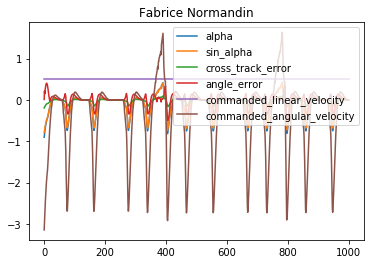

In [39]:

print("Your score: {}".format(total_reward))
view_results_ipython(local_env)

In [ ]:
controller.plot()

For this portion of the exercise, submit one plot with **cross-track error**, **angle error**, **commanded linear velocity** and **commanded angular velocity** vs. time. Lastly, experiment with the `lookup_distance` hyperparameter; does the lowering / raising this value match your hypothesis from earlier in this exercise?

Please submit the plot, `controller.py`, and `control.txt` inside of the zip file, and upload it to the Software submission link posted on Piazza.